In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
%config InlineBackend.figure_format='retina'

In [2]:
import numpy as np
import pandas as pd
import time
import itertools
from datetime import datetime
from pymongo import MongoClient

from src.config_tickets import ticket_lst
from src.scraping import WebScraping
from src.settings import HOST
from src.query_data import QueryData
from src.utilities import run_model_with_parameters, run_model_without_parameters

import sys

if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

Using TensorFlow backend.


In [3]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
import statsmodels.tsa.api as smt
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.stattools import adfuller
from sklearn.metrics import mean_squared_error, mean_absolute_error

from Models.Lstm_geo_hybrid import GBM


# Display and Plotting
import matplotlib.pylab as plt
import seaborn as sns

from ipywidgets import interactive, widgets, RadioButtons, ToggleButton, Select, FloatSlider, FloatRangeSlider, IntSlider, fixed

pd.set_option('display.float_format', lambda x: '%.5f' % x) # pandas
np.set_printoptions(precision=5, suppress=True) # numpy

pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 100)

# seaborn plotting style
sns.set(style='ticks', context='poster')

In [4]:
def connect_2_dbServer():
    mongoClient = MongoClient(HOST)
    return mongoClient
client = connect_2_dbServer()
query = QueryData(client)

In [5]:
def gen_order(p, d, q):
    return list(itertools.product(p, d, q))

def gen_ann(lags, hl):
    hl1 = hl
    hl2 = [int(i / 2) for i in hl]
    return list(itertools.product(lags, hl1, hl2))

def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


def root_mean_squared_error(y_true, y_pred):
    return np.sqrt(np.mean((y_true - y_pred) ** 2))

def evaluation(validation):
    mse = mean_squared_error(validation['y'], validation['yhat'])
    rmse = root_mean_squared_error(validation['y'], validation['yhat'])
    mae = mean_absolute_error(validation['y'], validation['yhat'])
    mape = mean_absolute_percentage_error(validation['y'], validation['yhat'])
    result = {
        'mse': mse,
        'rmse': rmse,
        'mae': mae,
        'mape': mape,
    }
    return result

In [6]:
start = datetime(2015,1,1)
end = datetime(2019,5,24)

lst_ticket = query.get_list_ticket(index='VN 30 (VNI30)')
print(len(lst_ticket))
df = query.get_historical_data(lst_ticket, start=start, end=end)
lst_company = []
for ticket in lst_ticket:
    df_ticket = df[df.name == ticket]
    symbol = df_ticket['ticket'].drop_duplicates().values[0]
    name = df_ticket['name'].drop_duplicates().values[0]
    lst_company.append({'symbol': symbol, 'name': name})
df_company = pd.DataFrame(lst_company)
df_company = df_company.set_index('name')
df_company

30


,symbol
name,
Cotec Construction JSC,CTD
DHG Pharmaceutical JSC,DHG
Faros Construction Corp,ROS
FPT Corp,FPT
Gemadept Corp,GMD
Ho Chi Minh City Infrastructure Investment JSC,CII
Ho Chi Minh City Development Joint Stock Commercial Bank,HDB
Hoa Phat Group JSC,HPG
Masan Group Corp,MSN


In [7]:
df_mae = pd.read_csv('mae.csv')
df_mse = pd.read_csv('mse.csv')
df_mape = pd.read_csv('mape.csv')
df_rmse = pd.read_csv('rmse.csv')
df_mae

,name,hybrid_order,hybrid_lags,hybrid_hl,hybrid,arima_order,arima,ann_lags,ann_hl,ann,lstm_gbm,gbm
0,Cotec Construction JSC ...,"(1, 0, 0)",2,"(5, 2)",1539.87592,"(1, 0, 0)",1566.10771,1,"(7, 3)",2189.91708,1993.15358,2083.47789
1,DHG Pharmaceutical JSC ...,"(1, 0, 0)",1,"(4, 2)",828.83069,"(1, 0, 0)",842.90478,1,"(6, 3)",826.61465,1247.94095,1131.67465
2,Faros Construction Corp ...,"(1, 0, 0)",2,"(3, 2)",554.81158,"(1, 0, 0)",487.39248,1,"(4, 3)",495.38750,548.41992,566.43586
3,FPT Corp ...,"(2, 1, 3)",1,"(5, 1)",372.12604,"(2, 1, 3)",374.88086,2,"(7, 3)",491.98339,495.30598,509.06203
4,Gemadept Corp ...,"(3, 0, 1)",1,"(4, 3)",257.47524,"(3, 0, 1)",213.70672,2,"(5, 1)",235.37330,255.01121,264.59097
5,Ho Chi Minh City Infrastructure Investment JSC...,"(3, 1, 1)",2,"(6, 1)",272.13356,"(3, 1, 1)",264.89355,2,"(7, 3)",238.76999,298.99088,378.03052
6,Ho Chi Minh City Development Joint Stock Comme...,"(3, 0, 3)",1,"(6, 1)",336.94210,"(3, 0, 3)",323.15049,1,"(6, 3)",318.13141,399.57171,448.07781
7,Hoa Phat Group JSC ...,"(2, 0, 3)",1,"(7, 1)",313.74105,"(2, 0, 3)",306.05785,2,"(5, 1)",336.75635,446.04473,369.64341
8,Masan Group Corp ...,"(1, 1, 0)",2,"(6, 1)",939.04766,"(1, 1, 0)",799.79158,1,"(6, 3)",797.28407,955.48928,1103.74238
9,Military Commercial Joint Stock Bank ...,"(1, 0, 0)",3,"(7, 1)",176.12078,"(1, 0, 0)",171.18171,1,"(7, 3)",180.78613,270.60099,225.45073


In [8]:
# lst_model = ['name', 'hybrid', 'arima', 'ann', 'lstm_gbm', 'gbm']
# df_short_mape = df_mape[lst_model].round(3)
# df_short_mse = df_mse[lst_model].round(3)
# df_short_mae = df_mae[lst_model].round(3)
# df_short_rmse = df_rmse[lst_model].round(3)

# df_short_rmse = df_short_rmse.set_index('name')
# df_short_mse = df_short_mse.set_index('name')
# df_short_mae = df_short_mae.set_index('name')
# df_short_mape = df_short_mape.set_index('name')

# df_short_mape['symbol'] = df_company['symbol']
# df_short_mse['symbol'] = df_company['symbol']
# df_short_mae['symbol'] = df_company['symbol']
# df_short_rmse['symbol'] = df_company['symbol']

# df_short_rmse = df_short_rmse.reset_index()
# df_short_mse = df_short_mse.reset_index()
# df_short_mae = df_short_mae.reset_index()
# df_short_mape = df_short_mape.reset_index()

# df_short_rmse = df_short_rmse.drop('name', axis=1)
# df_short_mse = df_short_mse.drop('name', axis=1)
# df_short_mae = df_short_mae.drop('name', axis=1)
# df_short_mape = df_short_mape.drop('name', axis=1)
                                          
# df_short_rmse = df_short_rmse.set_index('symbol')
# df_short_mse = df_short_mse.set_index('symbol')
# df_short_mae = df_short_mae.set_index('symbol')
# df_short_mape = df_short_mape.set_index('symbol')

In [9]:
# df_short_mape.to_csv('short_mape.csv', index=True)
# df_short_mse.to_csv('short_mse.csv', index=True)
# df_short_mae.to_csv('short_mae.csv', index=True)
# df_short_rmse.to_csv('short_rmse.csv', index=True)

In [10]:
start_train = 0.8
end_train = 0.95

In [11]:
def plot_acf_pacf(time_series, name):    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
    fig = sm.graphics.tsa.plot_acf(time_series, lags=30, ax=ax)
    ax.xaxis.set_ticks_position('bottom')
    plt.title(name)
    fig.tight_layout();
    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
    fig = sm.graphics.tsa.plot_pacf(time_series, lags=30, ax=ax)
    ax.xaxis.set_ticks_position('bottom')
    plt.title(name)
    fig.tight_layout();

In [12]:
# split data
# for ticket in df_company.symbol:
#     series = df[df.ticket == ticket]['close']

#     series_log_diff = np.log(series).diff()[1:]
#     name = df[df.ticket == ticket].name[0]
#     print(name)

#     series = series.sort_index()
#     size = len(series)
#     train_start = int(start_train * size)
#     train_end = int(end_train * size)
#     train, test = series[train_start:train_end], series[train_end:]

#     plot_acf_pacf(train, name)
    
#     result = adfuller(train.values)
#     print('adf: %f' % result[0])
#     print('p-value: %f' % result[1])
#     print('usedlag: %f' % result[2])
#     print('nobs: %f' % result[3])
#     print('critical values: \n',result[4])

#     # split data
#     series_log_diff = series_log_diff.sort_index()
#     size = len(series_log_diff)
#     train_start = int(start_train * size)
#     train_end = int(end_train * size)
#     train_log_diff, test_log_diff = series_log_diff[train_start:train_end], series_log_diff[train_end:]

#     plot_acf_pacf(train_log_diff, name)
    
#     result = adfuller(train_log_diff.values)
#     print('adf: %f' % result[0])
#     print('p-value: %f' % result[1])
#     print('usedlag: %f' % result[2])
#     print('nobs: %f' % result[3])
#     print('critical values: \n',result[4])

In [13]:
def _plot_acf_pacf(time_series):    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 6))
    fig = sm.graphics.tsa.plot_acf(time_series, lags=30, ax=ax)
    ax.xaxis.set_ticks_position('bottom')
    plt.ylabel('Score')
    plt.xlabel('Lags (days)')
    fig.tight_layout();
    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 6))
    fig = sm.graphics.tsa.plot_pacf(time_series, lags=30, ax=ax)
    ax.xaxis.set_ticks_position('bottom')
    plt.ylabel('Score')
    plt.xlabel('Lags (days)')
    fig.tight_layout();

PetroVietnam Fertilizer and Chemicals Corp
adf: -1.622830
p-value: 0.471246
usedlag: 0.000000
nobs: 163.000000
critical values: 
 {'1%': -3.471118535474365, '5%': -2.8794405060097024, '10%': -2.576313761526591}
adf: -14.008185
p-value: 0.000000
usedlag: 0.000000
nobs: 162.000000
critical values: 
 {'1%': -3.471374345647024, '5%': -2.8795521079291966, '10%': -2.5763733302850174}


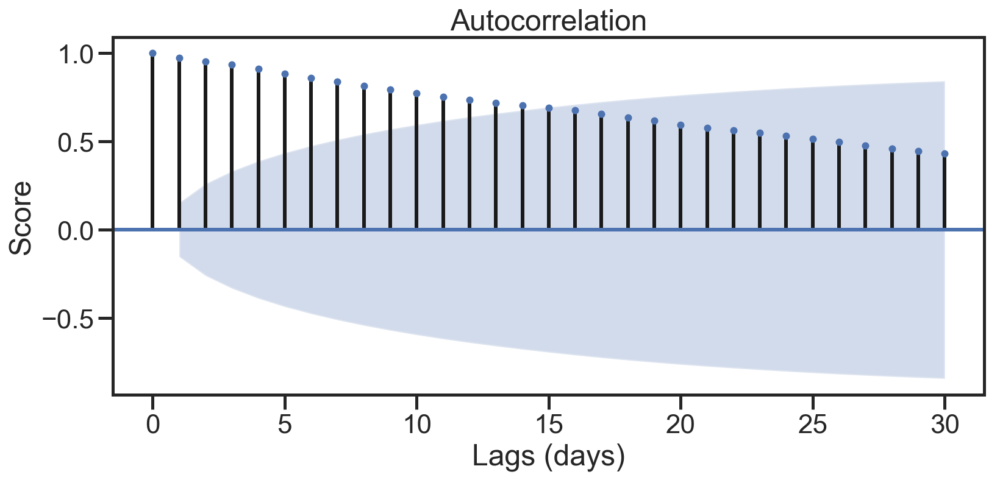

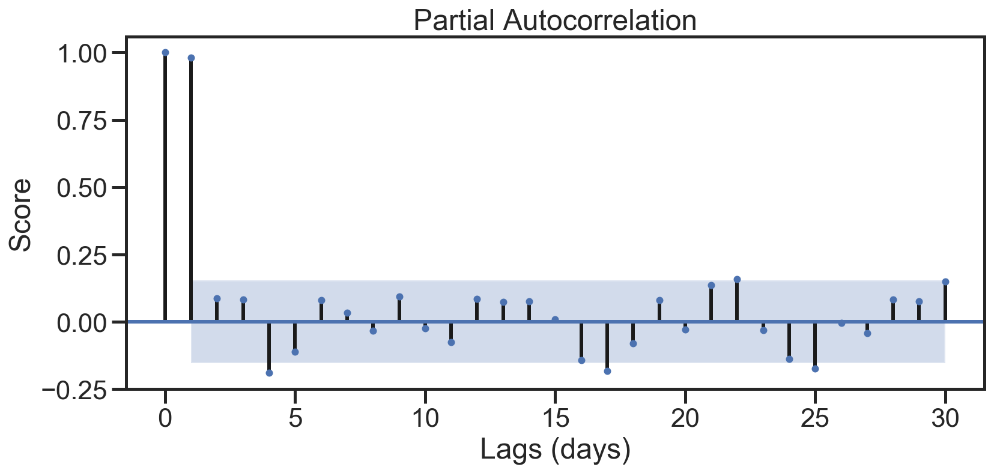

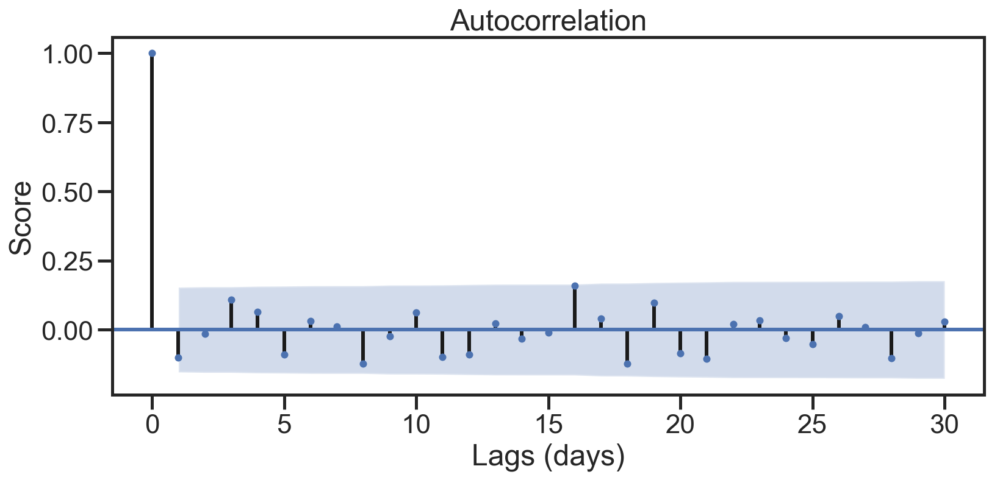

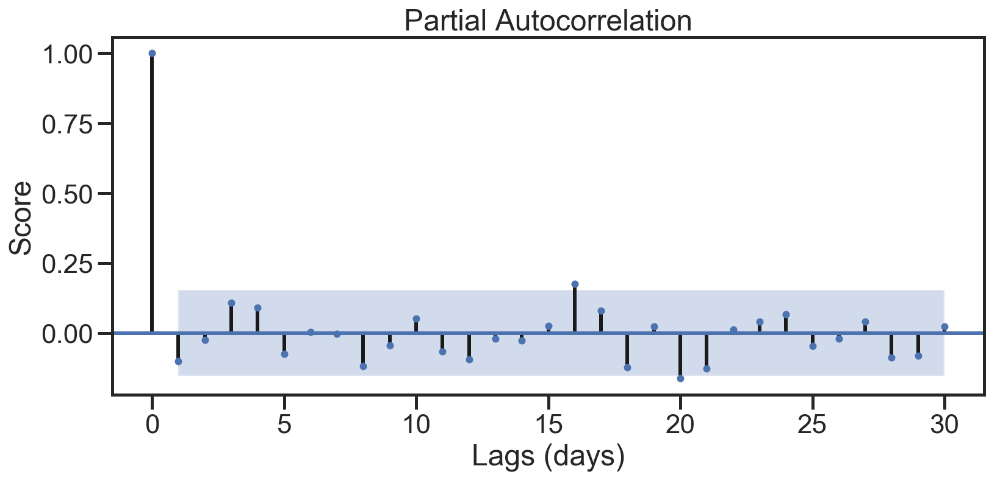

In [14]:
ticket = 'DPM'

series = df[df.ticket == ticket]['close']

series_log_diff = np.log(series).diff()[1:]
name = df[df.ticket == ticket].name[0]
print(name)

series = series.sort_index()
size = len(series)
train_start = int(start_train * size)
train_end = int(end_train * size)
train, test = series[train_start:train_end], series[train_end:]

_plot_acf_pacf(train)

result = adfuller(train.values)
print('adf: %f' % result[0])
print('p-value: %f' % result[1])
print('usedlag: %f' % result[2])
print('nobs: %f' % result[3])
print('critical values: \n',result[4])

# split data
series_log_diff = series_log_diff.sort_index()
size = len(series_log_diff)
train_start = int(start_train * size)
train_end = int(end_train * size)
train_log_diff, test_log_diff = series_log_diff[train_start:train_end], series_log_diff[train_end:]

_plot_acf_pacf(train_log_diff)

result = adfuller(train_log_diff.values)
print('adf: %f' % result[0])
print('p-value: %f' % result[1])
print('usedlag: %f' % result[2])
print('nobs: %f' % result[3])
print('critical values: \n',result[4])

(0, 1, 0)
Testing result: {'mse': 89909.09090909091, 'rmse': 299.8484465677468, 'mae': 227.27272727272728, 'mape': 1.2158120316884142, 'order': (0, 1, 0)}


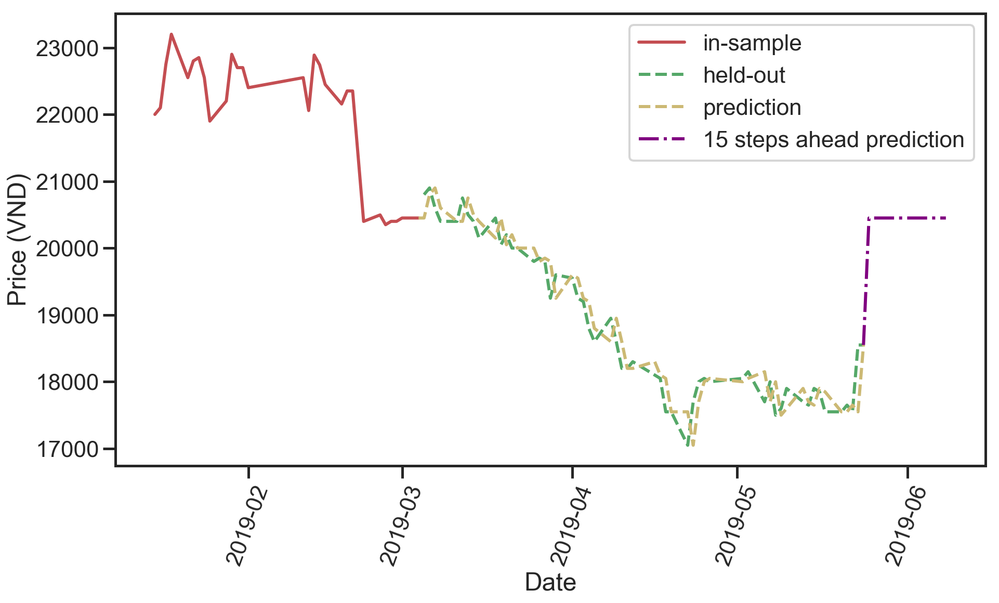

(16, 1, 0)
Testing result: {'mse': 87572.40485478562, 'rmse': 295.9263503893927, 'mae': 224.74888506321605, 'mape': 1.2055274463351728, 'order': (16, 1, 0)}


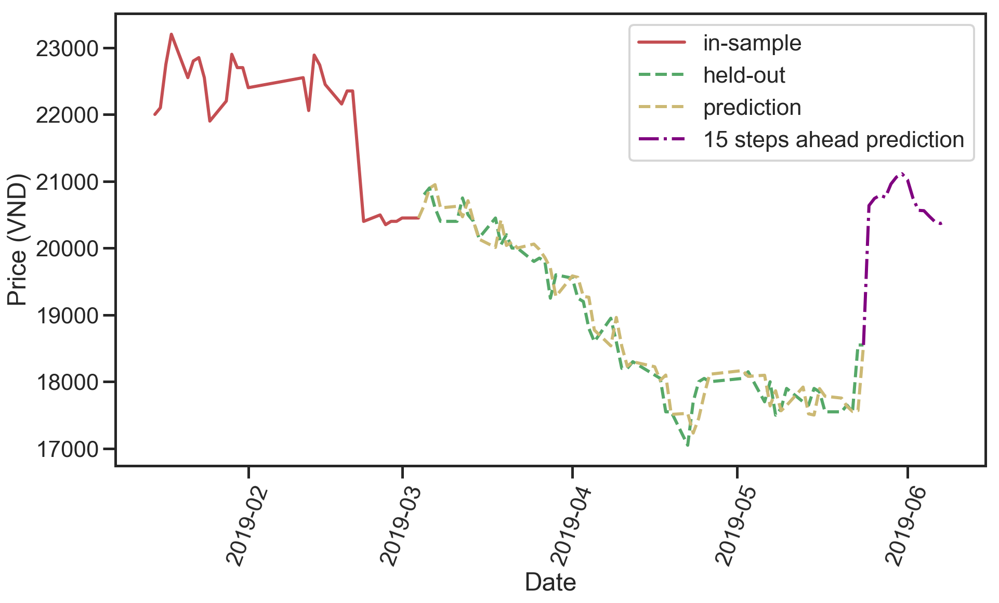

(20, 1, 0)
Testing result: {'mse': 90135.75278854124, 'rmse': 300.2261693932447, 'mae': 237.2767023413692, 'mape': 1.270197484534208, 'order': (20, 1, 0)}


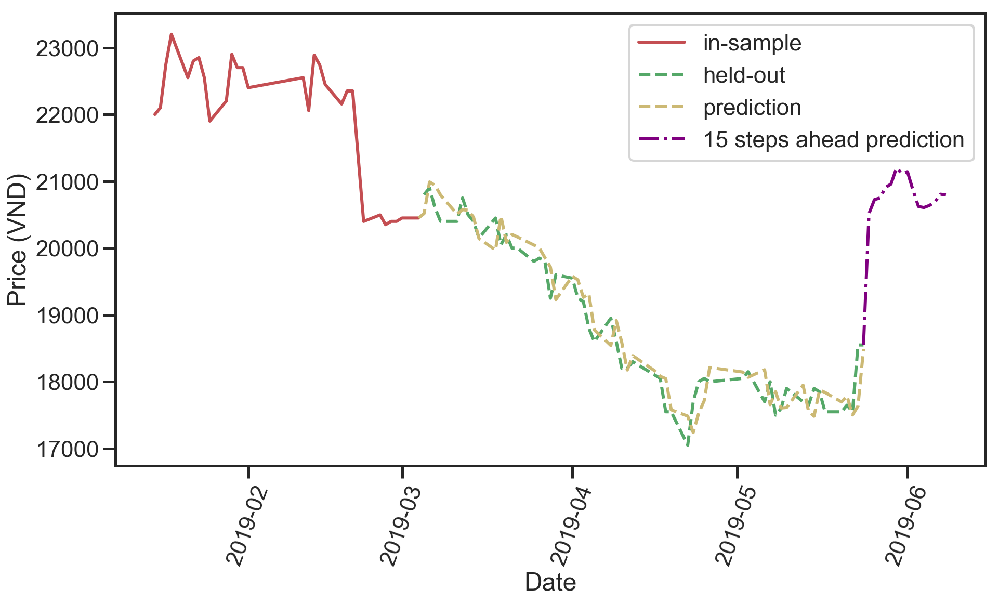

In [36]:
p = [0,16,20]
d = [1]
q = [0]
lst_order = gen_order(p,d,q)
lst_result = []
for order in lst_order:
    print(order)
    result = run_model_with_parameters(train, test, model_selection='ARIMA', order=order)
    time.sleep(1)
    if result['status']:
        _result = result['test_evaluation']
        _result['order'] = order
        lst_result.append(_result)
        print('Testing result:', result['test_evaluation'])
        validation = result['model'].validate(test)
        predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
        fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
        ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
        ax1.plot(test, label='held-out', color='g', linestyle='--')
        ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
        ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
        plt.xticks(rotation=70)
        plt.ylabel('Price (VND)')
        plt.xlabel('Date')
        plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
#         plt.title('Model evaluation of ' + ticket)
        plt.show()
    else:
        print('None')

In [37]:
df_result = pd.DataFrame(data=lst_result)
df_result = df_result.set_index('order')
lst_metric = ['mae','mape','mse','rmse']
df_result = df_result[lst_metric].round(3)
df_result.to_csv('pnj_arima_result.csv', index=True)
df_result

,mae,mape,mse,rmse
order,,,,
"(0, 1, 0)",227.27300,1.21600,89909.09100,299.84800
"(16, 1, 0)",224.74900,1.20600,87572.40500,295.92600
"(20, 1, 0)",237.27700,1.27000,90135.75300,300.22600


## ANN

DPM
(1, 3, 1)
Testing result: {'mse': 1365208.3398923462, 'rmse': 1168.421302395821, 'mae': 1072.4475418980928, 'mape': 5.756970659097583, 'lags': 1, 'hidden layers': (3, 1)}


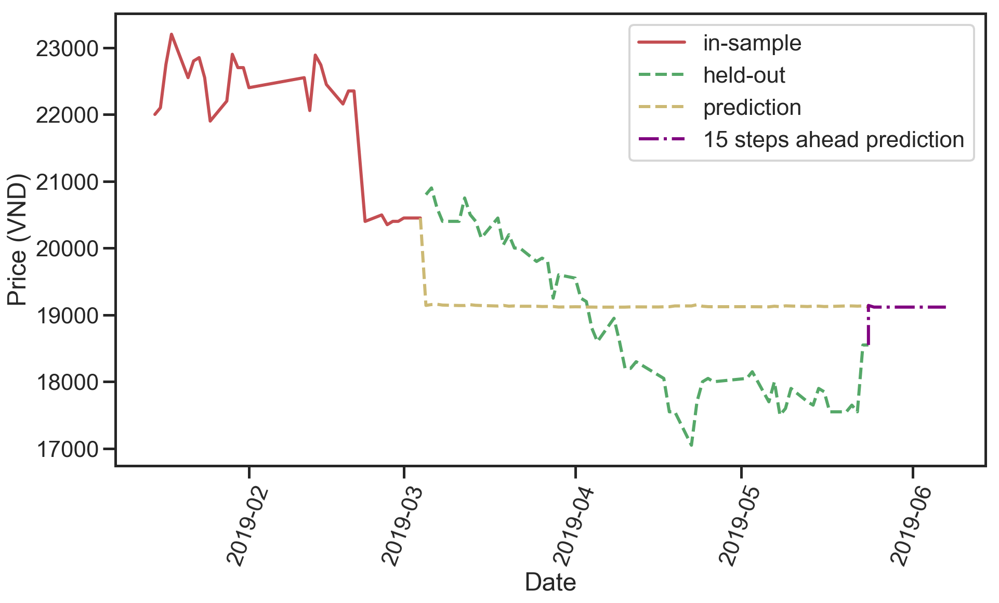

(1, 3, 2)
Testing result: {'mse': 674963.8029215356, 'rmse': 821.5618071219812, 'mae': 733.3617425510074, 'mape': 3.8777071963765777, 'lags': 1, 'hidden layers': (3, 2)}


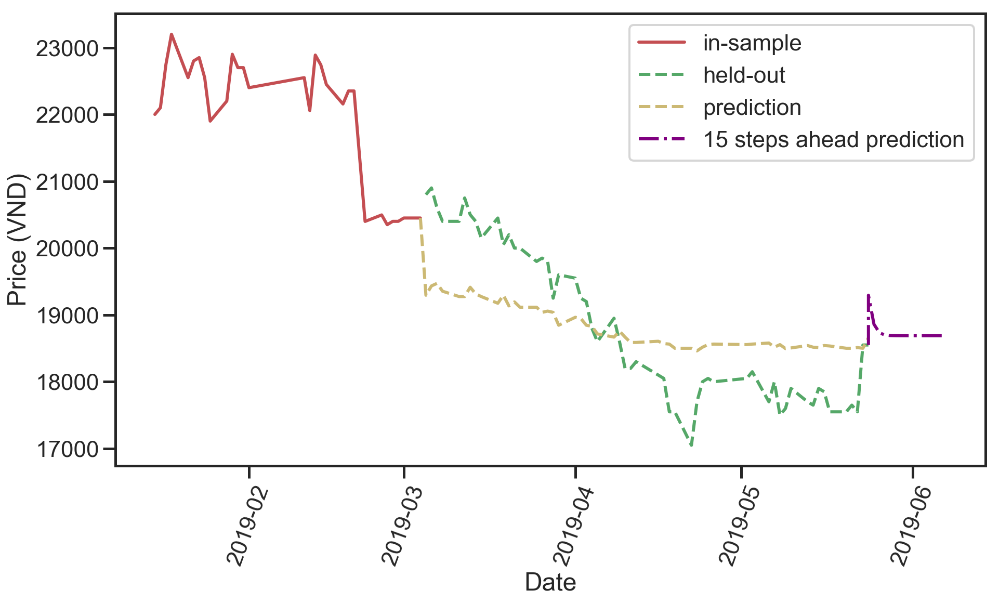

(1, 3, 2)
Testing result: {'mse': 674963.8029215356, 'rmse': 821.5618071219812, 'mae': 733.3617425510074, 'mape': 3.8777071963765777, 'lags': 1, 'hidden layers': (3, 2)}


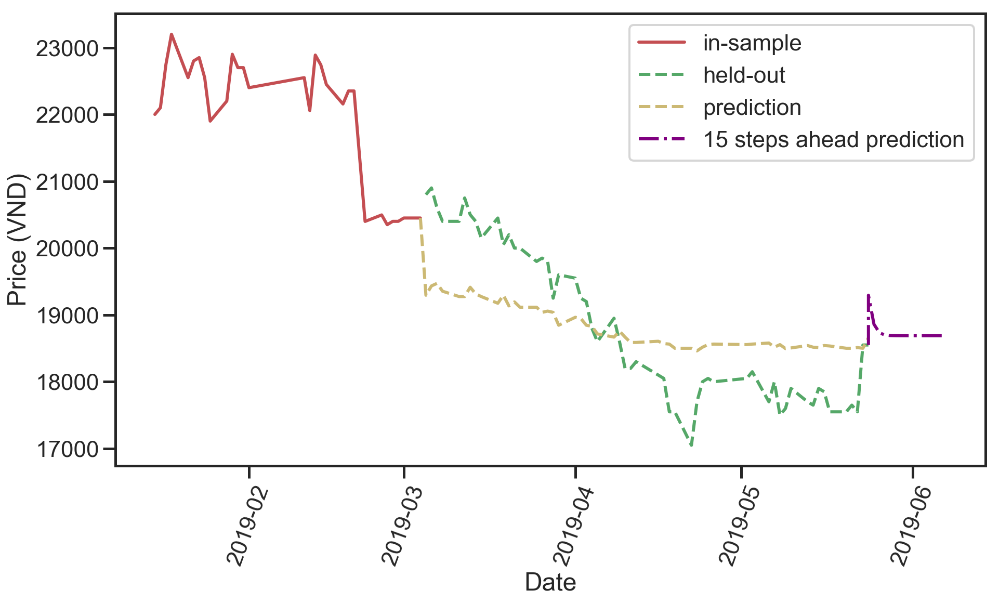

(1, 3, 3)
Testing result: {'mse': 282118.6235649284, 'rmse': 531.1484006988334, 'mae': 457.27740081503714, 'mape': 2.4867015212762027, 'lags': 1, 'hidden layers': (3, 3)}


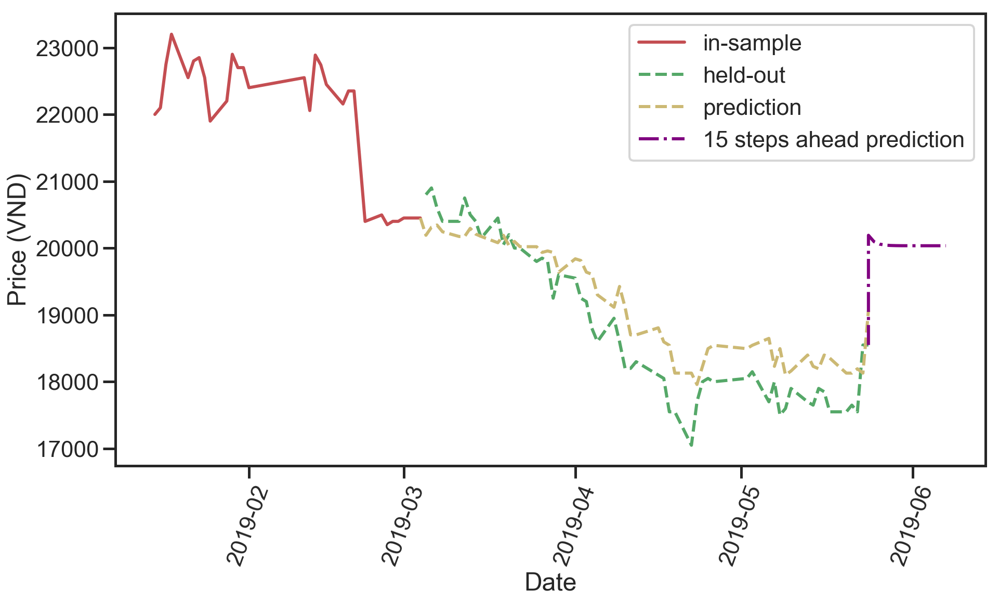

(1, 3, 3)
Testing result: {'mse': 282118.6235649284, 'rmse': 531.1484006988334, 'mae': 457.27740081503714, 'mape': 2.4867015212762027, 'lags': 1, 'hidden layers': (3, 3)}


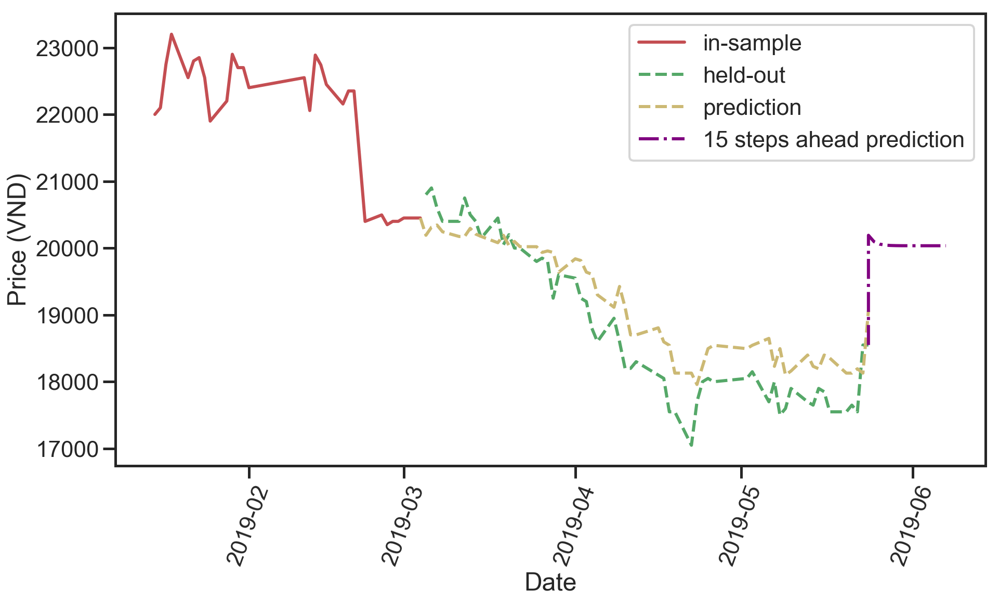

(1, 4, 1)
Testing result: {'mse': 6721493.055061818, 'rmse': 2592.5842426162003, 'mae': 2374.123777650742, 'mape': 12.335217224647215, 'lags': 1, 'hidden layers': (4, 1)}


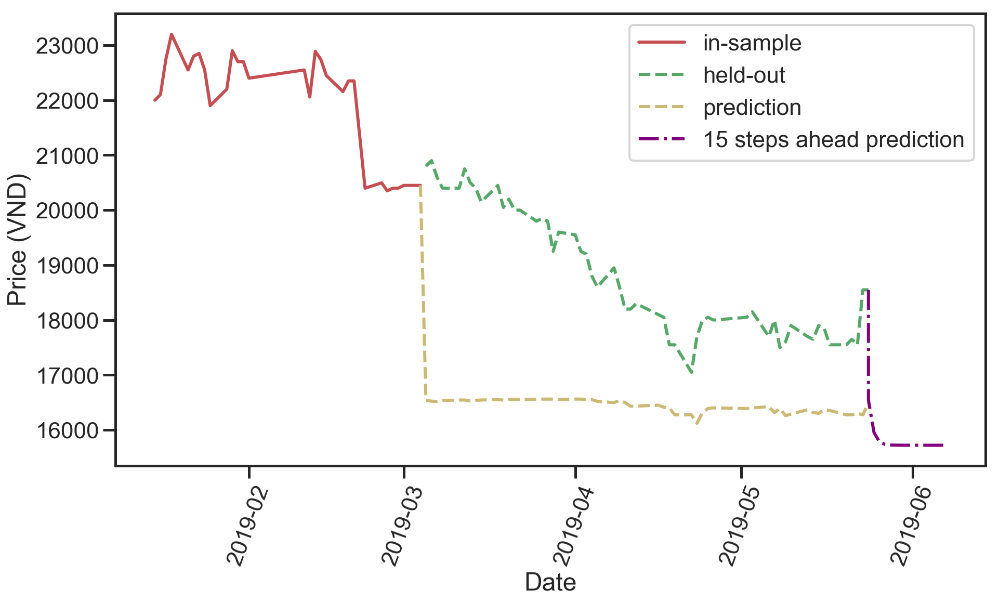

(1, 4, 2)
Testing result: {'mse': 441092.1593188508, 'rmse': 664.1476939046396, 'mae': 591.5294618951692, 'mape': 3.1452700295153644, 'lags': 1, 'hidden layers': (4, 2)}


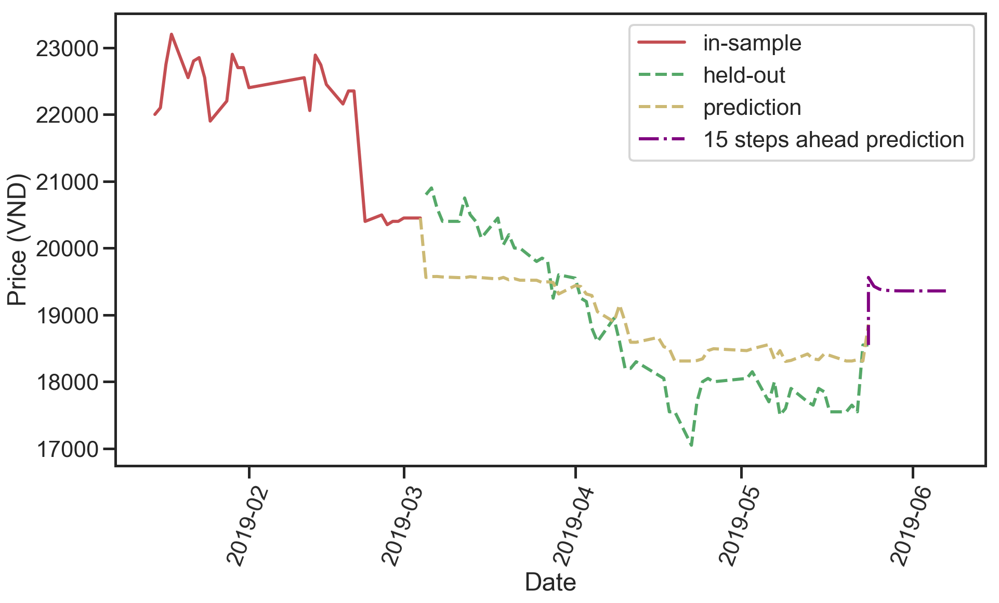

(1, 4, 2)
Testing result: {'mse': 441092.1593188508, 'rmse': 664.1476939046396, 'mae': 591.5294618951692, 'mape': 3.1452700295153644, 'lags': 1, 'hidden layers': (4, 2)}


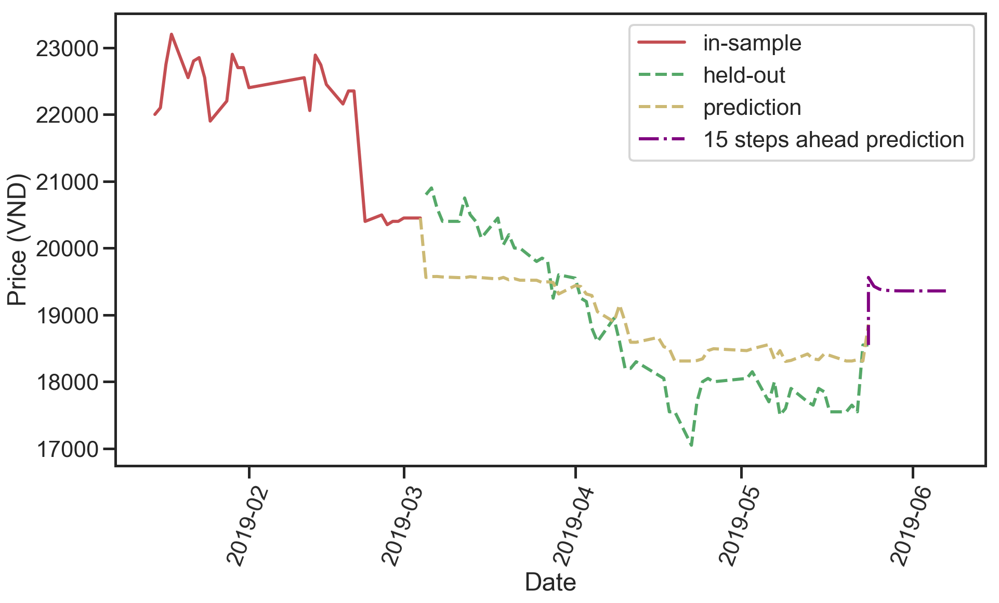

(1, 4, 3)
Testing result: {'mse': 112765.53788787544, 'rmse': 335.80580383292283, 'mae': 259.7128407861821, 'mape': 1.3845948710480145, 'lags': 1, 'hidden layers': (4, 3)}


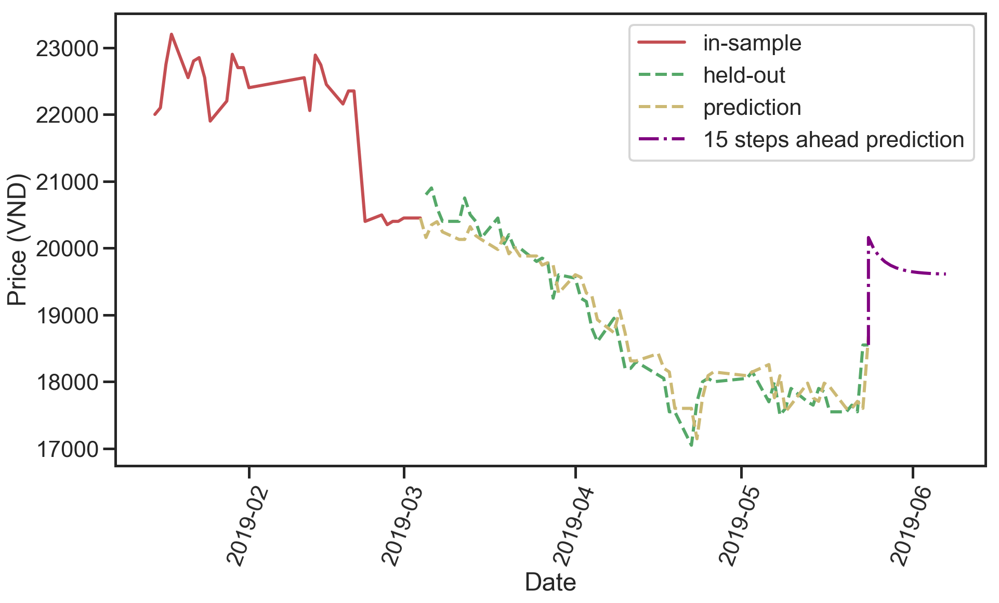

(1, 4, 3)
Testing result: {'mse': 112765.53788787544, 'rmse': 335.80580383292283, 'mae': 259.7128407861821, 'mape': 1.3845948710480145, 'lags': 1, 'hidden layers': (4, 3)}


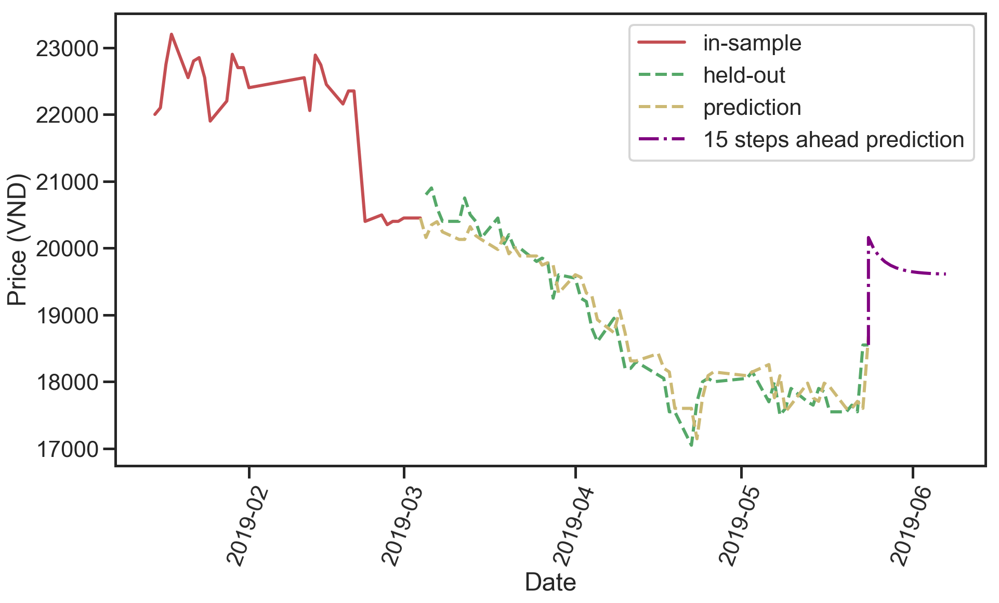

(1, 5, 1)
Testing result: {'mse': 1343022.5696182533, 'rmse': 1158.8885061205212, 'mae': 1052.861546686371, 'mape': 5.577734642588676, 'lags': 1, 'hidden layers': (5, 1)}


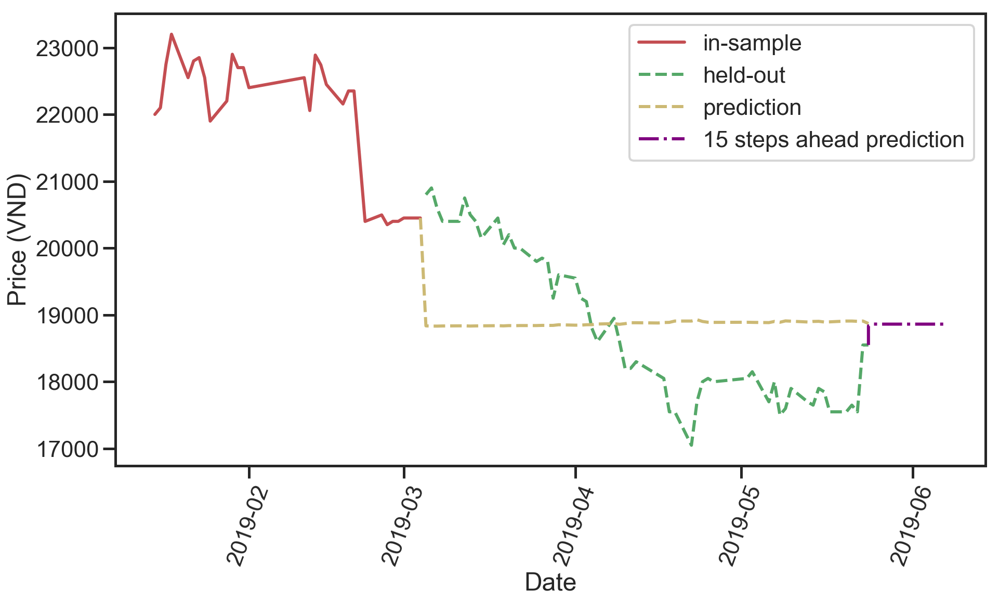

(1, 5, 2)
Testing result: {'mse': 521919.83040448645, 'rmse': 722.4401915760823, 'mae': 628.586863897689, 'mape': 3.41648930086981, 'lags': 1, 'hidden layers': (5, 2)}


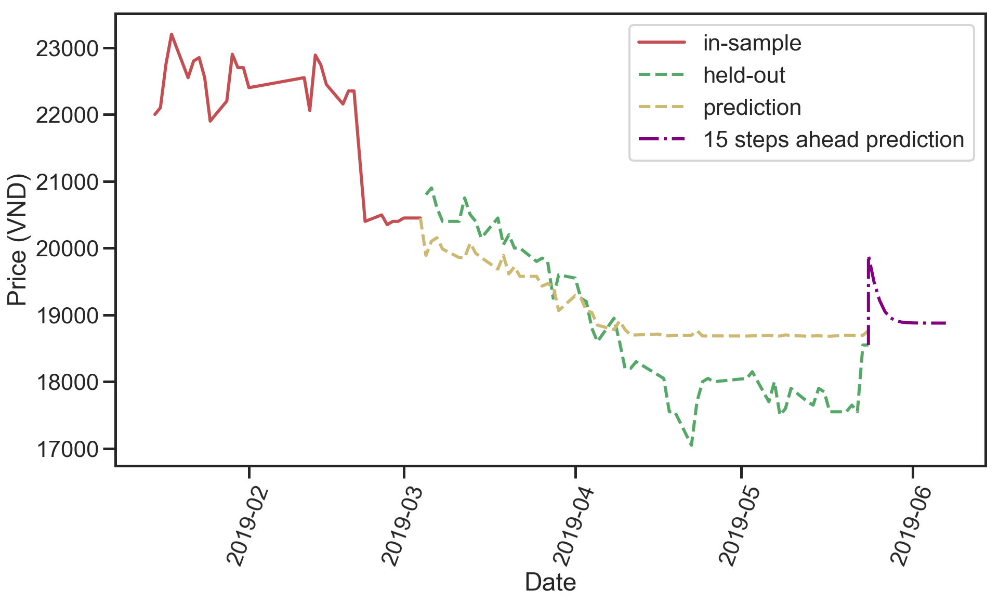

(1, 5, 2)
Testing result: {'mse': 521919.83040448645, 'rmse': 722.4401915760823, 'mae': 628.586863897689, 'mape': 3.41648930086981, 'lags': 1, 'hidden layers': (5, 2)}


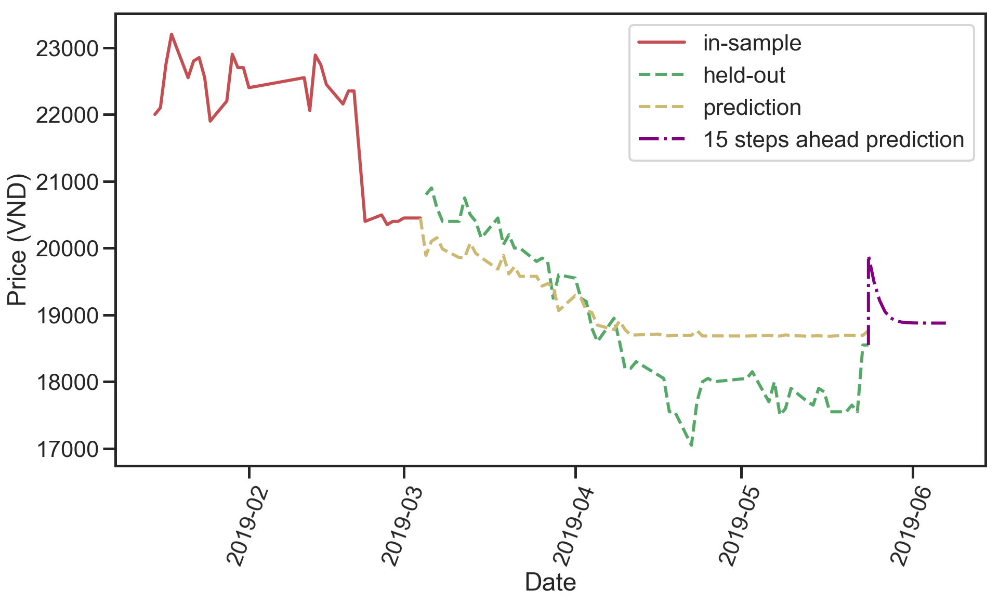

(1, 5, 3)
Testing result: {'mse': 738926.1201598841, 'rmse': 859.6081201104862, 'mae': 678.3944864800078, 'mape': 3.496097550753859, 'lags': 1, 'hidden layers': (5, 3)}


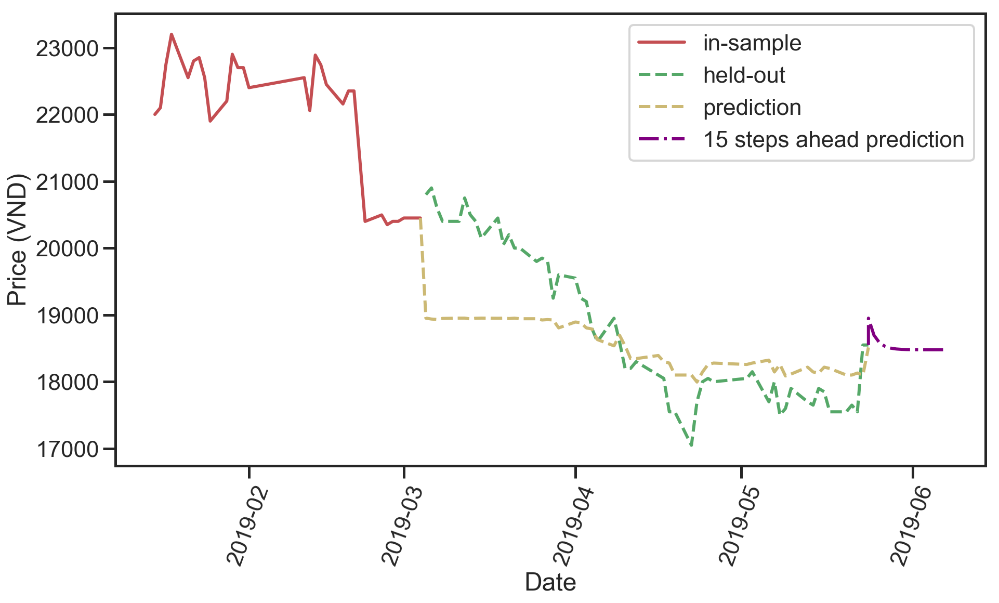

(1, 5, 3)
Testing result: {'mse': 738926.1201598841, 'rmse': 859.6081201104862, 'mae': 678.3944864800078, 'mape': 3.496097550753859, 'lags': 1, 'hidden layers': (5, 3)}


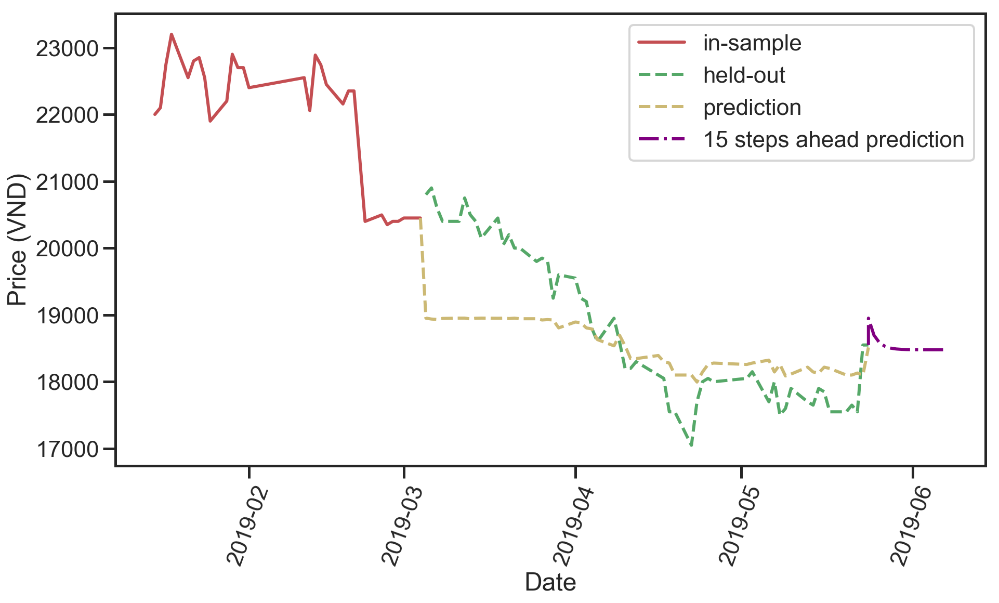

(1, 6, 1)
Testing result: {'mse': 2464171.4728282737, 'rmse': 1569.767967831002, 'mae': 1307.9298672311775, 'mape': 7.22915795229427, 'lags': 1, 'hidden layers': (6, 1)}


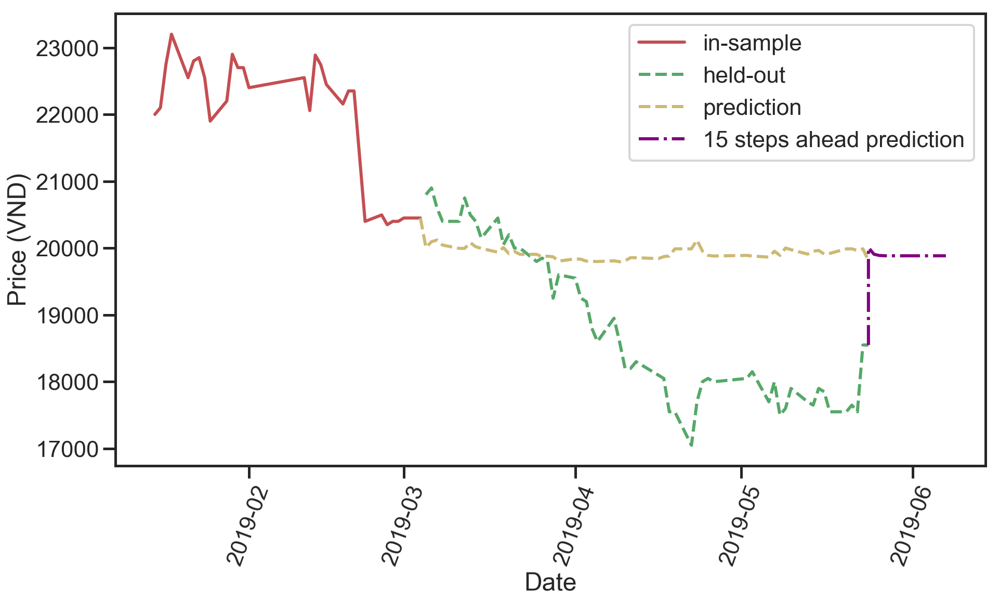

(1, 6, 2)
Testing result: {'mse': 695599.9966181159, 'rmse': 834.0263764522774, 'mae': 691.7567712807806, 'mape': 3.5654743408292076, 'lags': 1, 'hidden layers': (6, 2)}


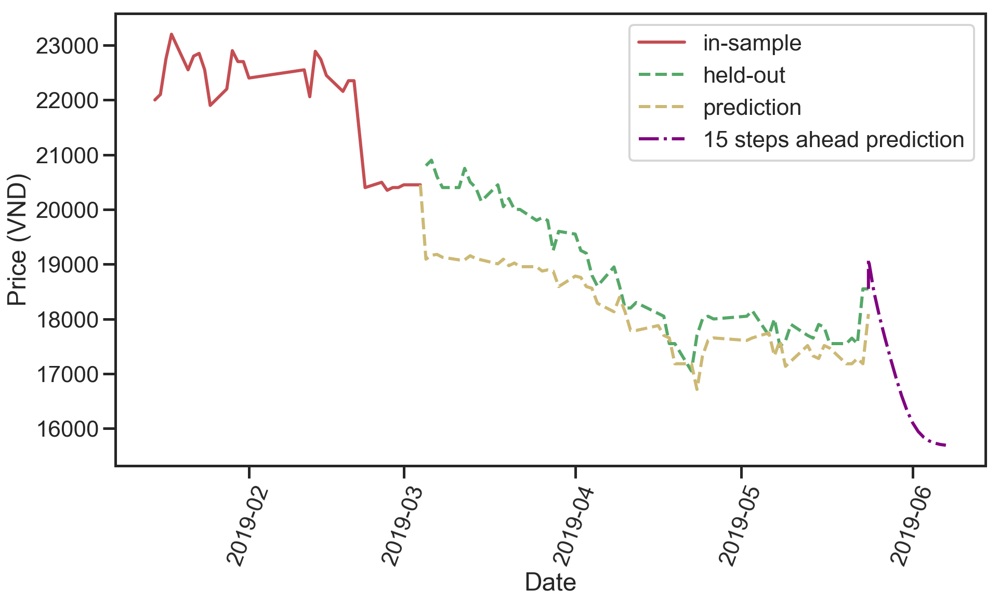

(1, 6, 2)
Testing result: {'mse': 695599.9966181159, 'rmse': 834.0263764522774, 'mae': 691.7567712807806, 'mape': 3.5654743408292076, 'lags': 1, 'hidden layers': (6, 2)}


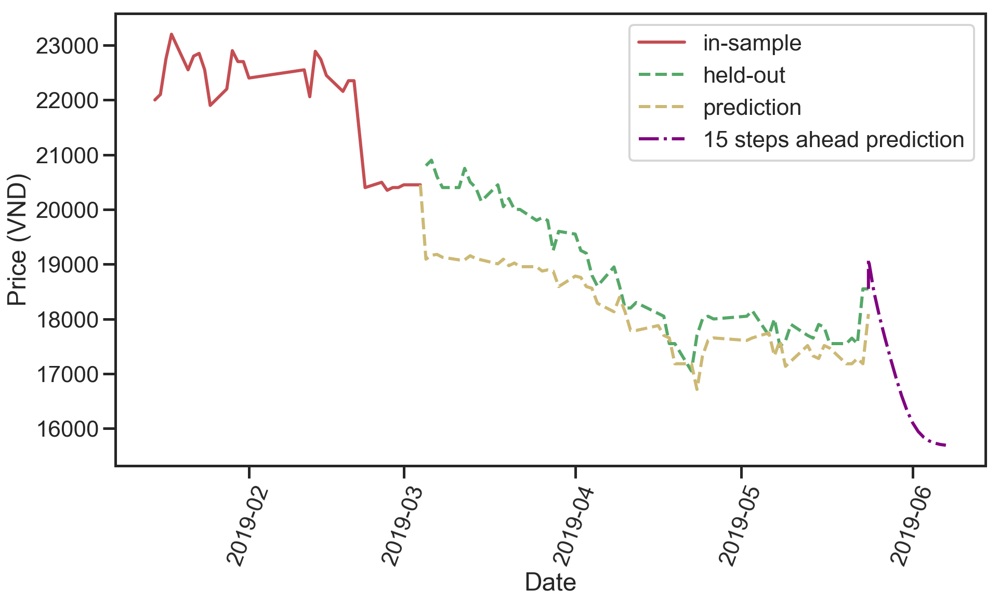

(1, 6, 3)
Testing result: {'mse': 76176.68681265239, 'rmse': 276.001244223015, 'mae': 211.8532867066795, 'mape': 1.1366458028338045, 'lags': 1, 'hidden layers': (6, 3)}


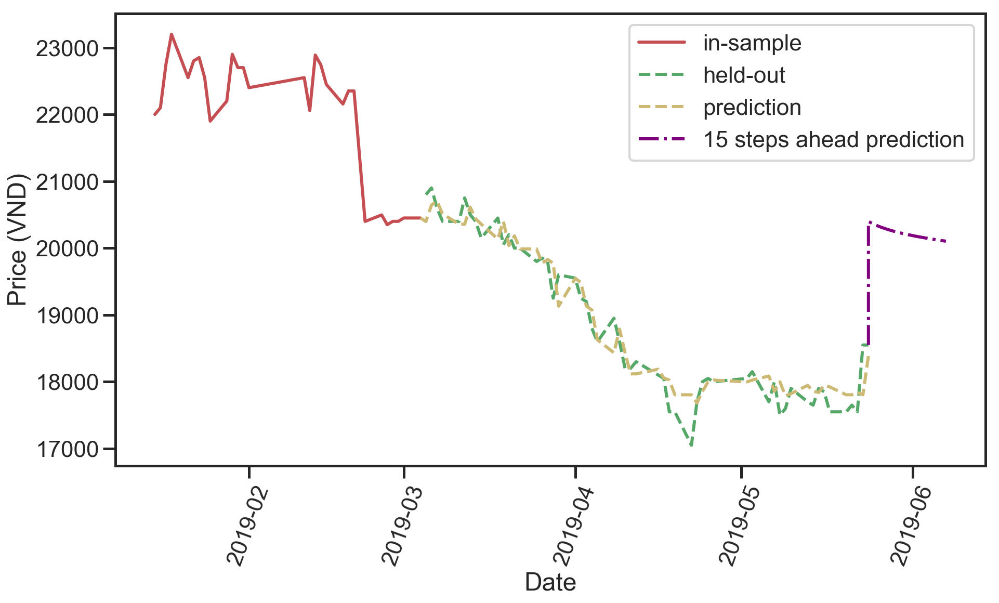

(1, 6, 3)
Testing result: {'mse': 76176.68681265239, 'rmse': 276.001244223015, 'mae': 211.8532867066795, 'mape': 1.1366458028338045, 'lags': 1, 'hidden layers': (6, 3)}


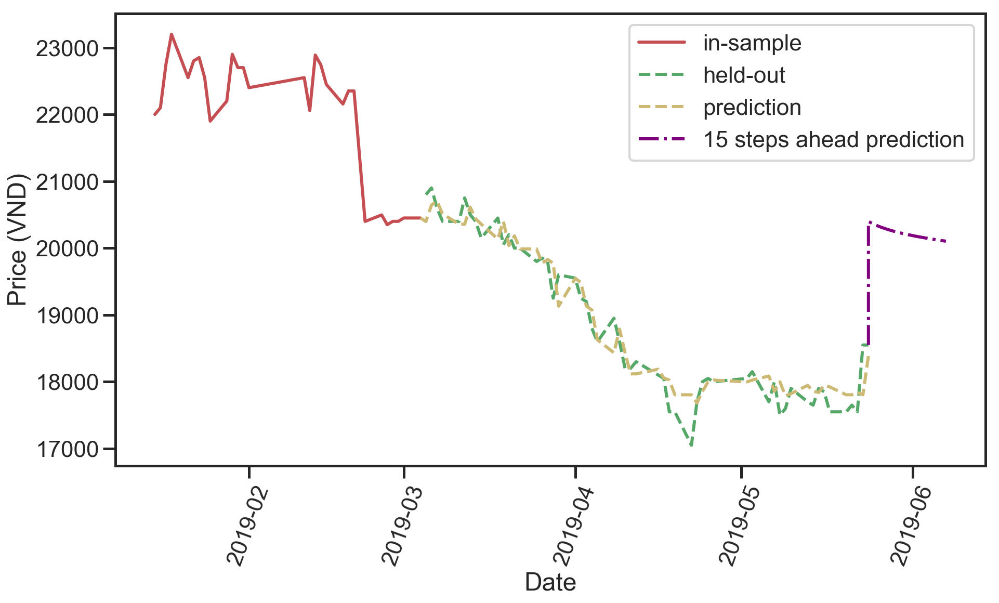

(1, 7, 1)
Testing result: {'mse': 1240238.5256392607, 'rmse': 1113.659968589722, 'mae': 995.8703554669728, 'mape': 5.246591856127125, 'lags': 1, 'hidden layers': (7, 1)}


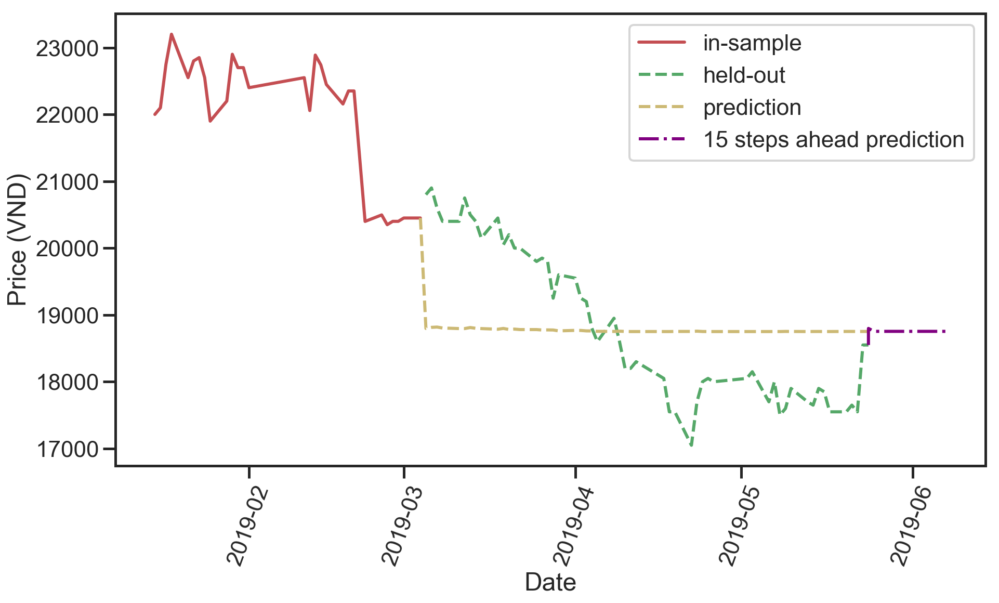

(1, 7, 2)
Testing result: {'mse': 3328135.2193623083, 'rmse': 1824.3177407903231, 'mae': 1781.4698408914626, 'mape': 9.606426924968511, 'lags': 1, 'hidden layers': (7, 2)}


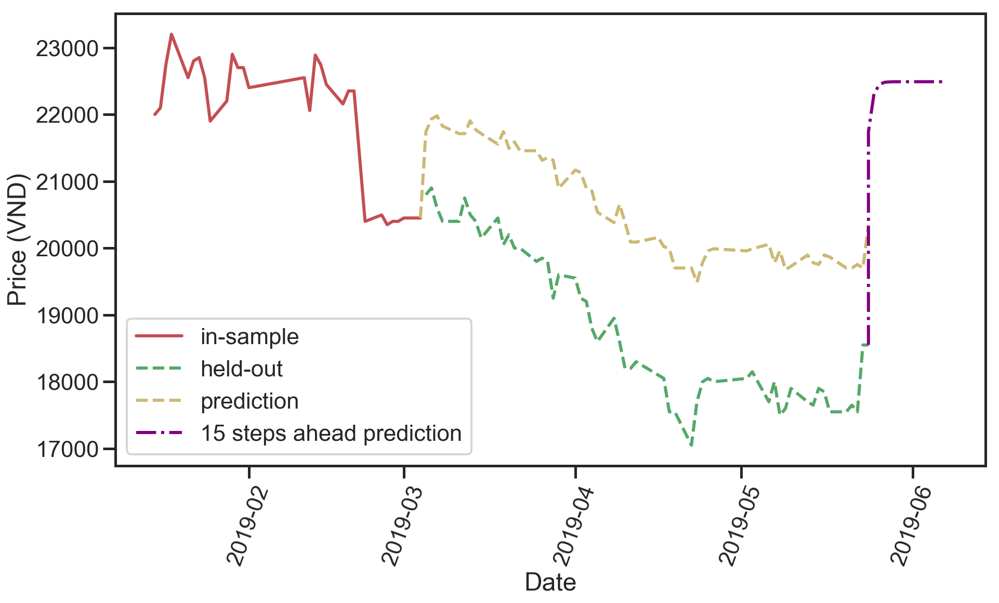

(1, 7, 2)
Testing result: {'mse': 3328135.2193623083, 'rmse': 1824.3177407903231, 'mae': 1781.4698408914626, 'mape': 9.606426924968511, 'lags': 1, 'hidden layers': (7, 2)}


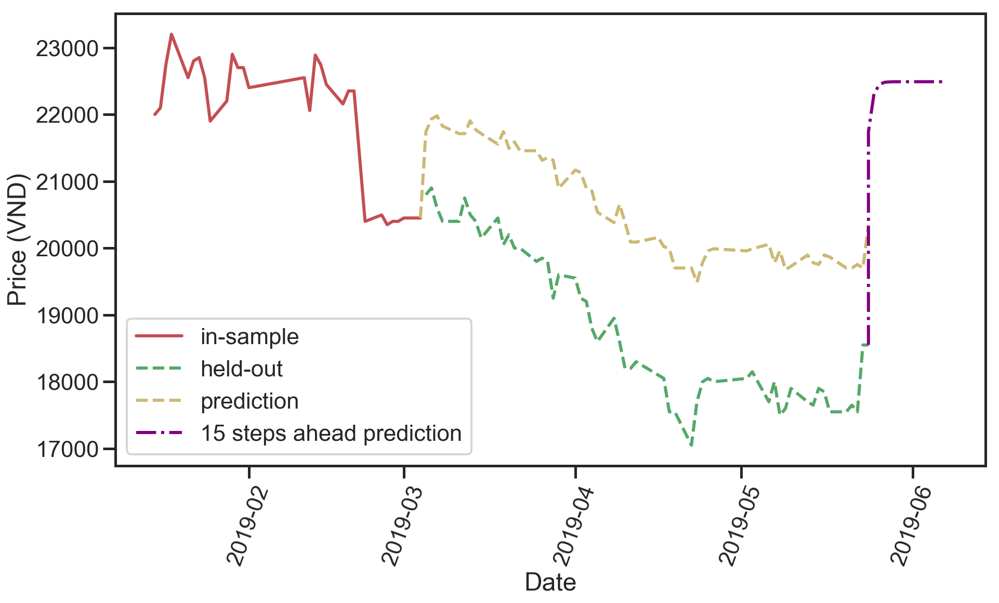

(1, 7, 3)
Testing result: {'mse': 94697.84317866169, 'rmse': 307.73014668482136, 'mae': 247.30800130318895, 'mape': 1.3163501325944338, 'lags': 1, 'hidden layers': (7, 3)}


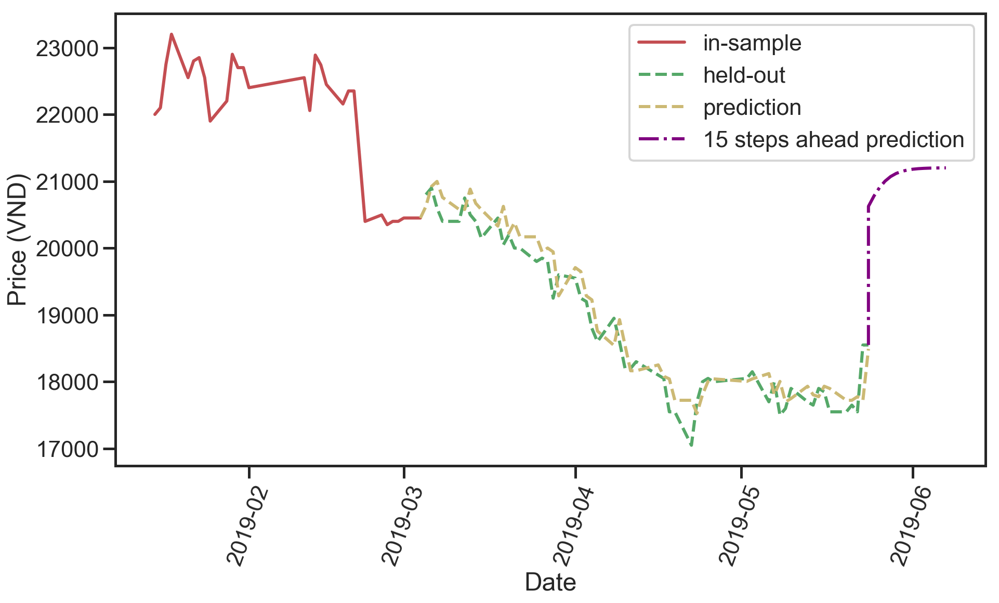

(1, 7, 3)
Testing result: {'mse': 94697.84317866169, 'rmse': 307.73014668482136, 'mae': 247.30800130318895, 'mape': 1.3163501325944338, 'lags': 1, 'hidden layers': (7, 3)}


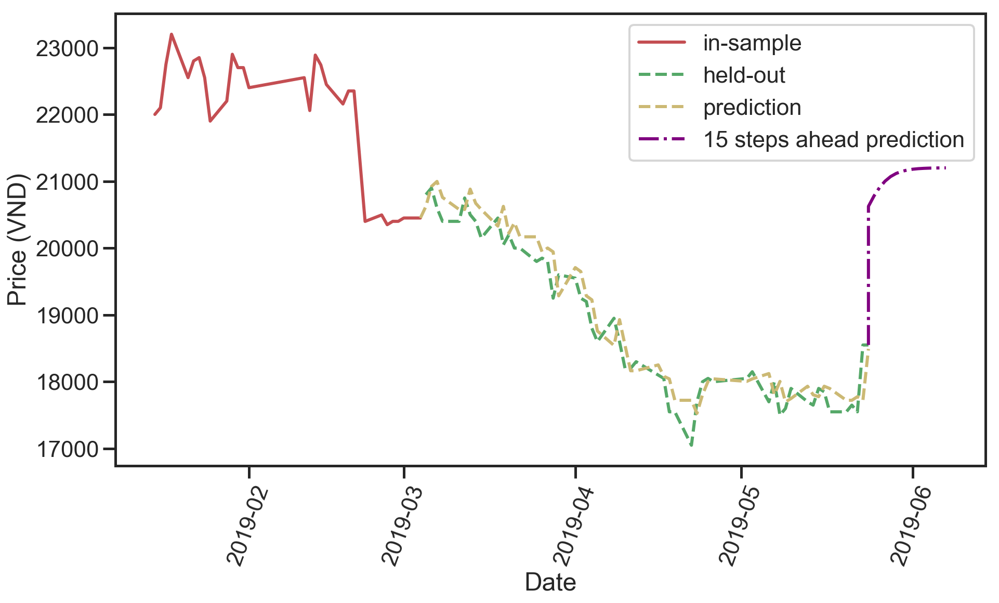

(2, 3, 1)
Testing result: {'mse': 12567157.571515625, 'rmse': 3545.018698330888, 'mae': 3083.61894693721, 'mape': 15.89853620981839, 'lags': 2, 'hidden layers': (3, 1)}


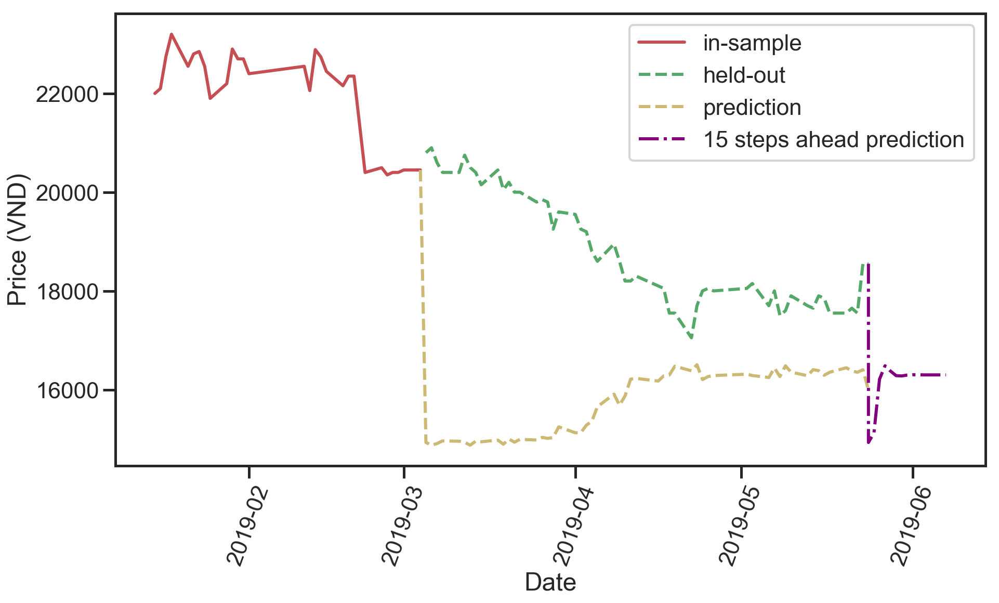

(2, 3, 2)
Testing result: {'mse': 3876472.227128596, 'rmse': 1968.875879056015, 'mae': 1655.6109935635782, 'mape': 8.557269745761712, 'lags': 2, 'hidden layers': (3, 2)}


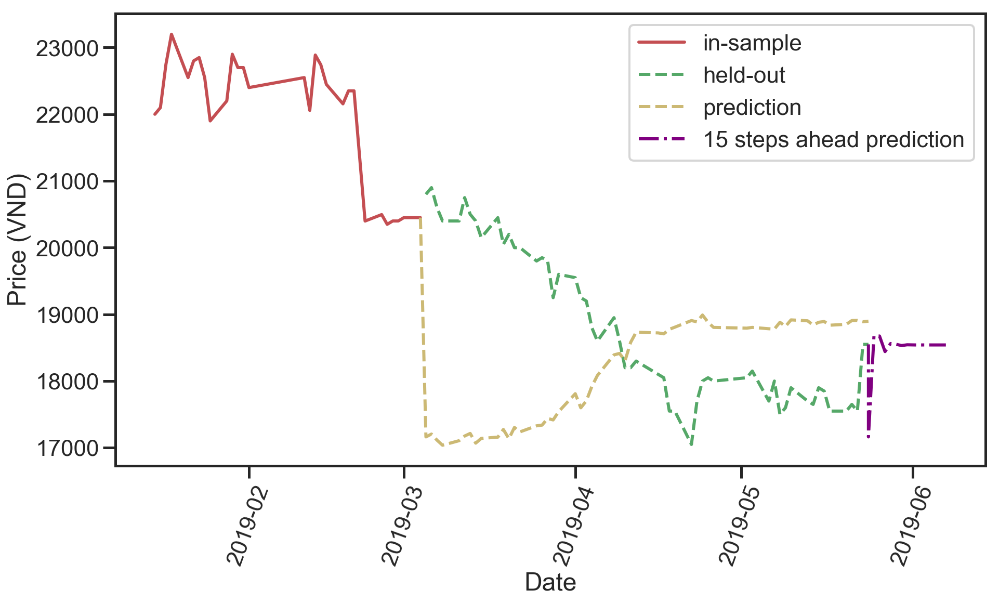

(2, 3, 2)
Testing result: {'mse': 3876472.227128596, 'rmse': 1968.875879056015, 'mae': 1655.6109935635782, 'mape': 8.557269745761712, 'lags': 2, 'hidden layers': (3, 2)}


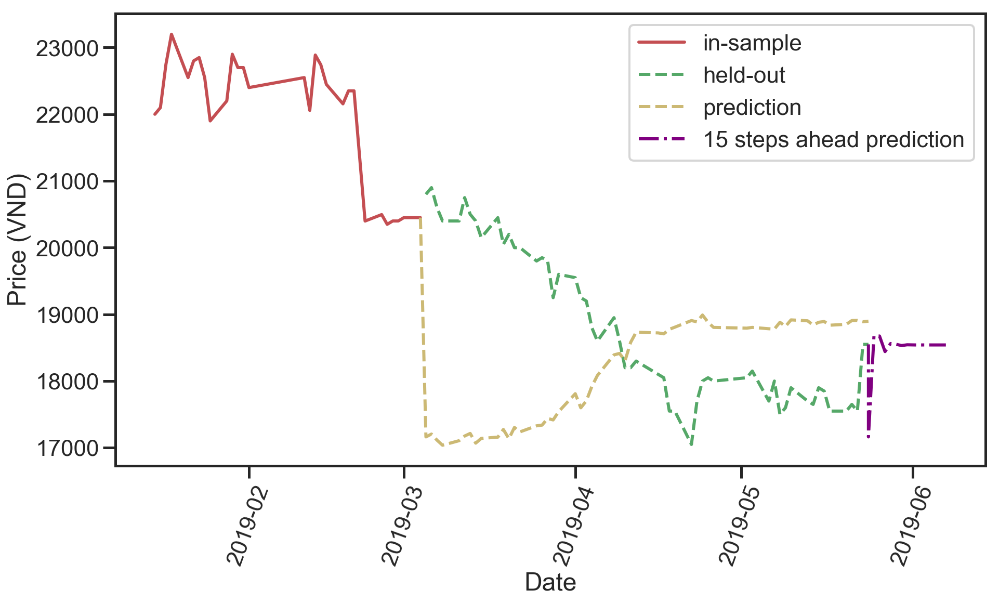

(2, 3, 3)
Testing result: {'mse': 665623.2322726917, 'rmse': 815.857360249138, 'mae': 722.3090772272752, 'mape': 3.897816617341748, 'lags': 2, 'hidden layers': (3, 3)}


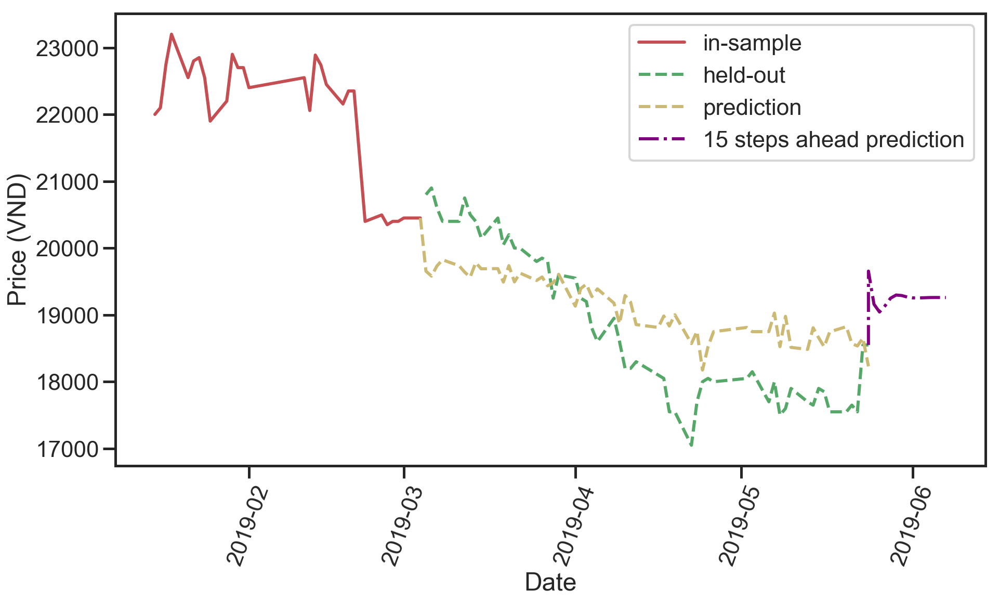

(2, 3, 3)
Testing result: {'mse': 665623.2322726917, 'rmse': 815.857360249138, 'mae': 722.3090772272752, 'mape': 3.897816617341748, 'lags': 2, 'hidden layers': (3, 3)}


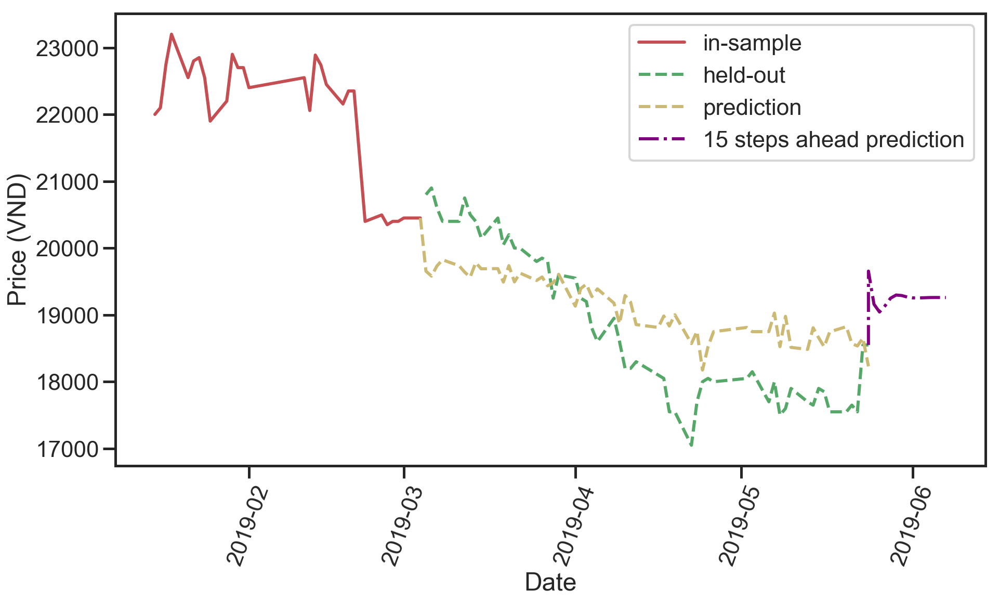

(2, 4, 1)
Testing result: {'mse': 2648685.452576699, 'rmse': 1627.478249494198, 'mae': 1294.5158186759638, 'mape': 6.59669682547928, 'lags': 2, 'hidden layers': (4, 1)}


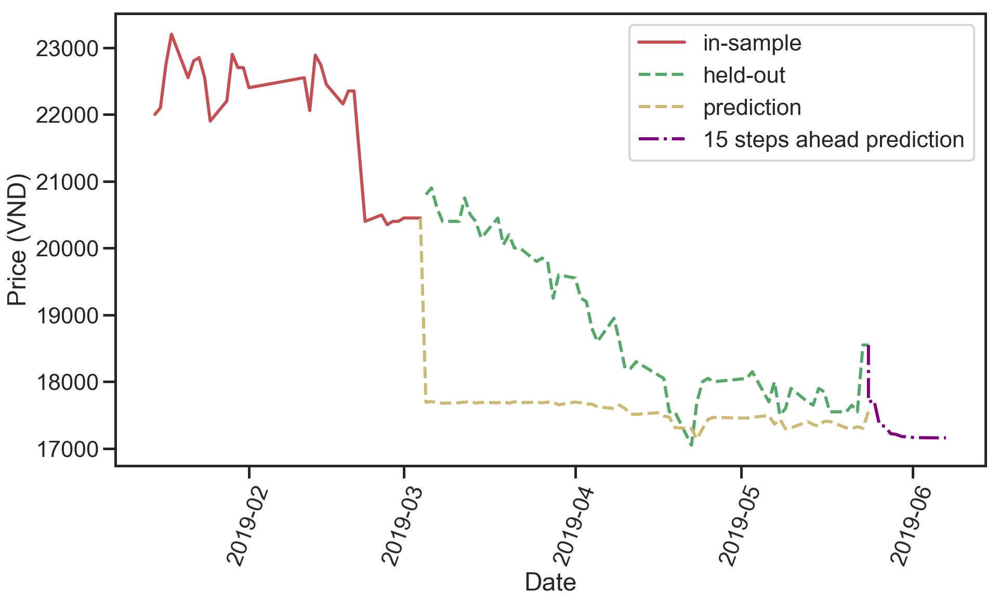

(2, 4, 2)
Testing result: {'mse': 3082424.554929976, 'rmse': 1755.683500785371, 'mae': 1479.5543463264391, 'mape': 8.167180785277282, 'lags': 2, 'hidden layers': (4, 2)}


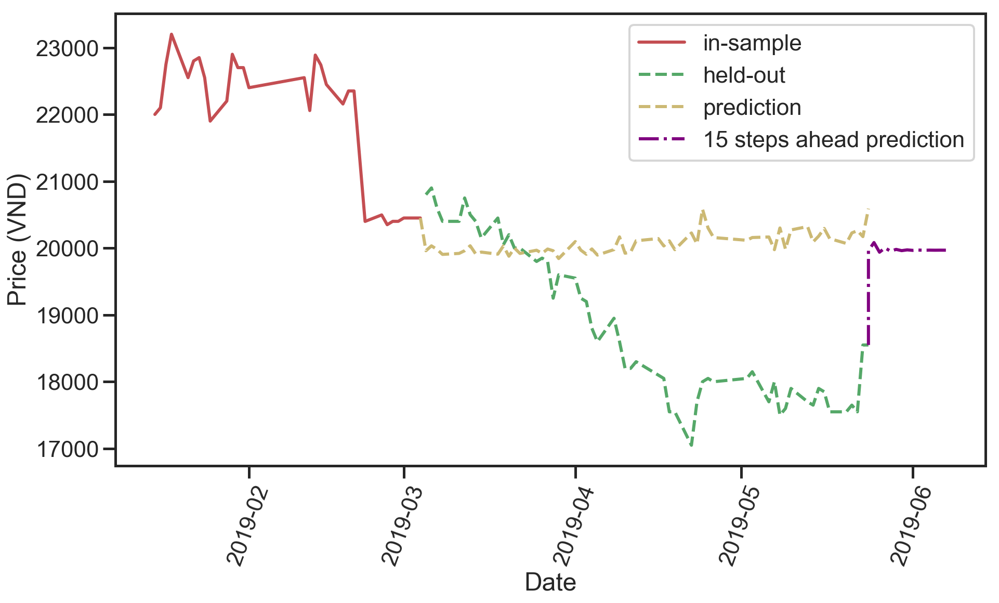

(2, 4, 2)
Testing result: {'mse': 3082424.554929976, 'rmse': 1755.683500785371, 'mae': 1479.5543463264391, 'mape': 8.167180785277282, 'lags': 2, 'hidden layers': (4, 2)}


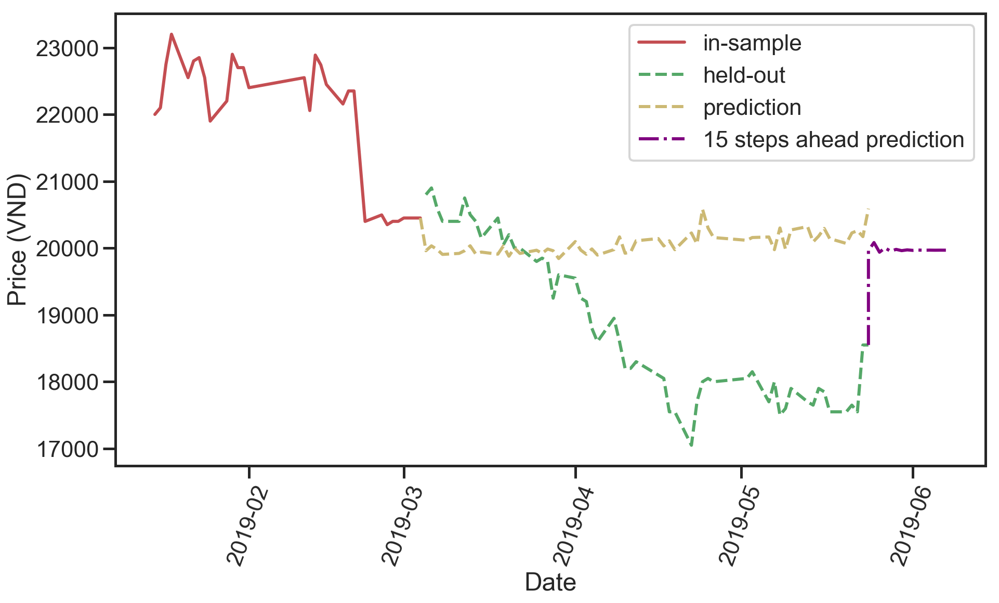

(2, 4, 3)
Testing result: {'mse': 6223487.321339823, 'rmse': 2494.691828931947, 'mae': 2178.6103255641, 'mape': 11.23756514780352, 'lags': 2, 'hidden layers': (4, 3)}


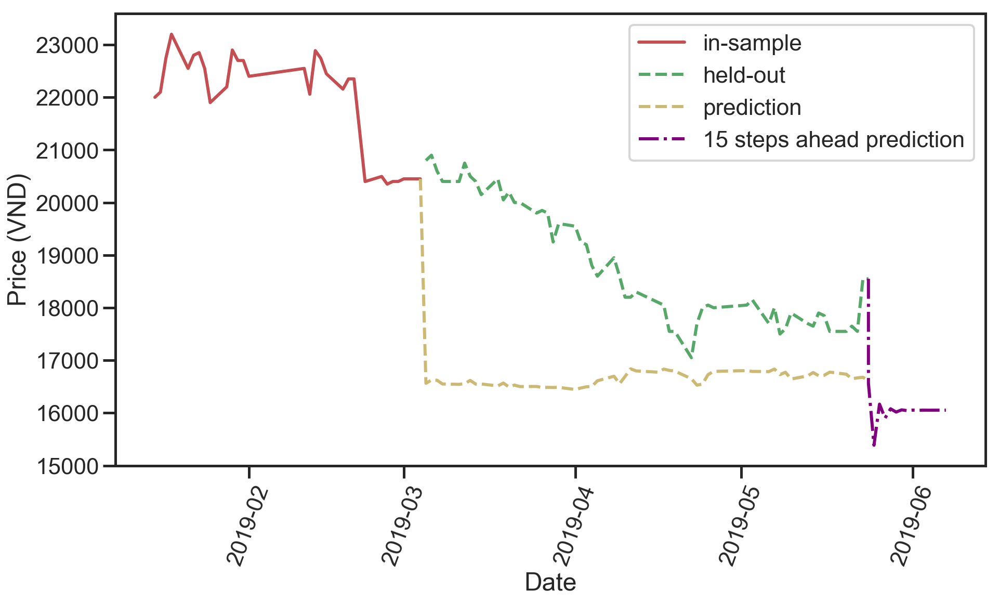

(2, 4, 3)
Testing result: {'mse': 6223487.321339823, 'rmse': 2494.691828931947, 'mae': 2178.6103255641, 'mape': 11.23756514780352, 'lags': 2, 'hidden layers': (4, 3)}


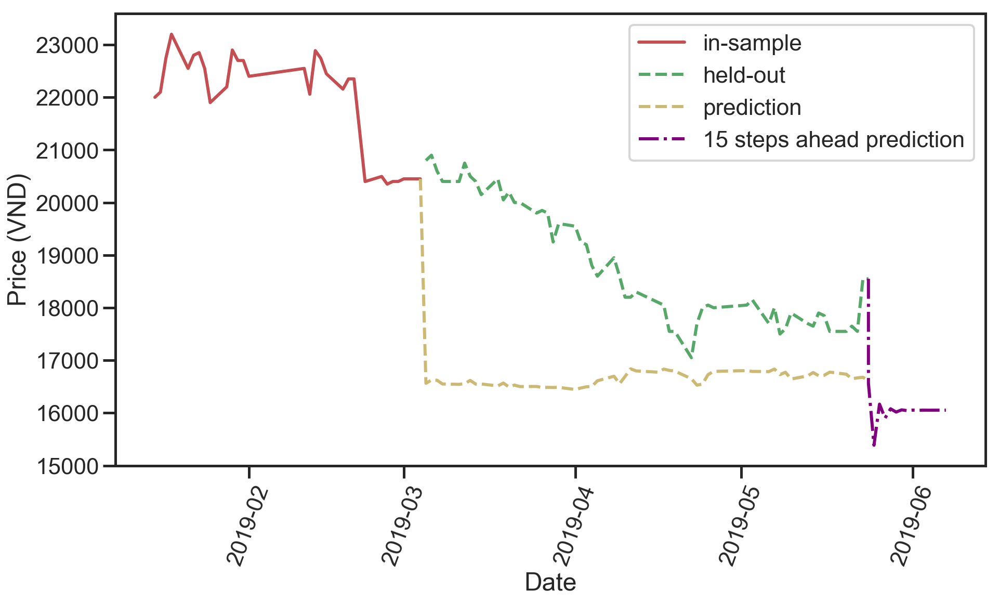

(2, 5, 1)
Testing result: {'mse': 105964.16483118745, 'rmse': 325.52137384692185, 'mae': 246.06054965446634, 'mape': 1.3153927771739529, 'lags': 2, 'hidden layers': (5, 1)}


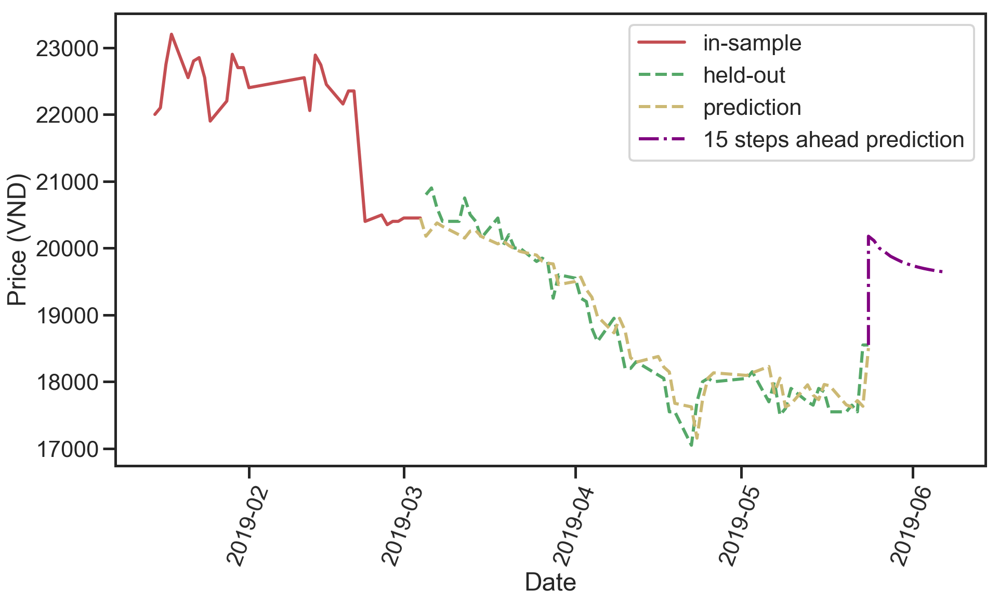

(2, 5, 2)
Testing result: {'mse': 385886.67655998335, 'rmse': 621.1977757204088, 'mae': 512.5364789755224, 'mape': 2.808891770197717, 'lags': 2, 'hidden layers': (5, 2)}


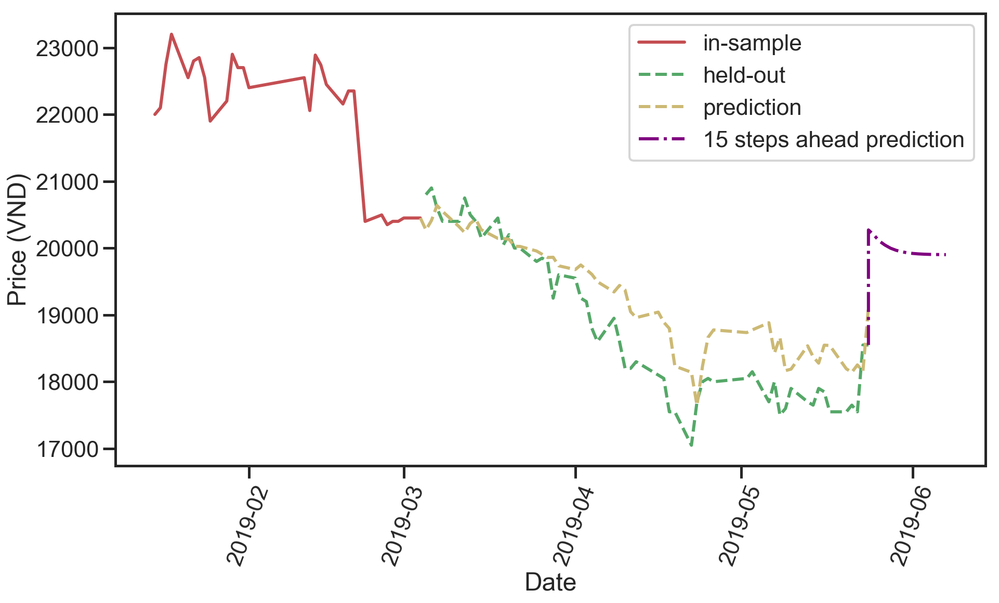

(2, 5, 2)
Testing result: {'mse': 385886.67655998335, 'rmse': 621.1977757204088, 'mae': 512.5364789755224, 'mape': 2.808891770197717, 'lags': 2, 'hidden layers': (5, 2)}


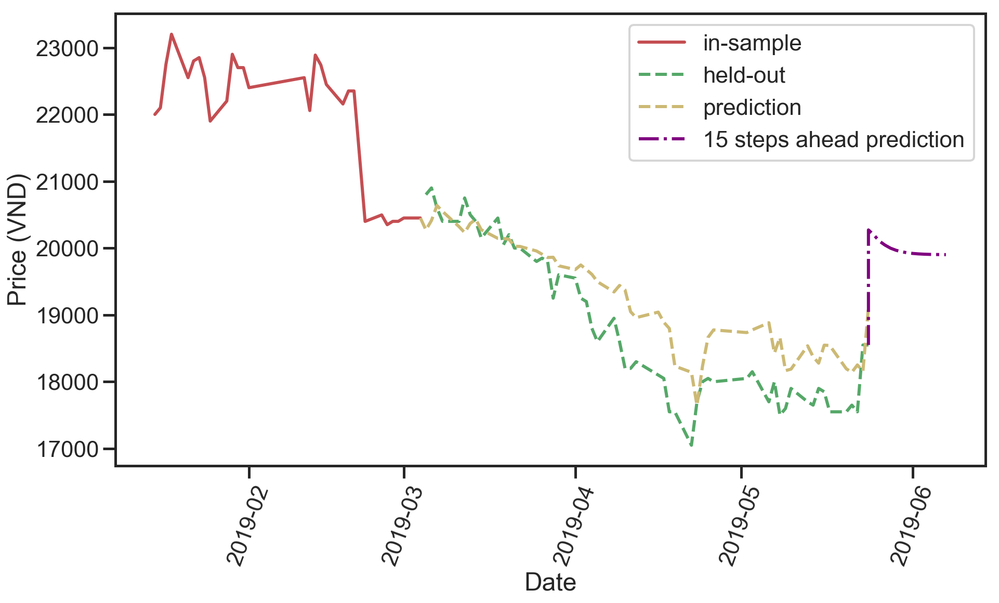

(2, 5, 3)
Testing result: {'mse': 133853.79435653525, 'rmse': 365.8603481610644, 'mae': 290.63551549485516, 'mape': 1.5572989053820625, 'lags': 2, 'hidden layers': (5, 3)}


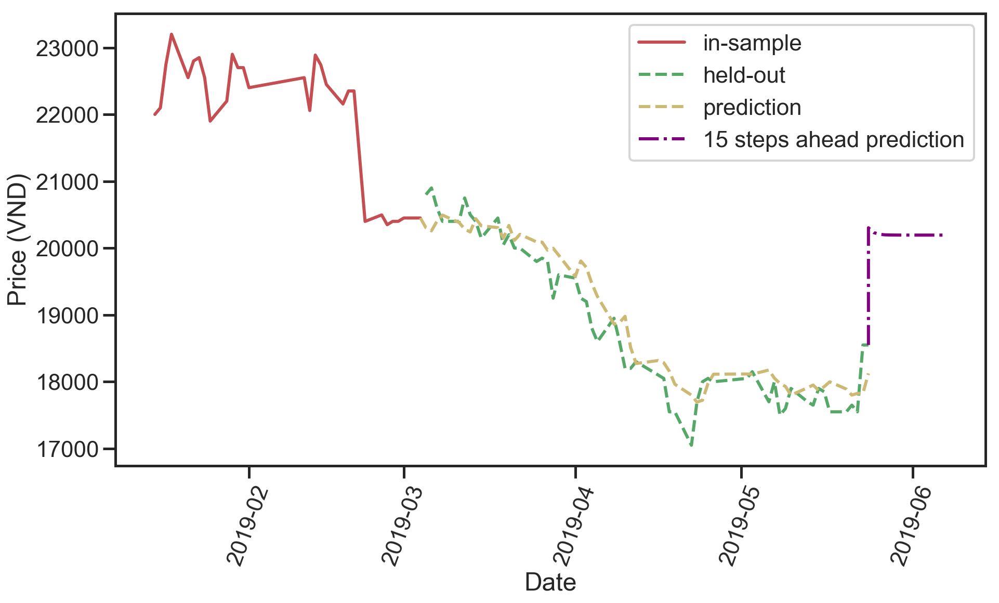

(2, 5, 3)
Testing result: {'mse': 133853.79435653525, 'rmse': 365.8603481610644, 'mae': 290.63551549485516, 'mape': 1.5572989053820625, 'lags': 2, 'hidden layers': (5, 3)}


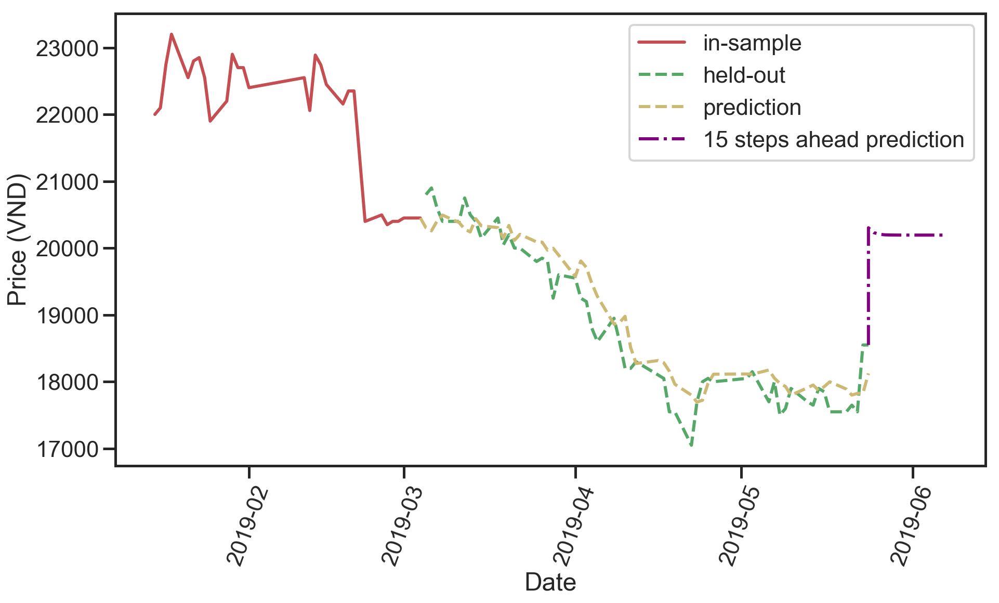

(2, 6, 1)
Testing result: {'mse': 538266.8092269751, 'rmse': 733.6666880995587, 'mae': 580.2969364117187, 'mape': 2.9979465631023325, 'lags': 2, 'hidden layers': (6, 1)}


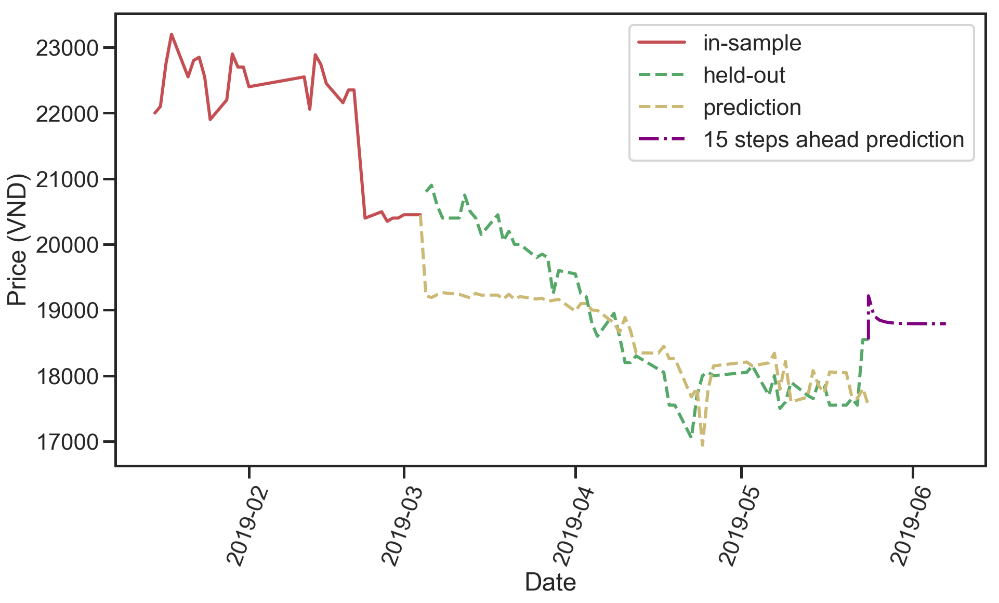

(2, 6, 2)
Testing result: {'mse': 97252.25790317431, 'rmse': 311.85294275214767, 'mae': 249.72351580094434, 'mape': 1.340471568507135, 'lags': 2, 'hidden layers': (6, 2)}


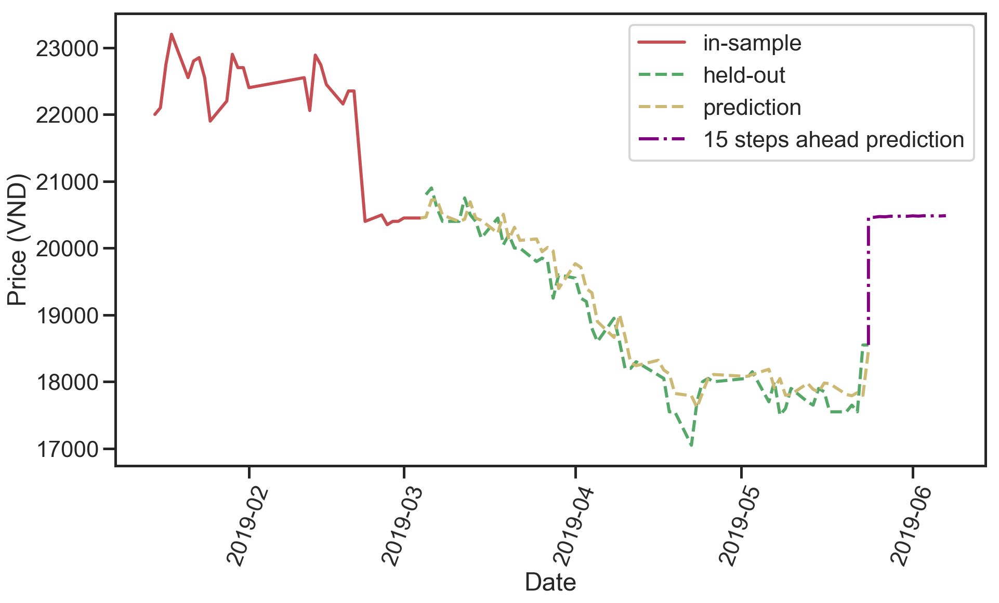

(2, 6, 2)
Testing result: {'mse': 97252.25790317431, 'rmse': 311.85294275214767, 'mae': 249.72351580094434, 'mape': 1.340471568507135, 'lags': 2, 'hidden layers': (6, 2)}


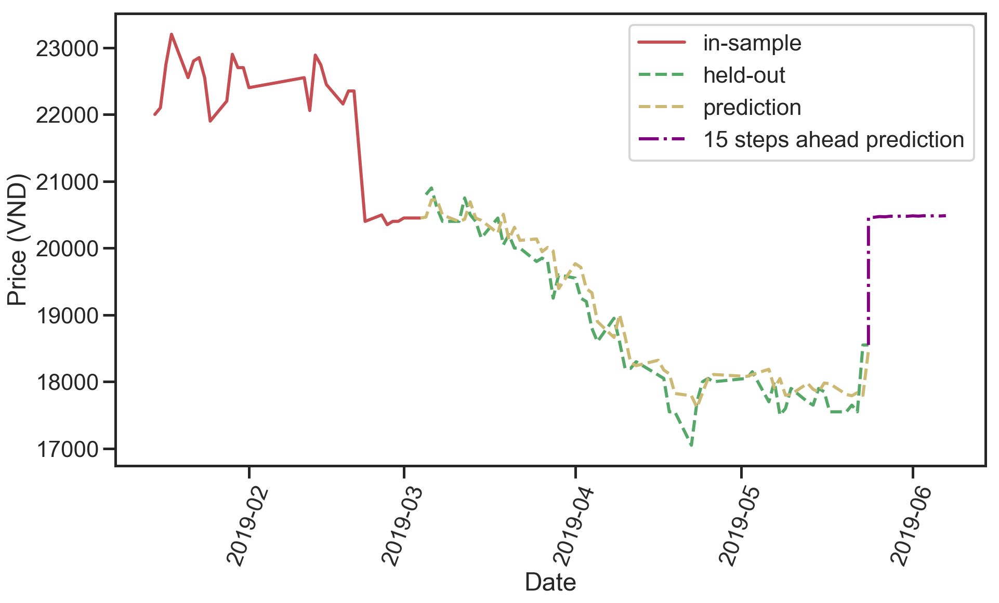

(2, 6, 3)
Testing result: {'mse': 130475.65426180778, 'rmse': 361.21413906685297, 'mae': 280.29845652450115, 'mape': 1.4908699723913084, 'lags': 2, 'hidden layers': (6, 3)}


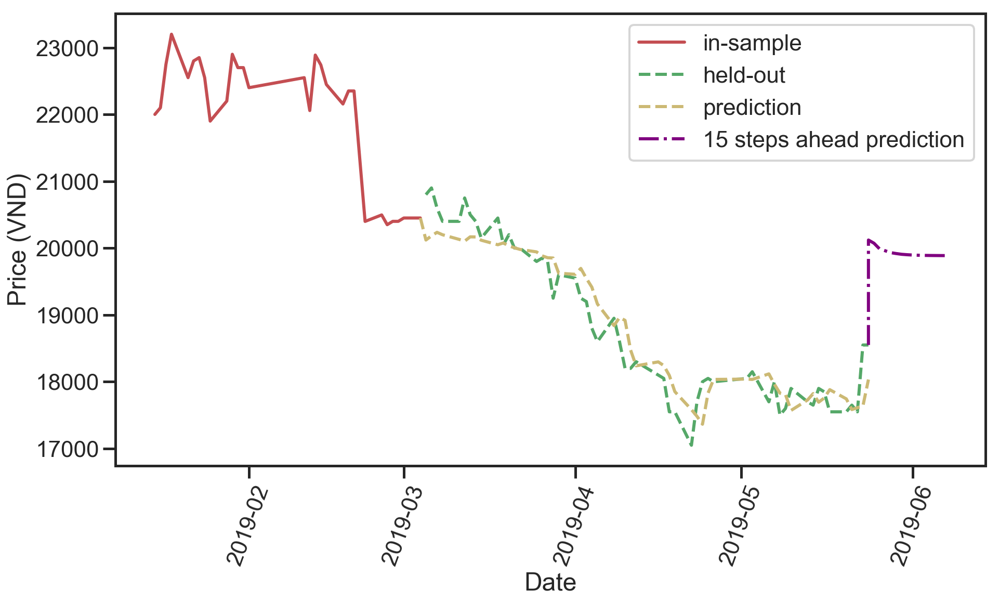

(2, 6, 3)
Testing result: {'mse': 130475.65426180778, 'rmse': 361.21413906685297, 'mae': 280.29845652450115, 'mape': 1.4908699723913084, 'lags': 2, 'hidden layers': (6, 3)}


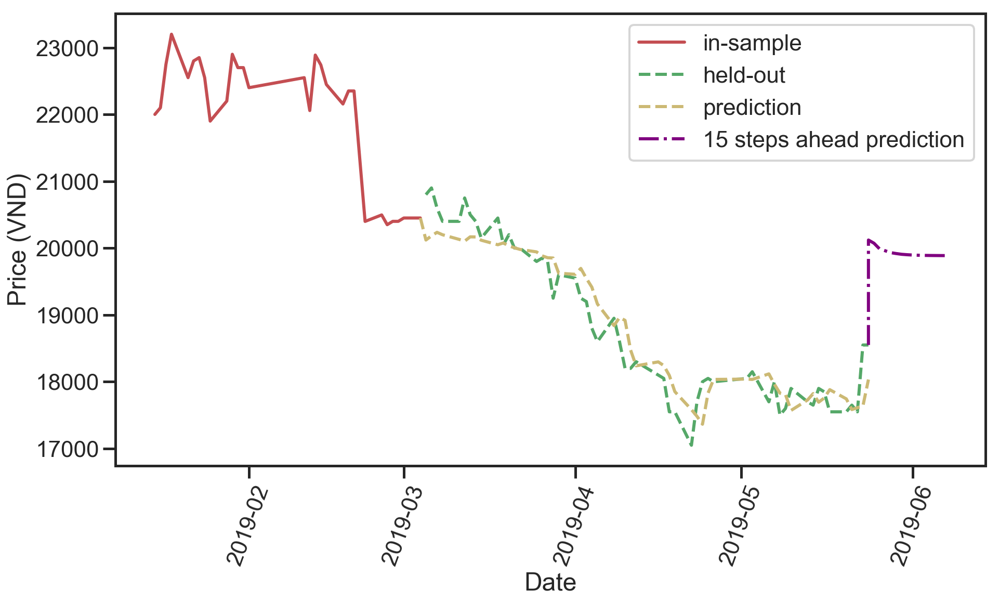

(2, 7, 1)
Testing result: {'mse': 10661613.595589347, 'rmse': 3265.212641711003, 'mae': 2397.14960993382, 'mape': 12.099223351825486, 'lags': 2, 'hidden layers': (7, 1)}


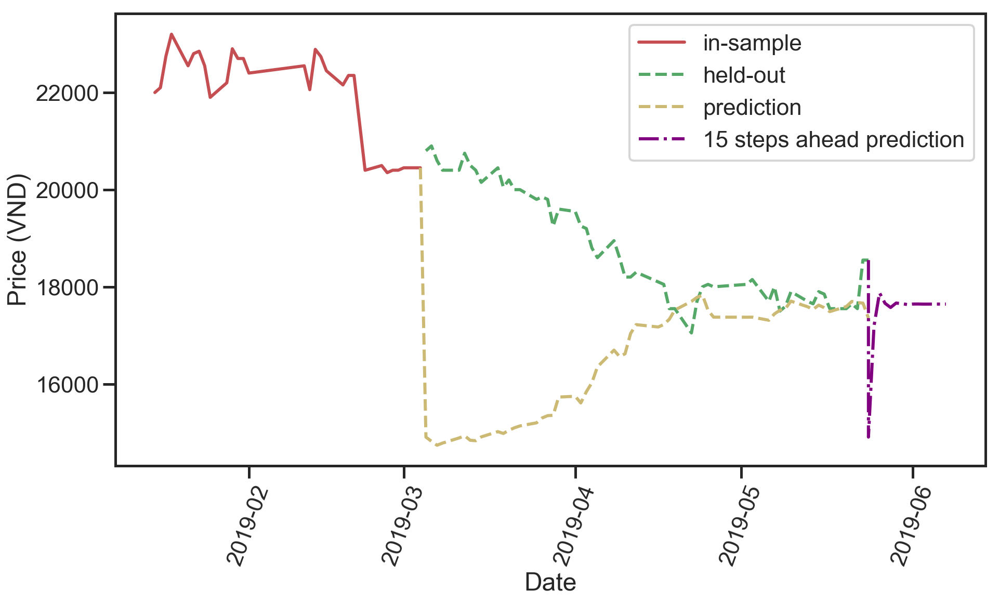

(2, 7, 2)
Testing result: {'mse': 235565.7754340316, 'rmse': 485.35118773320374, 'mae': 376.1168674442218, 'mape': 1.9889248744416592, 'lags': 2, 'hidden layers': (7, 2)}


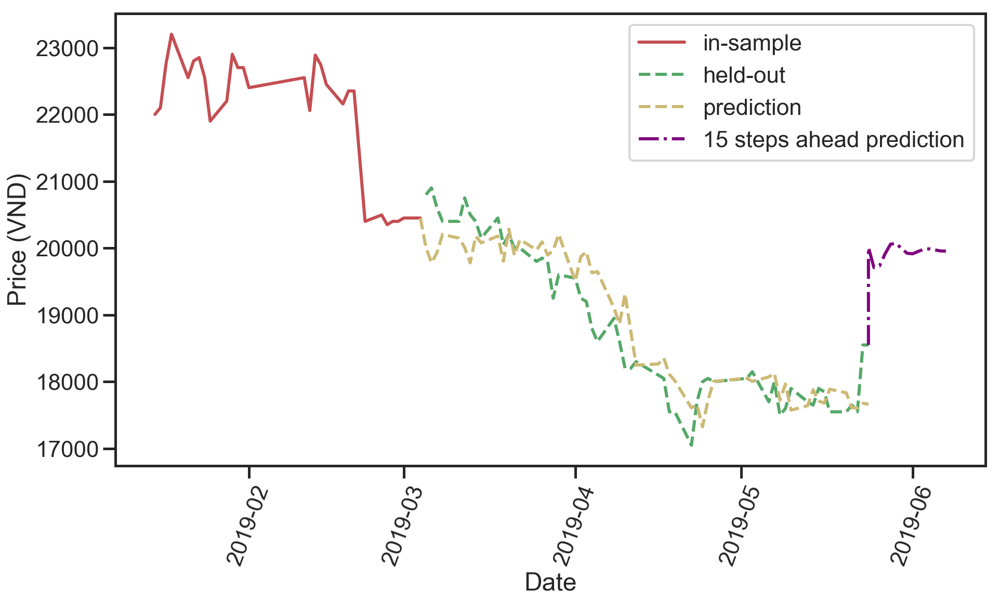

(2, 7, 2)
Testing result: {'mse': 235565.7754340316, 'rmse': 485.35118773320374, 'mae': 376.1168674442218, 'mape': 1.9889248744416592, 'lags': 2, 'hidden layers': (7, 2)}


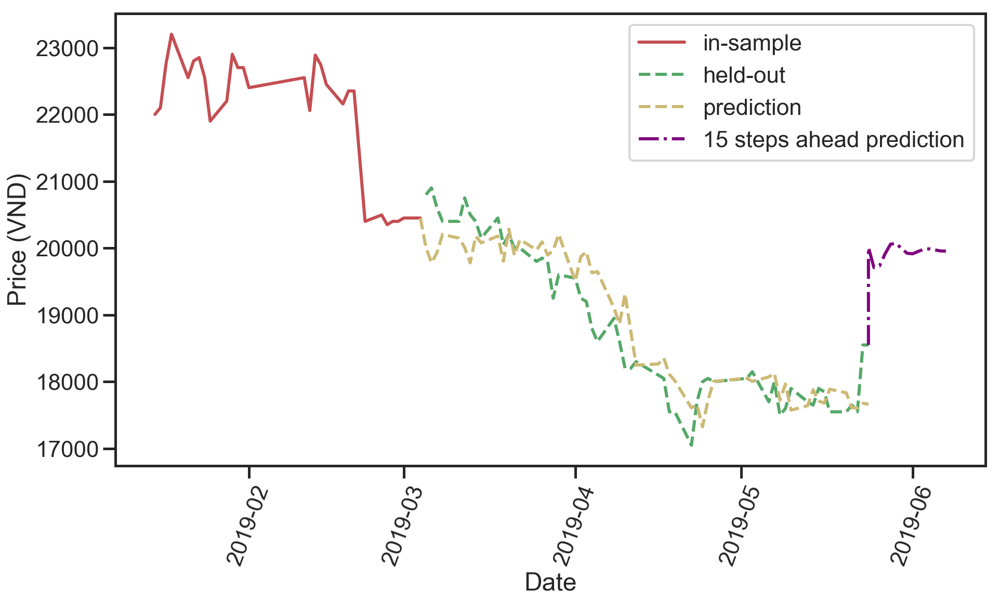

(2, 7, 3)
Testing result: {'mse': 101823.07144727506, 'rmse': 319.0972758380664, 'mae': 249.33843642984053, 'mape': 1.3257614914553992, 'lags': 2, 'hidden layers': (7, 3)}


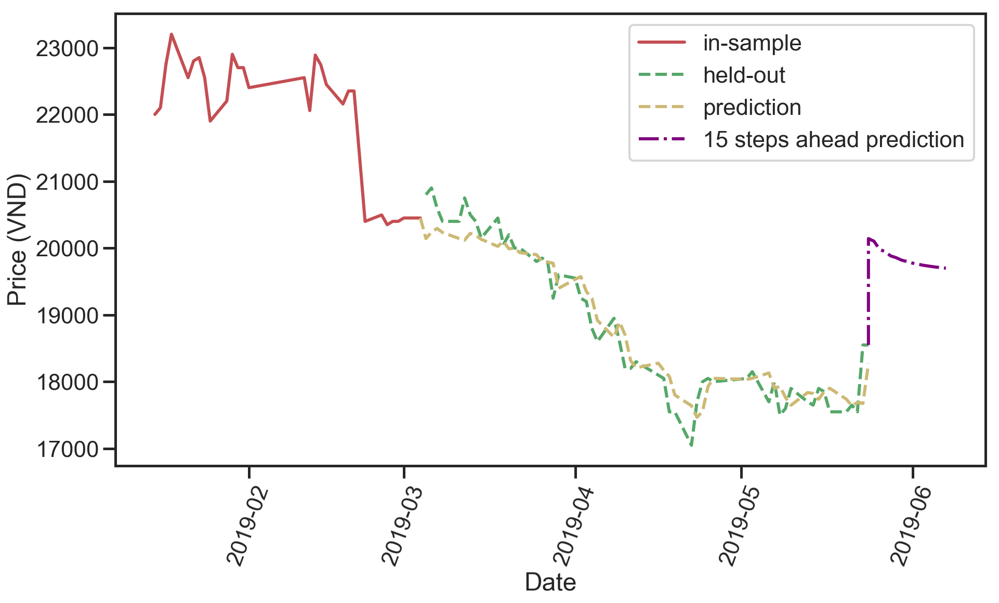

(2, 7, 3)
Testing result: {'mse': 101823.07144727506, 'rmse': 319.0972758380664, 'mae': 249.33843642984053, 'mape': 1.3257614914553992, 'lags': 2, 'hidden layers': (7, 3)}


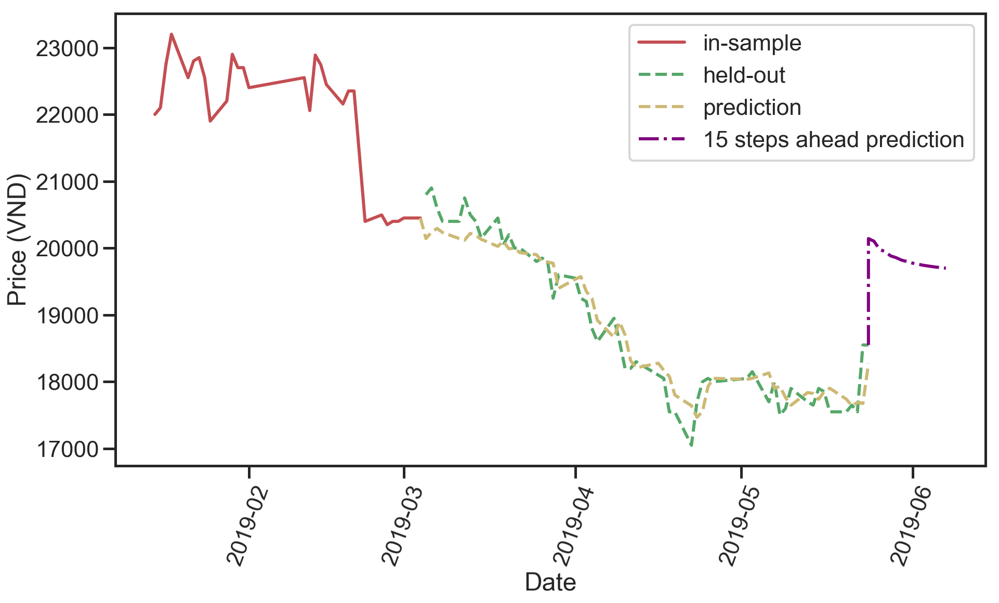

(3, 3, 1)
Testing result: {'mse': 1379317.4943716847, 'rmse': 1174.4434828341825, 'mae': 1074.0084638522112, 'mape': 5.707683823547214, 'lags': 3, 'hidden layers': (3, 1)}


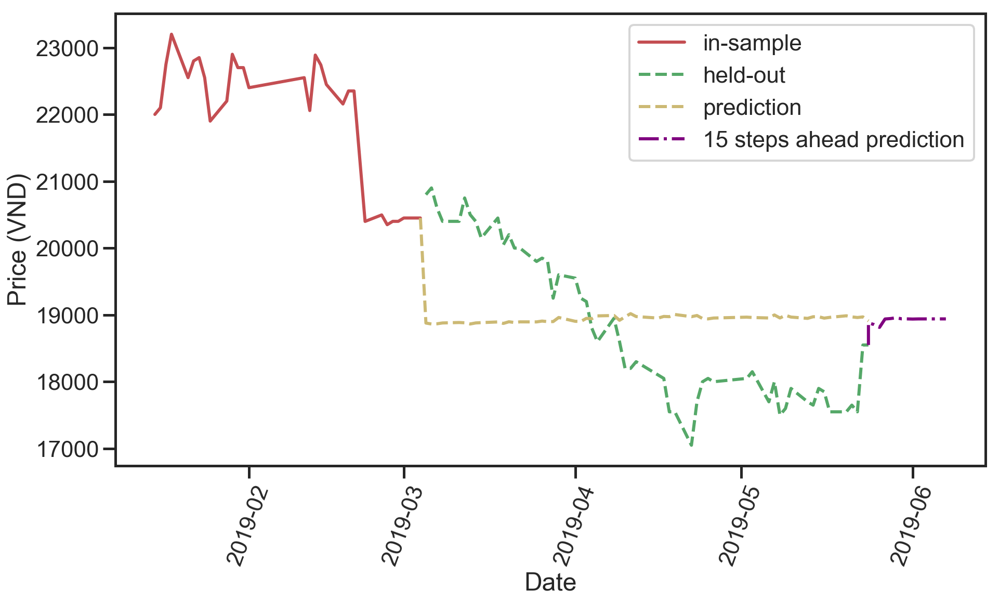

(3, 3, 2)
Testing result: {'mse': 2720563.957984583, 'rmse': 1649.4132162634635, 'mae': 1291.933085574282, 'mape': 6.577306747884106, 'lags': 3, 'hidden layers': (3, 2)}


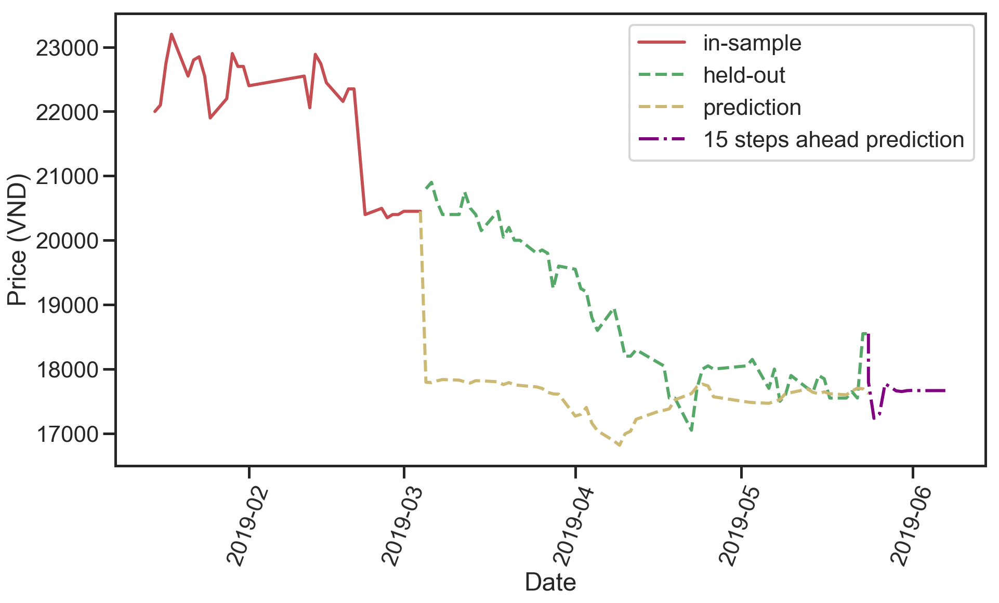

(3, 3, 2)
Testing result: {'mse': 2720563.957984583, 'rmse': 1649.4132162634635, 'mae': 1291.933085574282, 'mape': 6.577306747884106, 'lags': 3, 'hidden layers': (3, 2)}


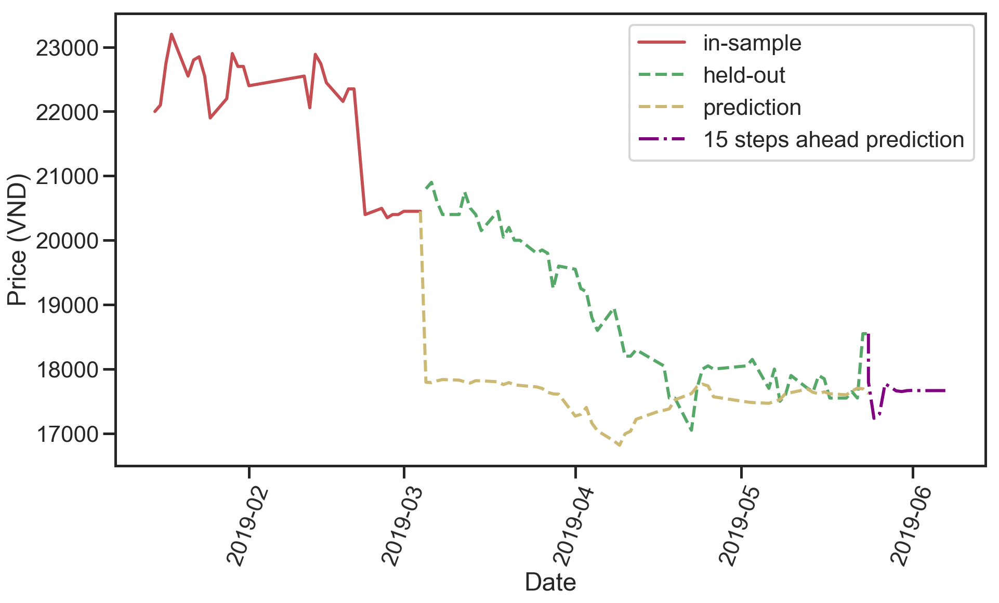

(3, 3, 3)
Testing result: {'mse': 451711.51493236324, 'rmse': 672.094870485085, 'mae': 579.2640841807342, 'mape': 3.0403262347309035, 'lags': 3, 'hidden layers': (3, 3)}


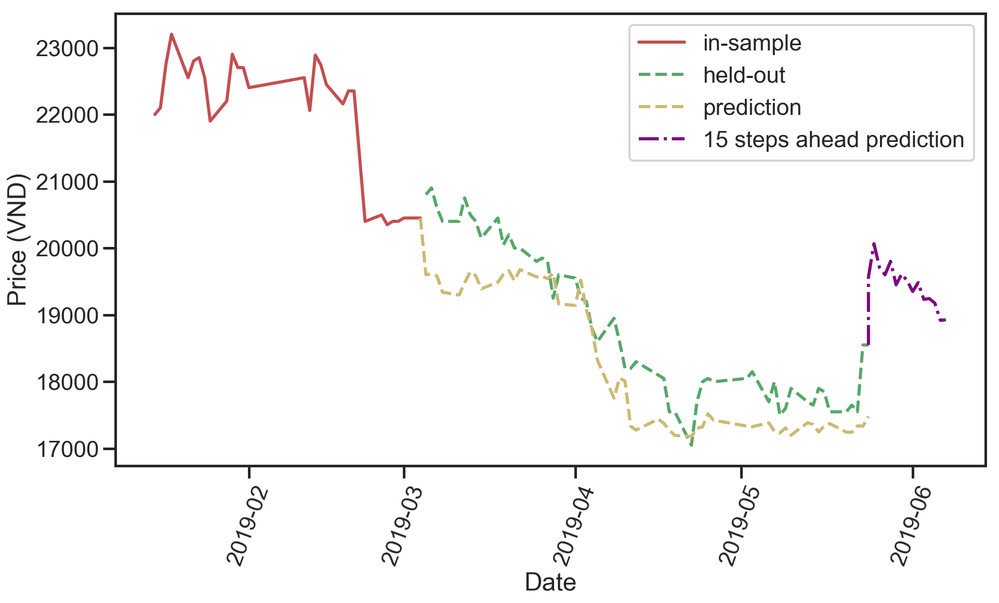

(3, 3, 3)
Testing result: {'mse': 451711.51493236324, 'rmse': 672.094870485085, 'mae': 579.2640841807342, 'mape': 3.0403262347309035, 'lags': 3, 'hidden layers': (3, 3)}


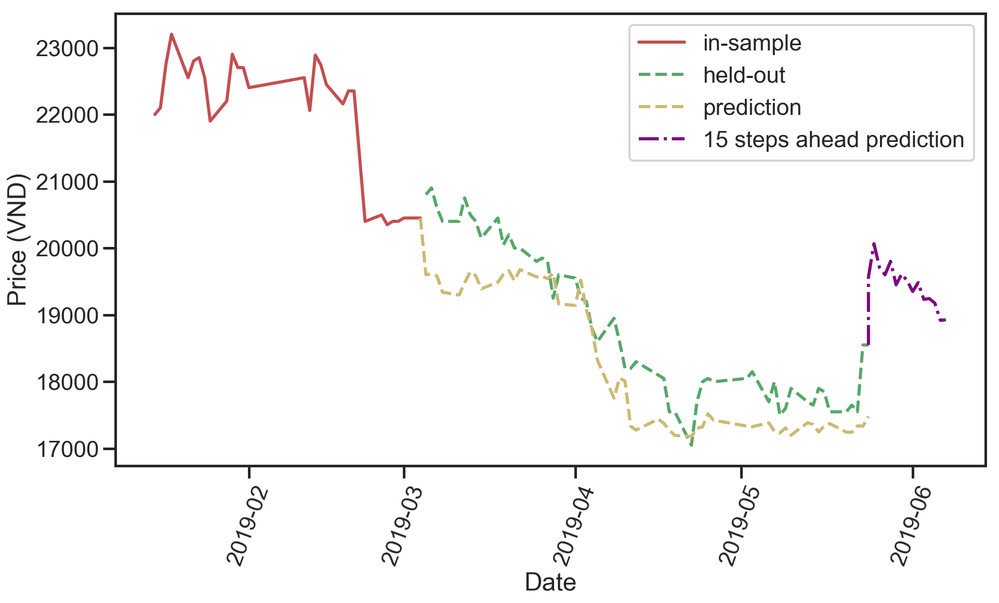

(3, 4, 1)
Testing result: {'mse': 258657.92379175528, 'rmse': 508.5842347062631, 'mae': 396.8160866036207, 'mape': 2.117850133596537, 'lags': 3, 'hidden layers': (4, 1)}


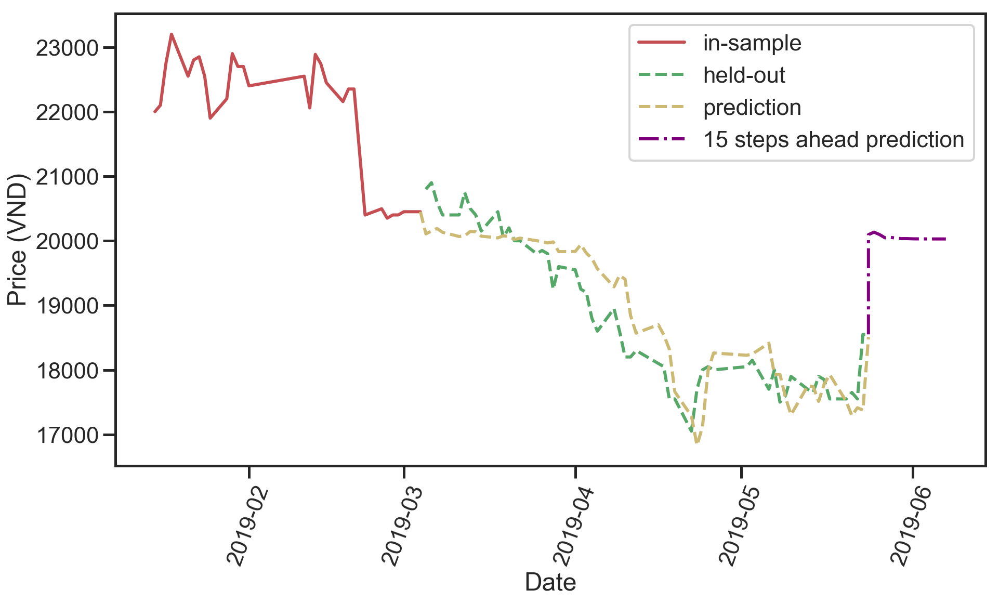

(3, 4, 2)
Testing result: {'mse': 357505.4129466787, 'rmse': 597.9175636713466, 'mae': 493.52619736403415, 'mape': 2.6259455694974525, 'lags': 3, 'hidden layers': (4, 2)}


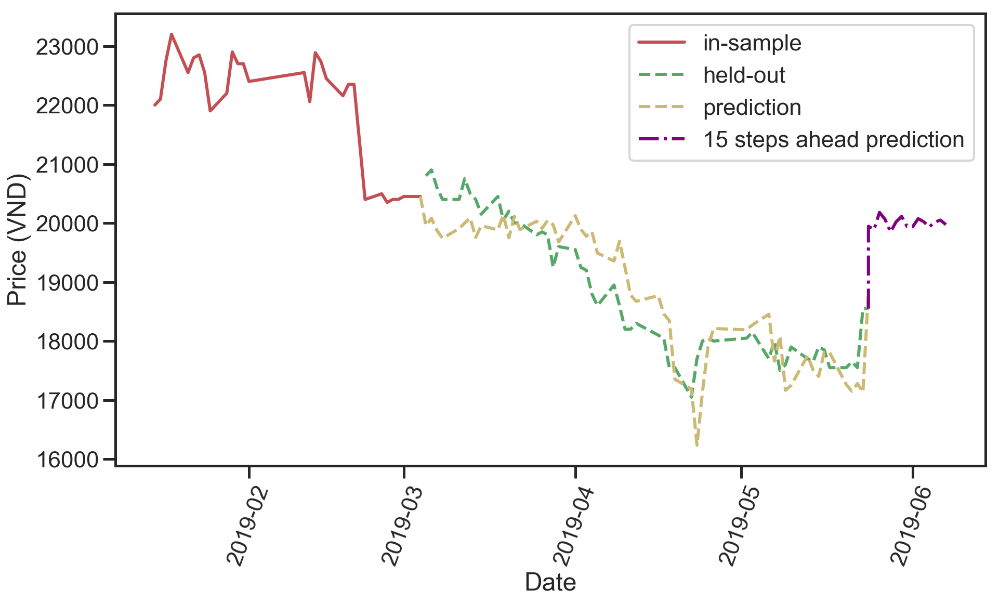

(3, 4, 2)
Testing result: {'mse': 357505.4129466787, 'rmse': 597.9175636713466, 'mae': 493.52619736403415, 'mape': 2.6259455694974525, 'lags': 3, 'hidden layers': (4, 2)}


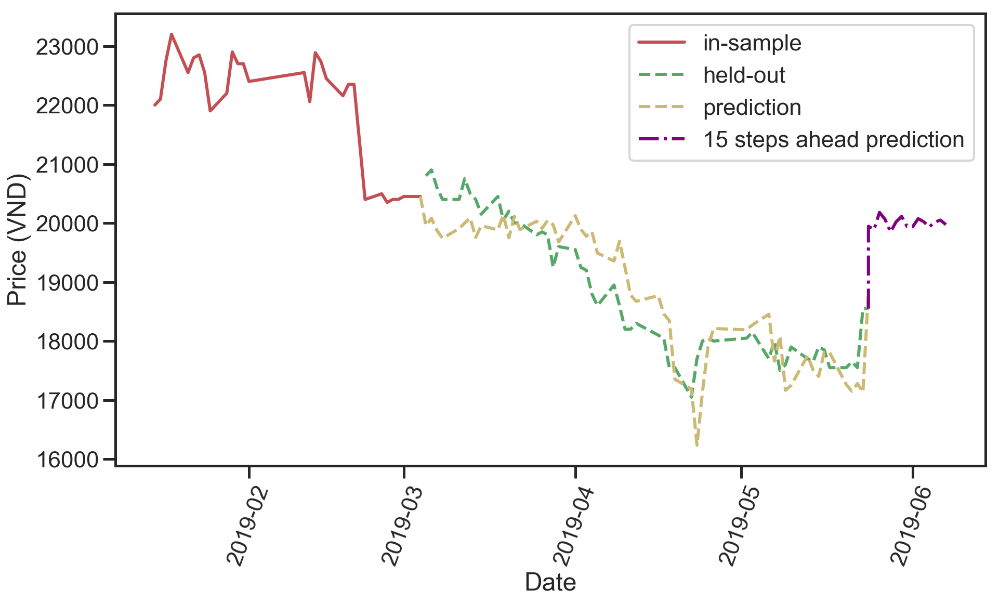

(3, 4, 3)
Testing result: {'mse': 376103.360709107, 'rmse': 613.2726642441411, 'mae': 510.385938738489, 'mape': 2.788763226080041, 'lags': 3, 'hidden layers': (4, 3)}


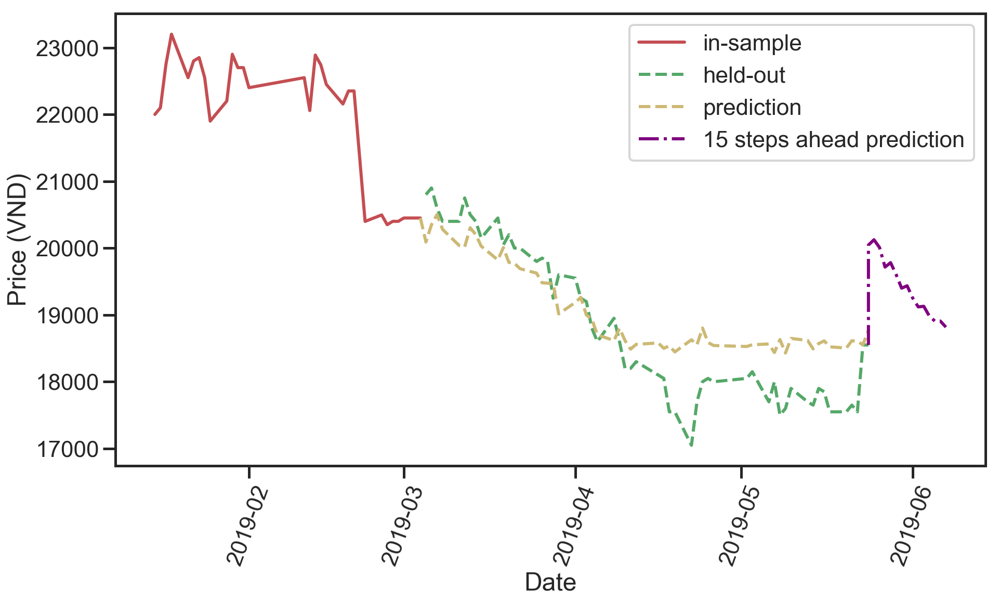

(3, 4, 3)
Testing result: {'mse': 376103.360709107, 'rmse': 613.2726642441411, 'mae': 510.385938738489, 'mape': 2.788763226080041, 'lags': 3, 'hidden layers': (4, 3)}


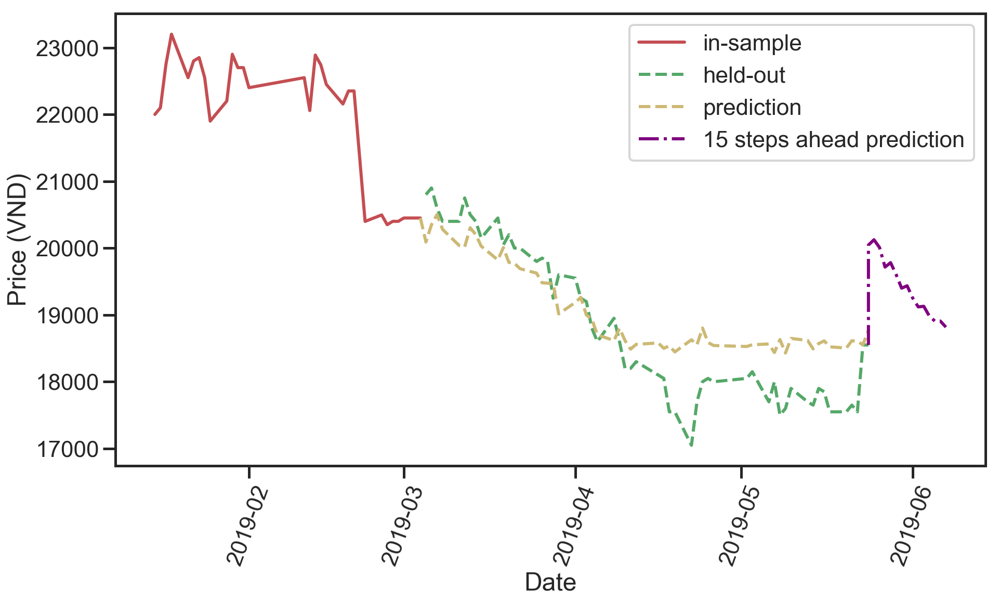

(3, 5, 1)
Testing result: {'mse': 1932293.3664056219, 'rmse': 1390.069554520788, 'mae': 1189.3366572751372, 'mape': 6.1346253097339165, 'lags': 3, 'hidden layers': (5, 1)}


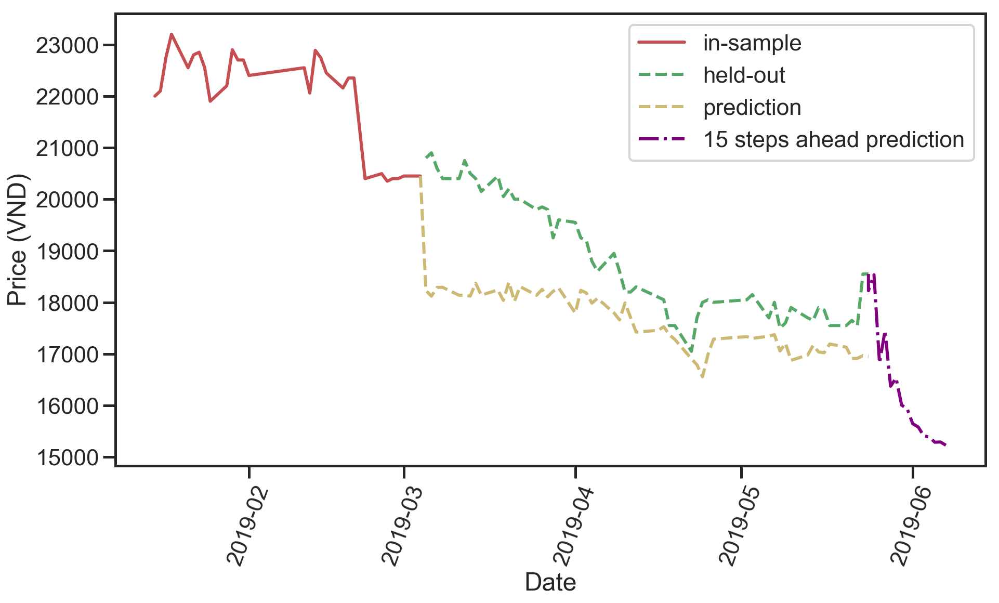

(3, 5, 2)
Testing result: {'mse': 469402.1108002477, 'rmse': 685.1292657595701, 'mae': 608.1337382852444, 'mape': 3.2286049274056365, 'lags': 3, 'hidden layers': (5, 2)}


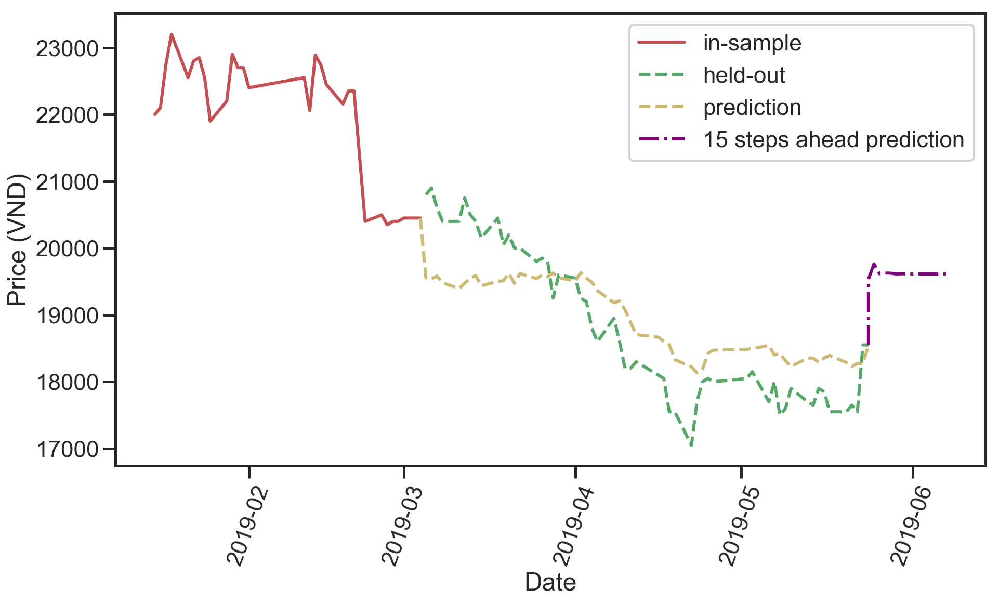

(3, 5, 2)
Testing result: {'mse': 469402.1108002477, 'rmse': 685.1292657595701, 'mae': 608.1337382852444, 'mape': 3.2286049274056365, 'lags': 3, 'hidden layers': (5, 2)}


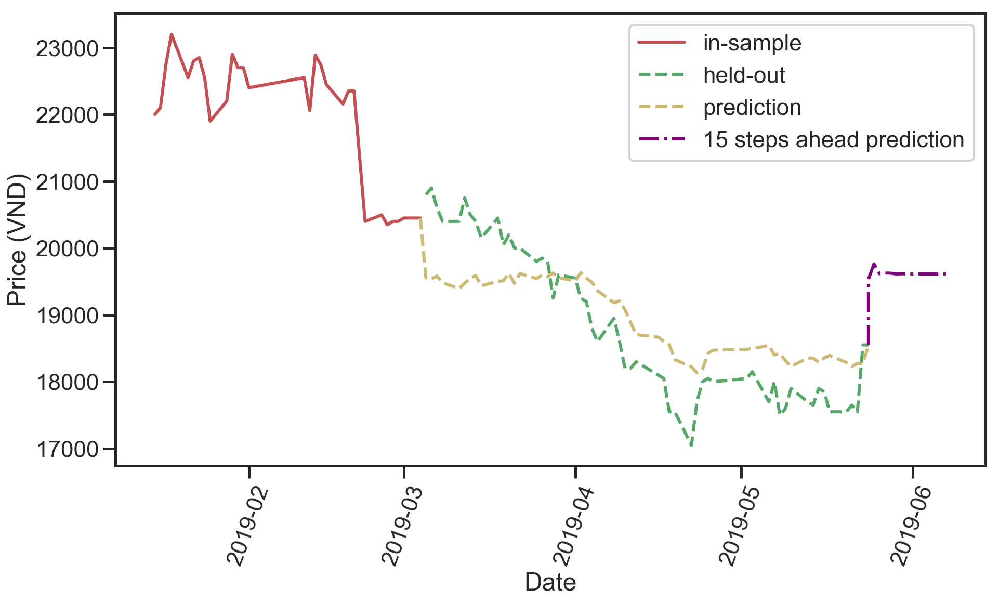

(3, 5, 3)
Testing result: {'mse': 1679411.262752738, 'rmse': 1295.9210094572654, 'mae': 1220.985156685252, 'mape': 6.42497347570495, 'lags': 3, 'hidden layers': (5, 3)}


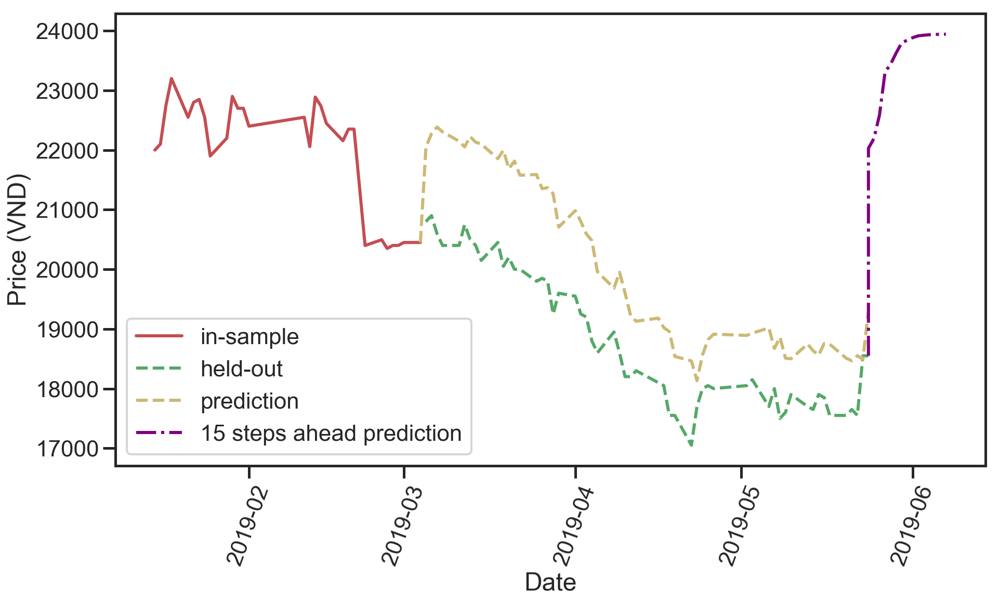

(3, 5, 3)
Testing result: {'mse': 1679411.262752738, 'rmse': 1295.9210094572654, 'mae': 1220.985156685252, 'mape': 6.42497347570495, 'lags': 3, 'hidden layers': (5, 3)}


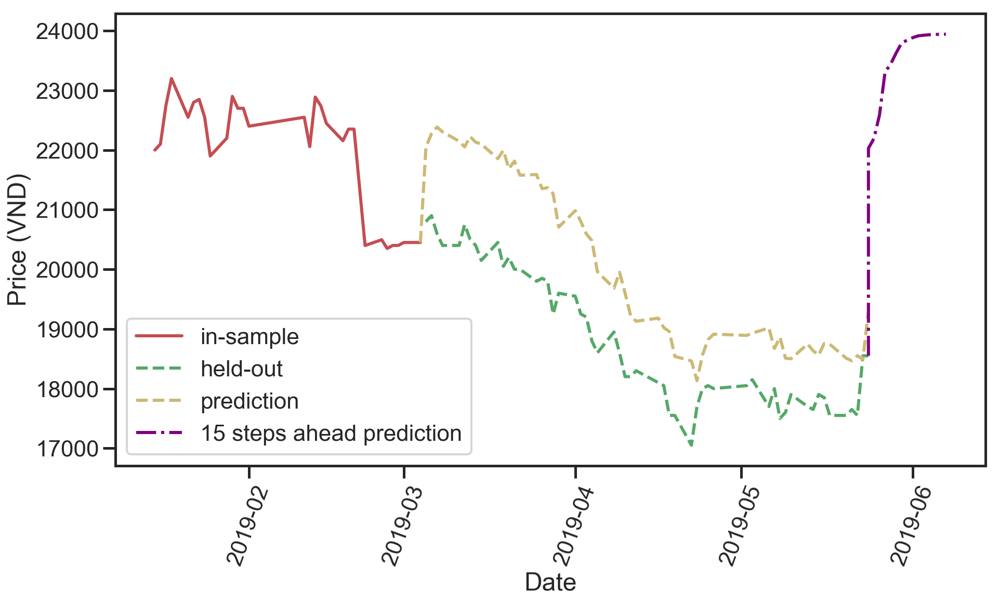

(3, 6, 1)
Testing result: {'mse': 10028499.867347762, 'rmse': 3166.7806787568607, 'mae': 2897.4694944353937, 'mape': 15.852364275829148, 'lags': 3, 'hidden layers': (6, 1)}


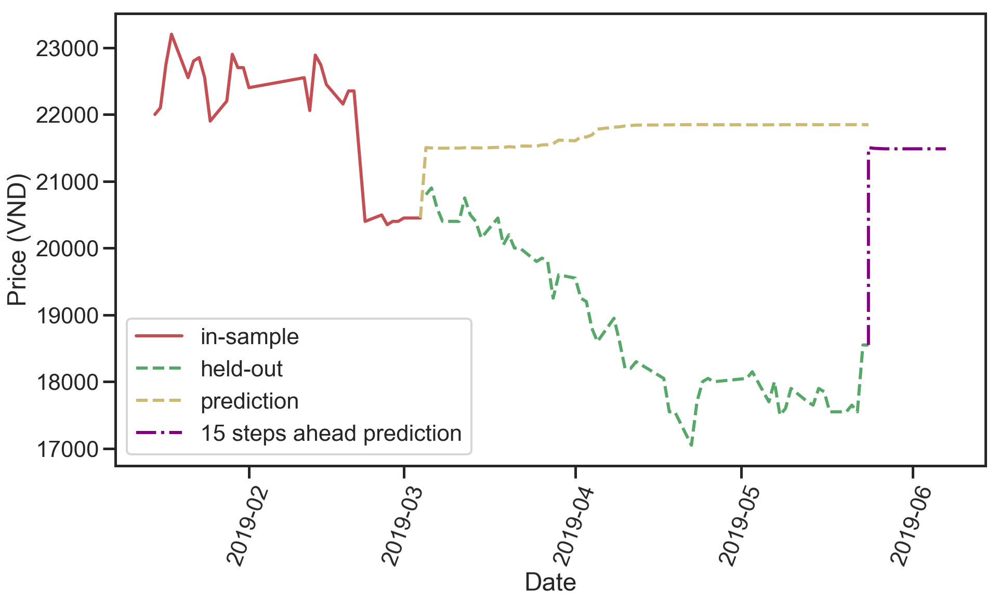

(3, 6, 2)
Testing result: {'mse': 2324805.171047719, 'rmse': 1524.7311799290126, 'mae': 1383.857376560198, 'mape': 7.570948822669732, 'lags': 3, 'hidden layers': (6, 2)}


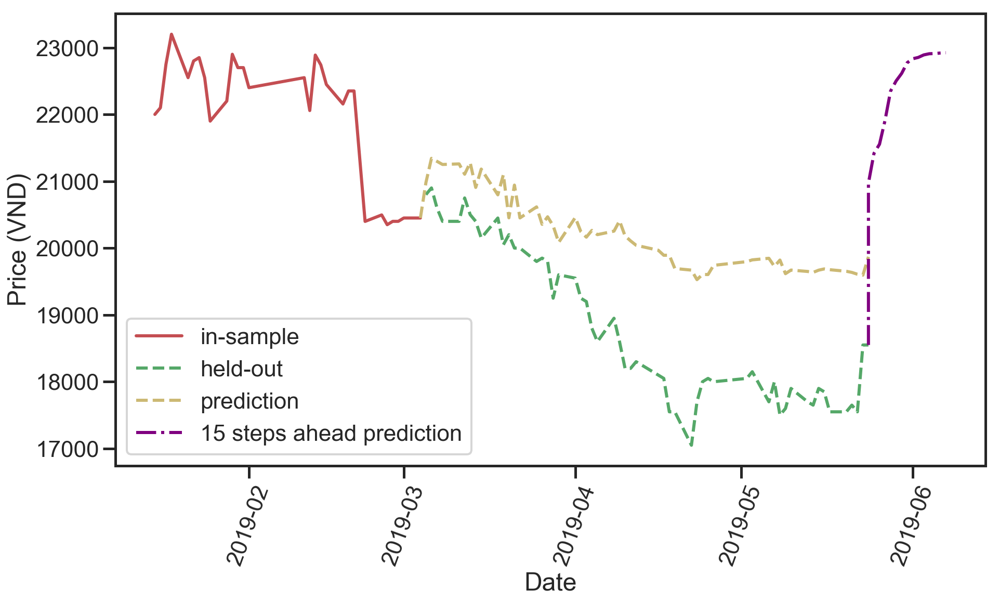

(3, 6, 2)
Testing result: {'mse': 2324805.171047719, 'rmse': 1524.7311799290126, 'mae': 1383.857376560198, 'mape': 7.570948822669732, 'lags': 3, 'hidden layers': (6, 2)}


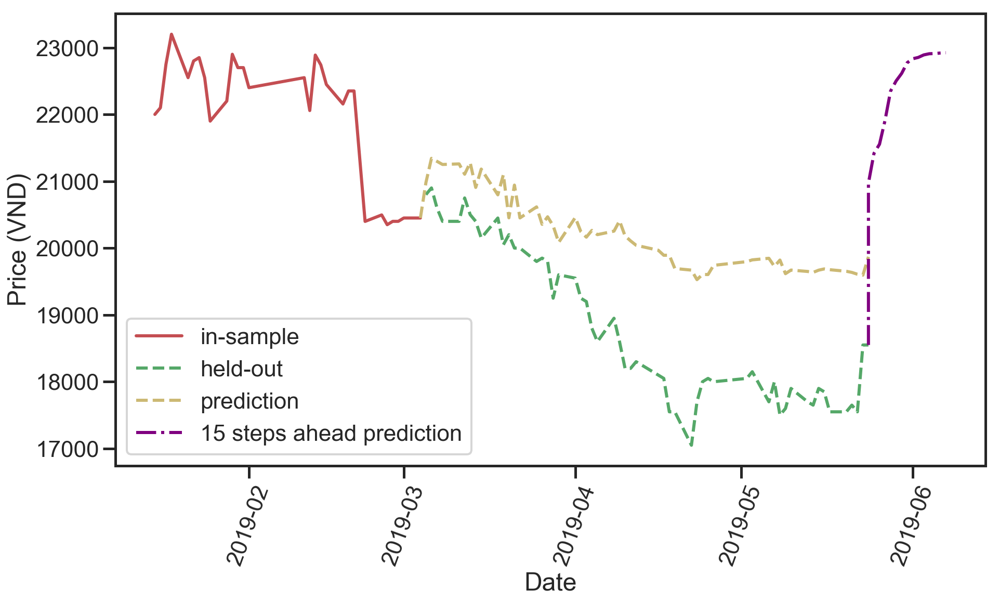

(3, 6, 3)
Testing result: {'mse': 453787.984916789, 'rmse': 673.637873725037, 'mae': 578.5168538057576, 'mape': 3.061923971999528, 'lags': 3, 'hidden layers': (6, 3)}


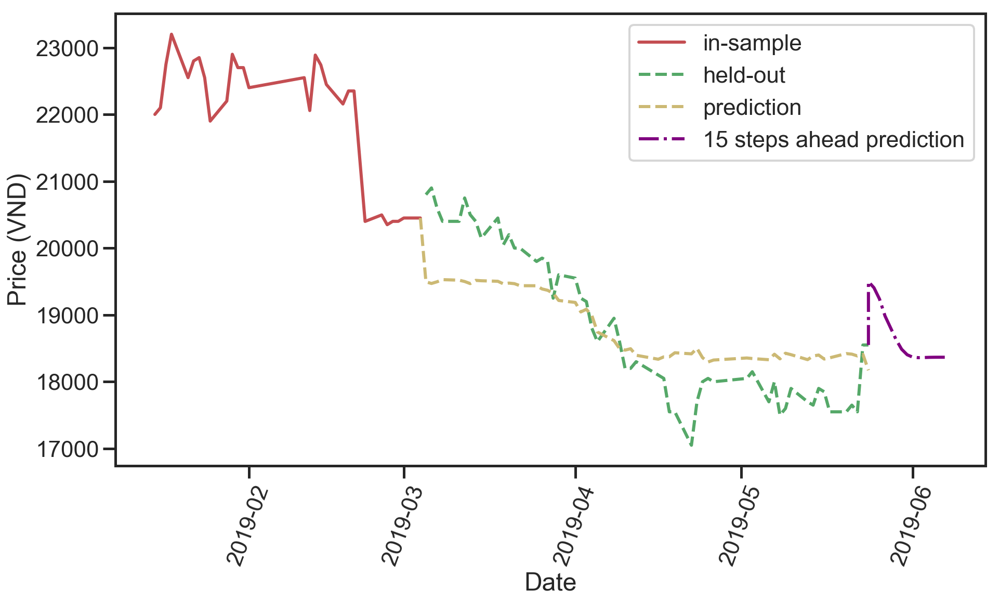

(3, 6, 3)
Testing result: {'mse': 453787.984916789, 'rmse': 673.637873725037, 'mae': 578.5168538057576, 'mape': 3.061923971999528, 'lags': 3, 'hidden layers': (6, 3)}


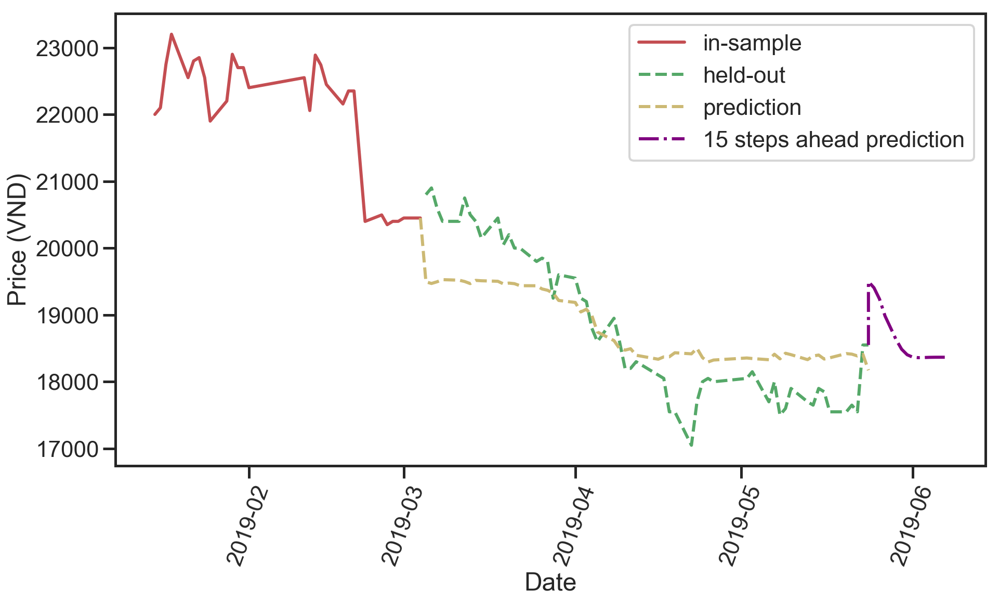

(3, 7, 1)
Testing result: {'mse': 1217048.8476285958, 'rmse': 1103.1993689395383, 'mae': 892.1836094809329, 'mape': 4.949052726409667, 'lags': 3, 'hidden layers': (7, 1)}


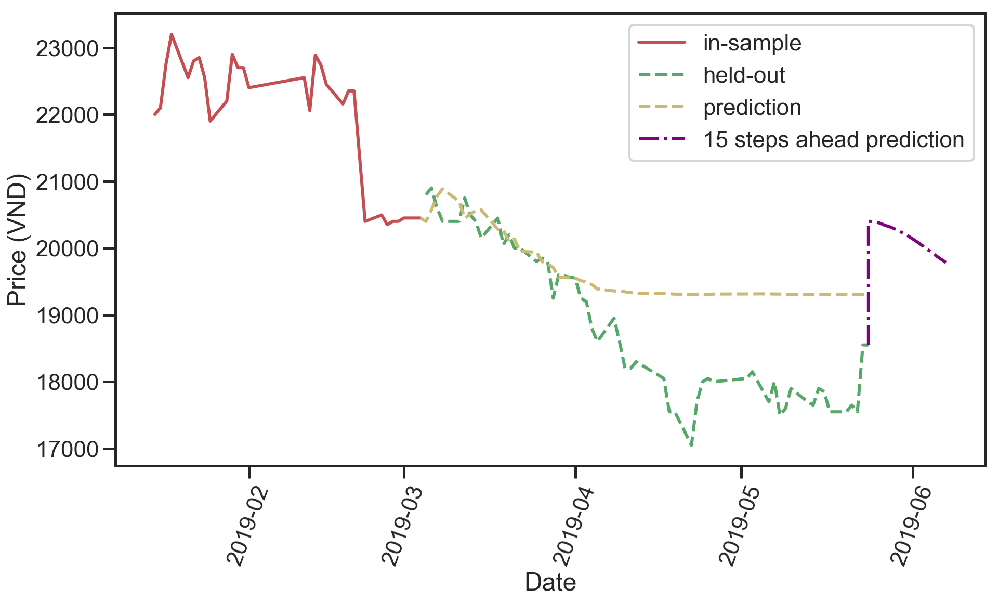

(3, 7, 2)
Testing result: {'mse': 435056.5677861942, 'rmse': 659.588180447614, 'mae': 557.3770444372125, 'mape': 3.035872129977336, 'lags': 3, 'hidden layers': (7, 2)}


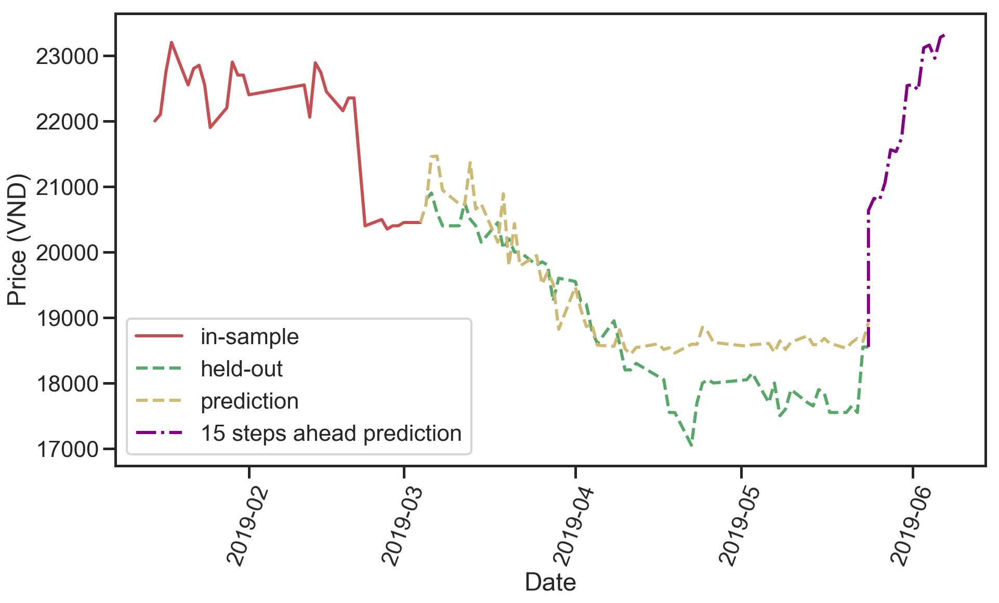

(3, 7, 2)
Testing result: {'mse': 435056.5677861942, 'rmse': 659.588180447614, 'mae': 557.3770444372125, 'mape': 3.035872129977336, 'lags': 3, 'hidden layers': (7, 2)}


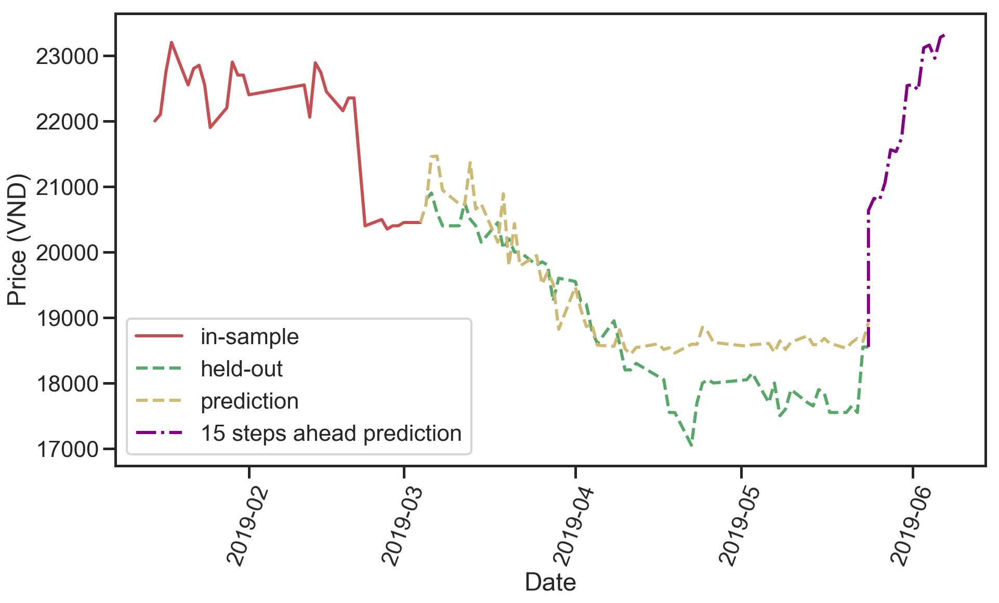

(3, 7, 3)
Testing result: {'mse': 129266.06163850013, 'rmse': 359.5358975658761, 'mae': 274.37328767705685, 'mape': 1.4488947490167137, 'lags': 3, 'hidden layers': (7, 3)}


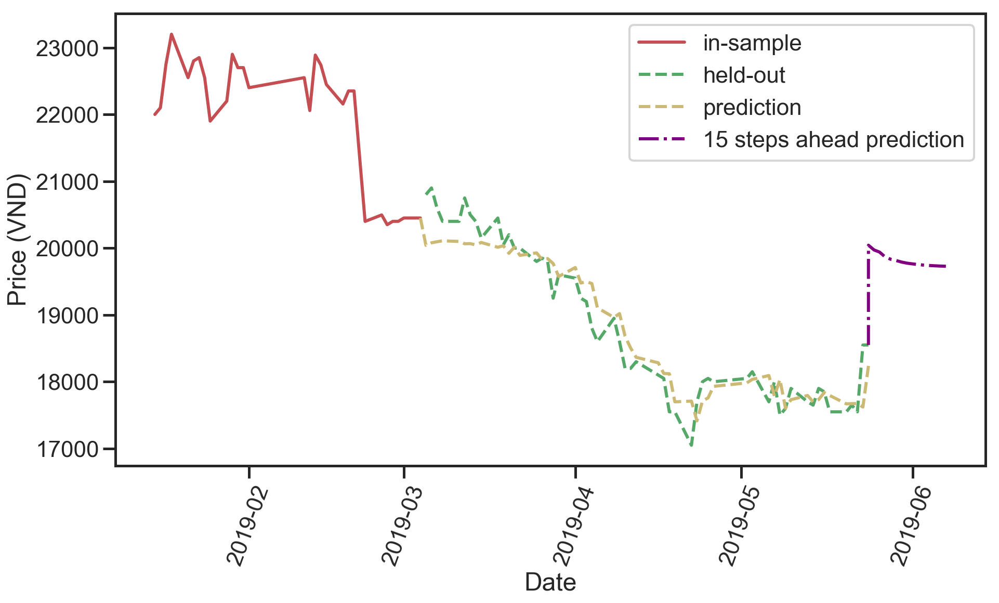

(3, 7, 3)
Testing result: {'mse': 129266.06163850013, 'rmse': 359.5358975658761, 'mae': 274.37328767705685, 'mape': 1.4488947490167137, 'lags': 3, 'hidden layers': (7, 3)}


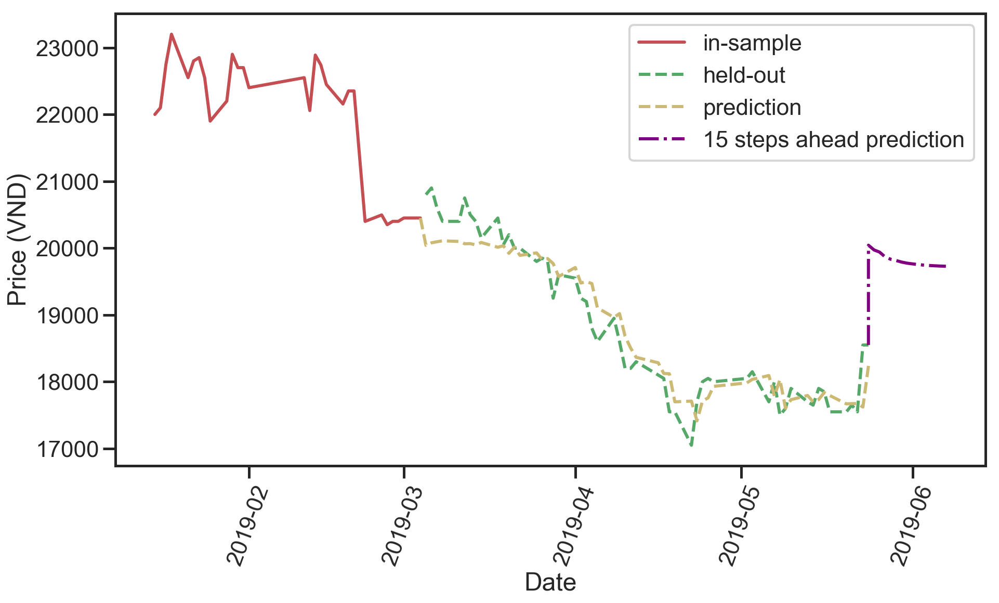

In [38]:
lags = range(1,4)
hl = range(3,8)
lst_ann_param = gen_ann(lags, hl)
lst_result = []
print(ticket)
for ann_param in lst_ann_param:
    print(ann_param)
    result = run_model_with_parameters(train, test, model_selection='ANN',
                                       lag=ann_param[0], hidden_layers=ann_param[1:])
    time.sleep(1)
    if result['status']:
        _result = result['test_evaluation']
        _result['lags'] = ann_param[0]
        _result['hidden layers'] = ann_param[1:]
        lst_result.append(_result)
        print('Testing result:', result['test_evaluation'])
        validation = result['model'].validate(test)
        predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
        fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
        ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
        ax1.plot(test, label='held-out', color='g', linestyle='--')
        ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
        ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
        plt.xticks(rotation=70)
        plt.ylabel('Price (VND)')
        plt.xlabel('Date')
        plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
#         plt.title('Model evaluation of ' + ticket)
        plt.show()
    else:
        print('None')

In [39]:
df_result = pd.DataFrame(data=lst_result)
df_result = df_result.drop_duplicates(['lags','hidden layers'], keep='first')
df_result = df_result.set_index(['lags', 'hidden layers'])
lst_metric = ['mae','mape','mse','rmse']
df_result = df_result[lst_metric].round(3)
df_result.to_csv('pnj_ann_result.csv', index=True)
df_result

mae     mape            mse       rmse
lags hidden layers                                              
1    (3, 1)        1072.44800  5.75700  1365208.34000 1168.42100
     (3, 2)         733.36200  3.87800   674963.80300  821.56200
     (3, 3)         457.27700  2.48700   282118.62400  531.14800
     (4, 1)        2374.12400 12.33500  6721493.05500 2592.58400
     (4, 2)         591.52900  3.14500   441092.15900  664.14800
     (4, 3)         259.71300  1.38500   112765.53800  335.80600
     (5, 1)        1052.86200  5.57800  1343022.57000 1158.88900
     (5, 2)         628.58700  3.41600   521919.83000  722.44000
     (5, 3)         678.39400  3.49600   738926.12000  859.60800
     (6, 1)        1307.93000  7.22900  2464171.47300 1569.76800
     (6, 2)         691.75700  3.56500   695599.99700  834.02600
     (6, 3)         211.85300  1.13700    76176.68700  276.00100
     (7, 1)         995.87000  5.24700  1240238.52600 1113.66000
     (7, 2)        1781.47000  9.60600  3328135.21900 1824.31800
     (7, 3)         247.30800  1.31600    94697.84300  307.73000
2    (3, 1)        3083.61900 15.89900 12567157.57200 3545.01900
     (3, 2)        1655.61100  8.55700  3876472.22700 1968.87600
     (3, 3)         722.30900  3.89800   665623.23200  815.85700
     (4, 1)        1294.51600  6.59700  2648685.45300 1627.47800
     (4, 2)        1479.55400  8.16700  3082424.55500 1755.68400
     (4, 3)        2178.61000 11.23800  6223487.32100 2494.69200
     (5, 1)         246.06100  1.31500   105964.16500  325.52100
     (5, 2)         512.53600  2.80900   385886.67700  621.19800
     (5, 3)         290.63600  1.55700   133853.79400  365.86000
     (6, 1)         580.29700  2.99800   538266.80900  733.66700
     (6, 2)         249.72400  1.34000    97252.25800  311.85300
     (6, 3)         280.29800  1.49100   130475.65400  361.21400
     (7, 1)        2397.15000 12.09900 10661613.59600 3265.21300
     (7, 2)         376.11700  1.98900   235565.77500  485.35100
     (7, 3)         249.33800  1.32600   101823.07100  319.09700
3    (3, 1)        1074.00800  5.70800  1379317.49400 1174.44300
     (3, 2)        1291.93300  6.57700  2720563.95800 1649.41300
     (3, 3)         579.26400  3.04000   451711.51500  672.09500
     (4, 1)         396.81600  2.11800   258657.92400  508.58400
     (4, 2)         493.52600  2.62600   357505.41300  597.91800
     (4, 3)         510.38600  2.78900   376103.36100  613.27300
     (5, 1)        1189.33700  6.13500  1932293.36600 1390.07000
     (5, 2)         608.13400  3.22900   469402.11100  685.12900
     (5, 3)        1220.98500  6.42500  1679411.26300 1295.92100
     (6, 1)        2897.46900 15.85200 10028499.86700 3166.78100
     (6, 2)        1383.85700  7.57100  2324805.17100 1524.73100
     (6, 3)         578.51700  3.06200   453787.98500  673.63800
     (7, 1)         892.18400  4.94900  1217048.84800 1103.19900
     (7, 2)         557.37700  3.03600   435056.56800  659.58800
     (7, 3)         274.37300  1.44900   129266.06200  359.53600

## Hybrid

DPM
(1, 3, 1)
Testing result: {'mse': 230738.90503019132, 'rmse': 480.3528963482903, 'mae': 421.91388629925206, 'mape': 2.2556074784684768, 'lags': 1, 'hidden layers': (3, 1)}


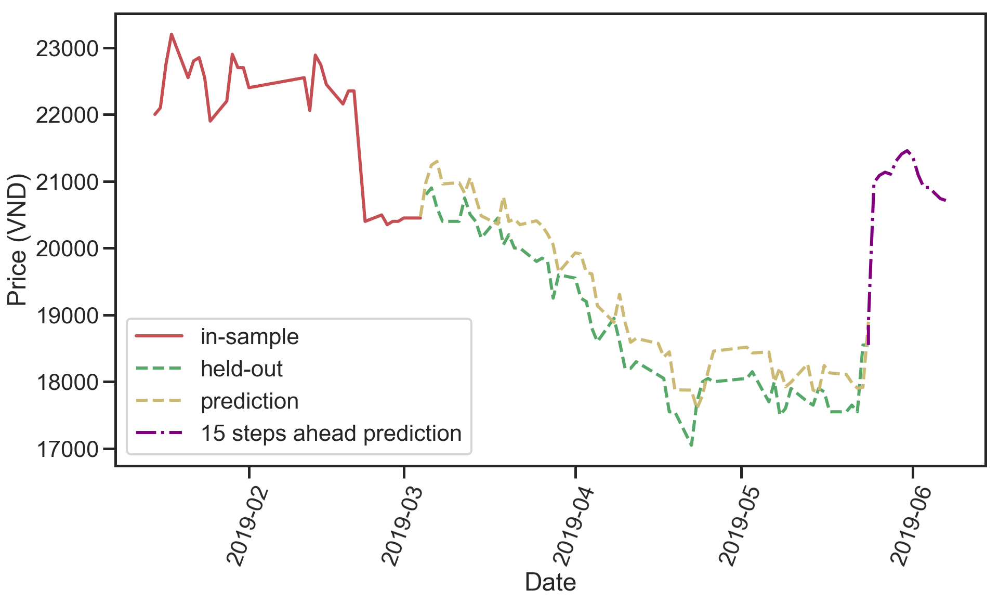

(1, 3, 2)
Testing result: {'mse': 238495.2793377404, 'rmse': 488.35978472611805, 'mae': 434.0790468930482, 'mape': 2.3204849040840565, 'lags': 1, 'hidden layers': (3, 2)}


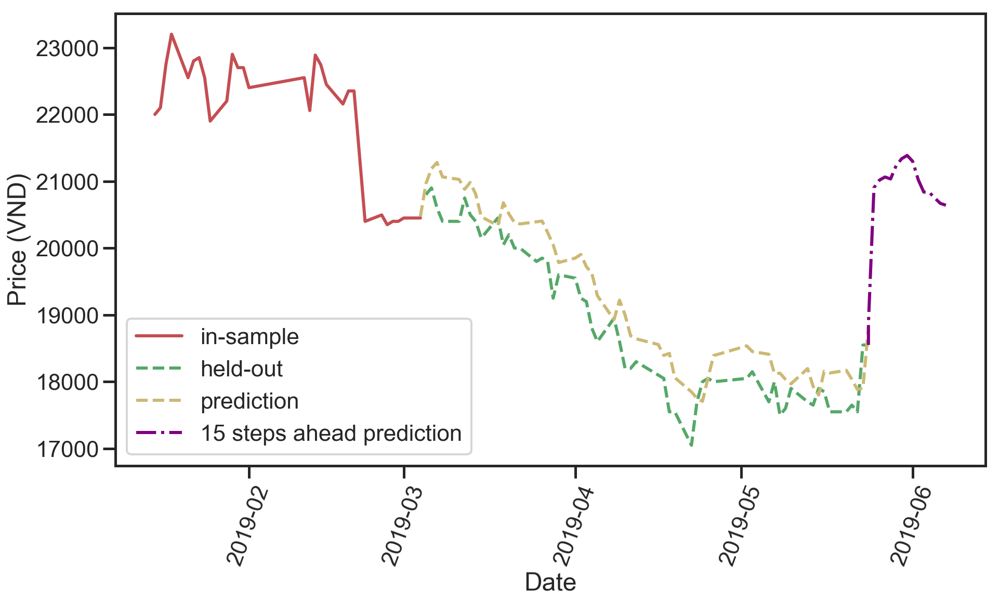

(1, 3, 2)
Testing result: {'mse': 238495.2793377404, 'rmse': 488.35978472611805, 'mae': 434.0790468930482, 'mape': 2.3204849040840565, 'lags': 1, 'hidden layers': (3, 2)}


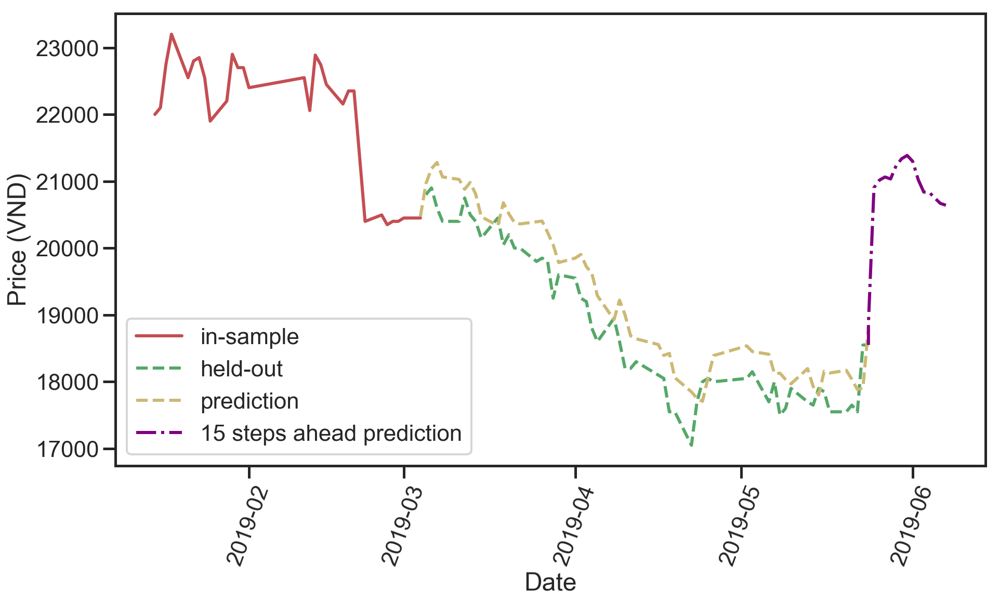

(1, 3, 3)
Testing result: {'mse': 194311.40083654274, 'rmse': 440.8076687587714, 'mae': 374.4521364579046, 'mape': 2.0025981020756616, 'lags': 1, 'hidden layers': (3, 3)}


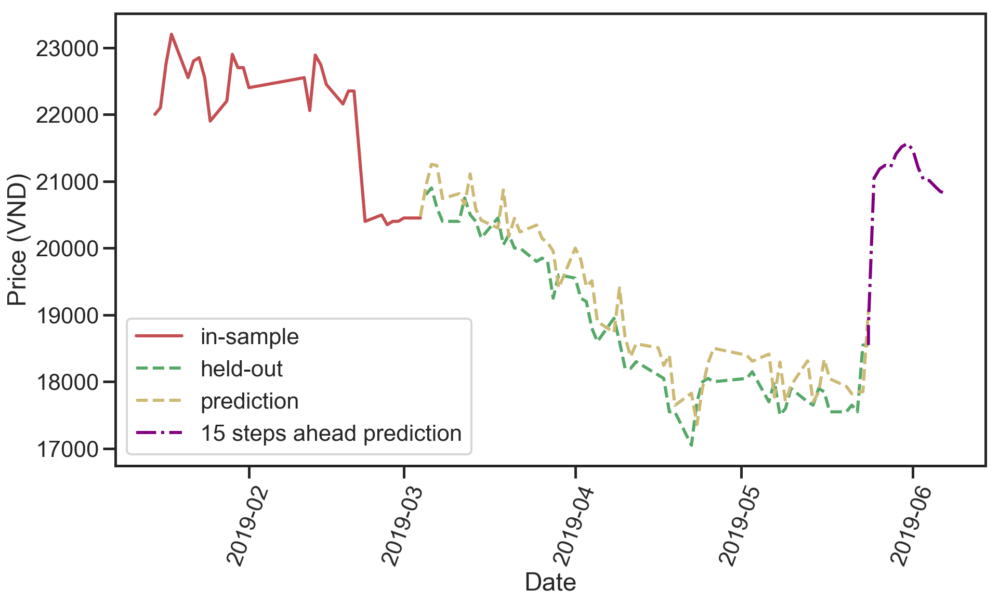

(1, 3, 3)
Testing result: {'mse': 194311.40083654274, 'rmse': 440.8076687587714, 'mae': 374.4521364579046, 'mape': 2.0025981020756616, 'lags': 1, 'hidden layers': (3, 3)}


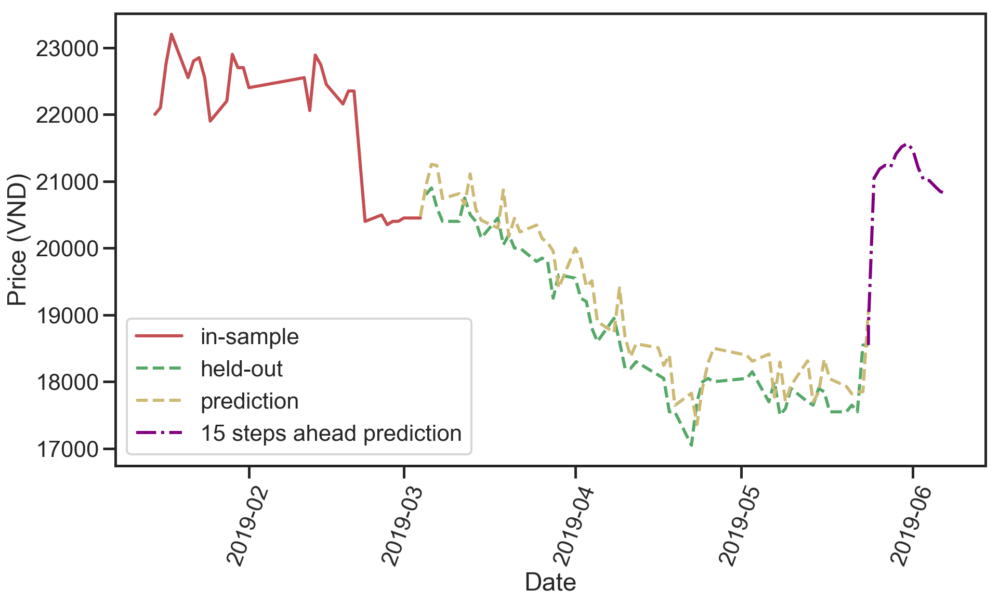

(1, 4, 1)
Testing result: {'mse': 726591.0536238368, 'rmse': 852.403105123296, 'mae': 792.8267205164659, 'mape': 4.225854512725831, 'lags': 1, 'hidden layers': (4, 1)}


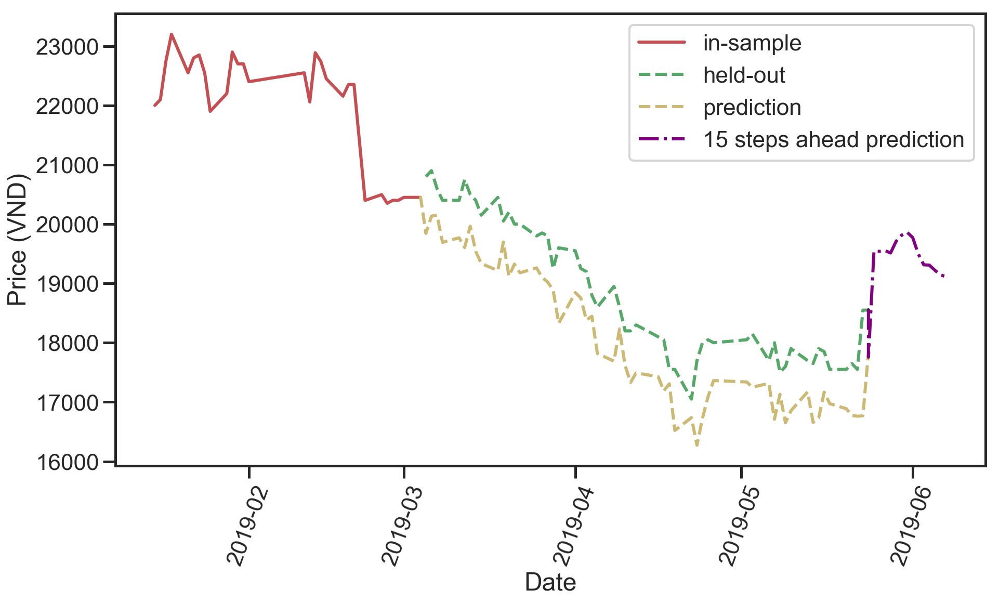

(1, 4, 2)
Testing result: {'mse': 220198.76193892414, 'rmse': 469.25340908609724, 'mae': 412.9754926609379, 'mape': 2.208073111016241, 'lags': 1, 'hidden layers': (4, 2)}


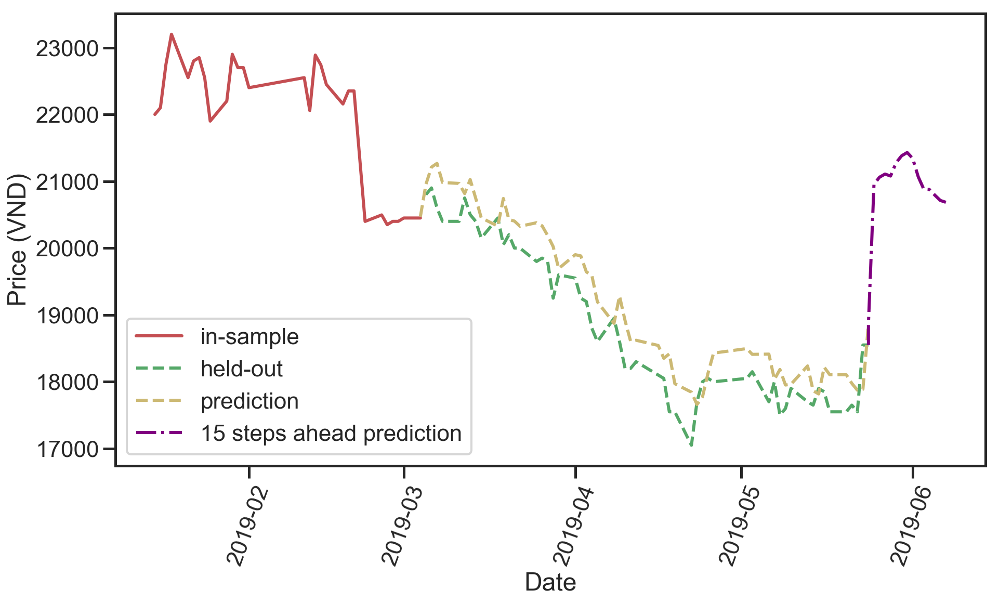

(1, 4, 2)
Testing result: {'mse': 220198.76193892414, 'rmse': 469.25340908609724, 'mae': 412.9754926609379, 'mape': 2.208073111016241, 'lags': 1, 'hidden layers': (4, 2)}


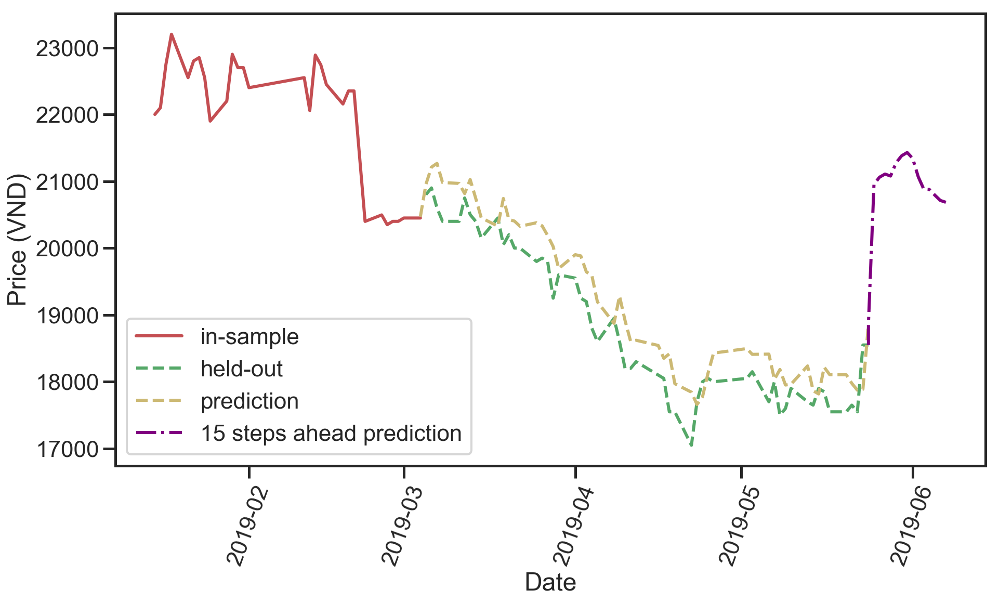

(1, 4, 3)
Testing result: {'mse': 144569.3786395412, 'rmse': 380.2228013146255, 'mae': 308.55513456016496, 'mape': 1.6537200046964093, 'lags': 1, 'hidden layers': (4, 3)}


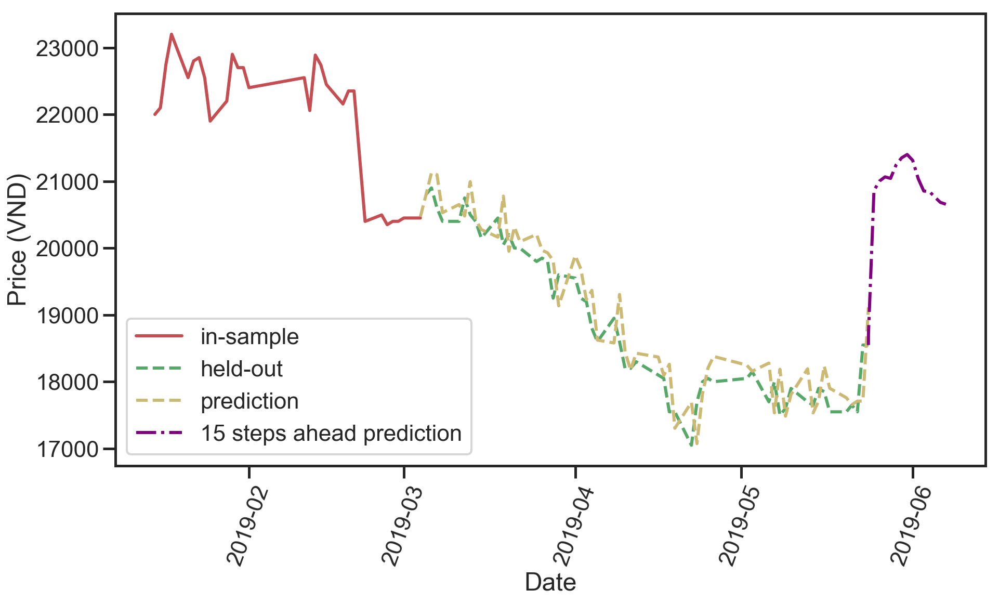

(1, 4, 3)
Testing result: {'mse': 144569.3786395412, 'rmse': 380.2228013146255, 'mae': 308.55513456016496, 'mape': 1.6537200046964093, 'lags': 1, 'hidden layers': (4, 3)}


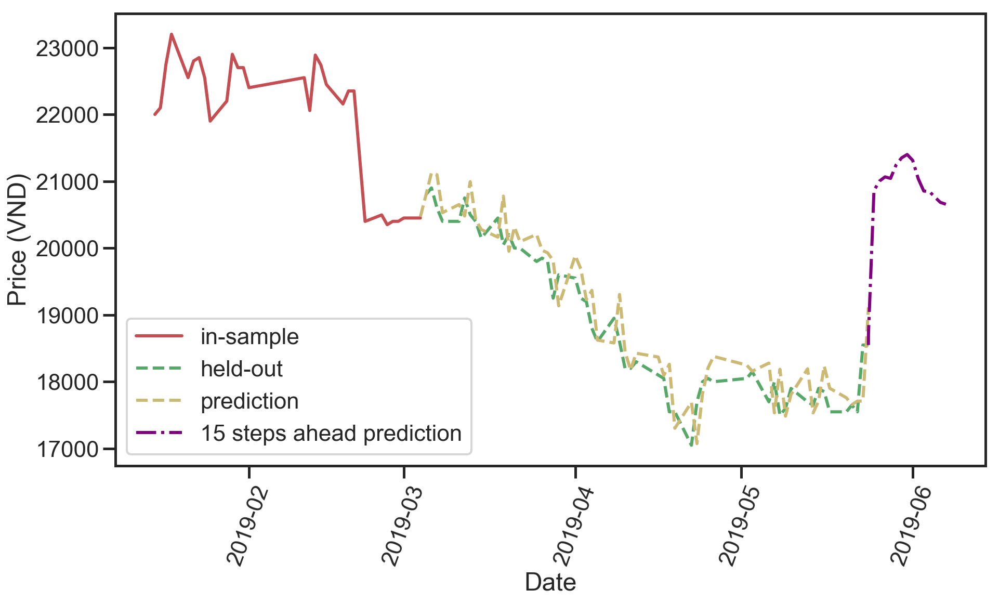

(1, 5, 1)
Testing result: {'mse': 239440.54147399424, 'rmse': 489.3266204428227, 'mae': 432.0453145226549, 'mape': 2.309002807197421, 'lags': 1, 'hidden layers': (5, 1)}


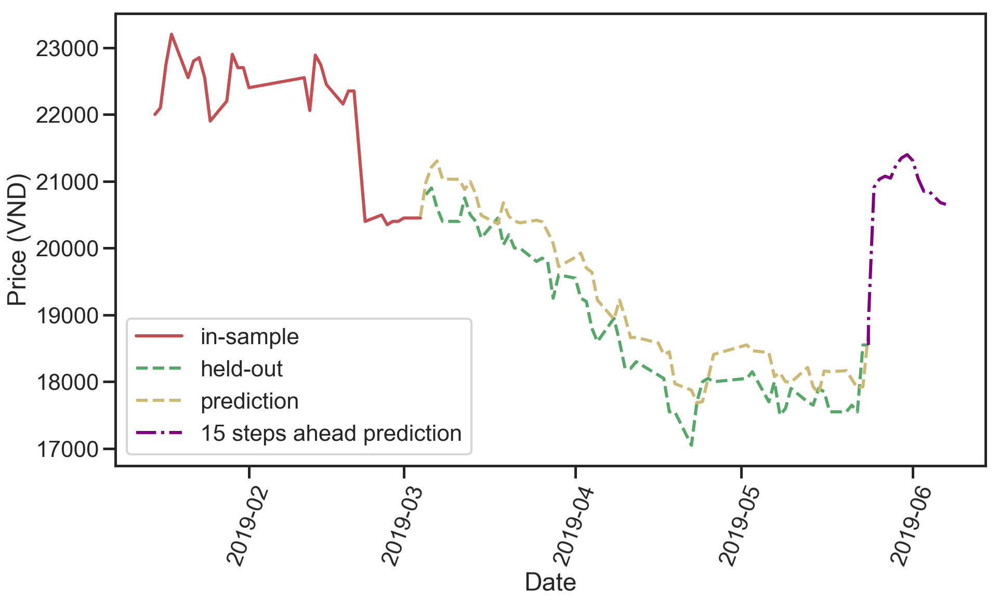

(1, 5, 2)
Testing result: {'mse': 217963.90318584442, 'rmse': 466.8660441559703, 'mae': 411.804976310333, 'mape': 2.2019862525431986, 'lags': 1, 'hidden layers': (5, 2)}


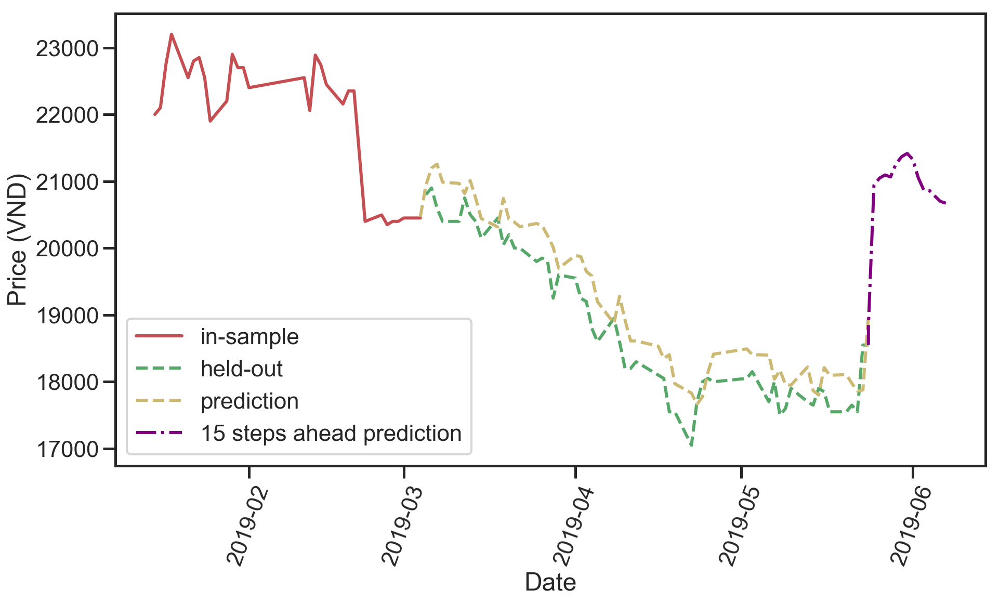

(1, 5, 2)
Testing result: {'mse': 217963.90318584442, 'rmse': 466.8660441559703, 'mae': 411.804976310333, 'mape': 2.2019862525431986, 'lags': 1, 'hidden layers': (5, 2)}


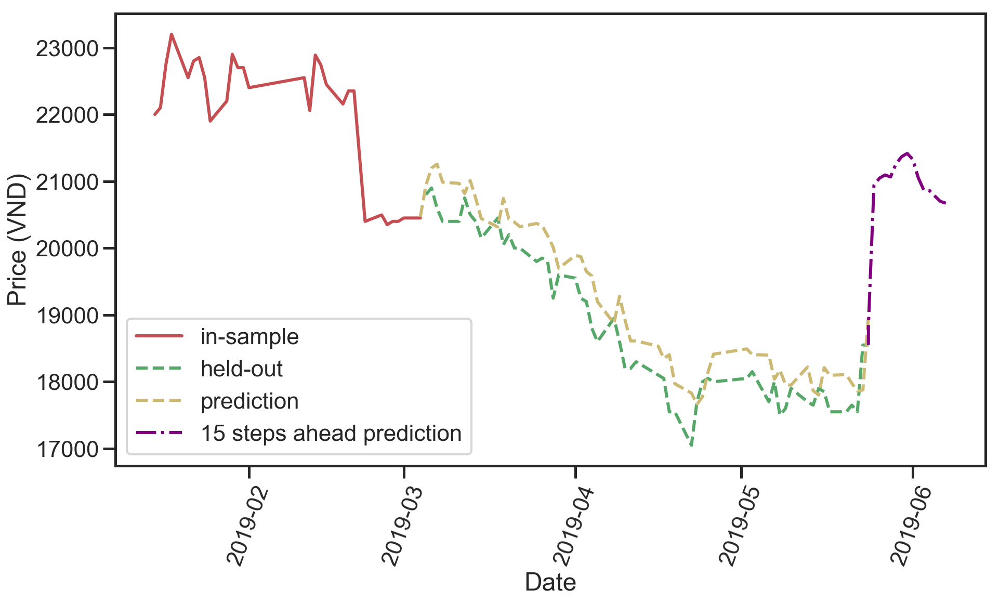

(1, 5, 3)
Testing result: {'mse': 238387.14979143863, 'rmse': 488.2490653257194, 'mae': 430.30036660927743, 'mape': 2.2997670981392506, 'lags': 1, 'hidden layers': (5, 3)}


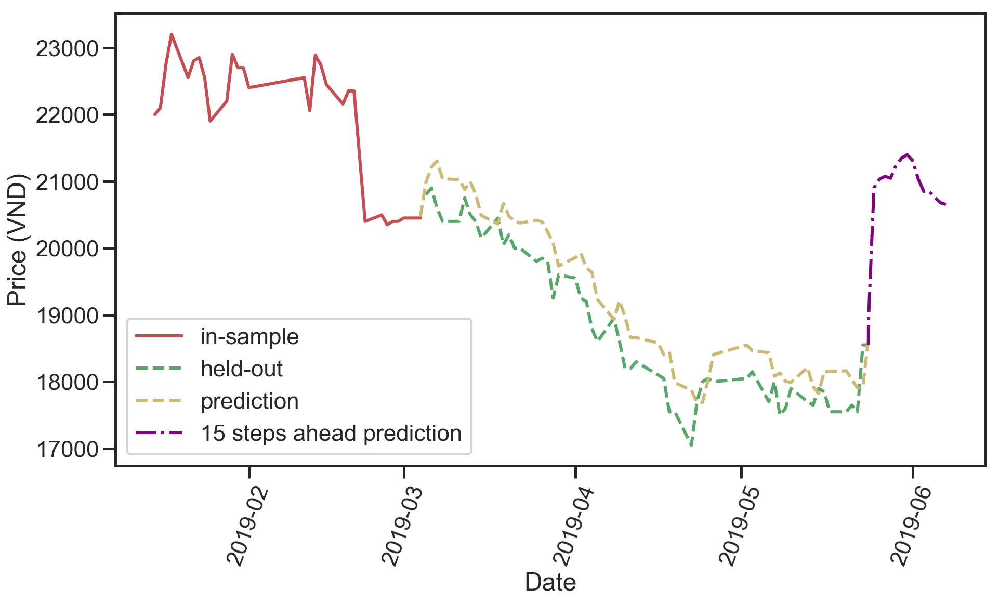

(1, 5, 3)
Testing result: {'mse': 238387.14979143863, 'rmse': 488.2490653257194, 'mae': 430.30036660927743, 'mape': 2.2997670981392506, 'lags': 1, 'hidden layers': (5, 3)}


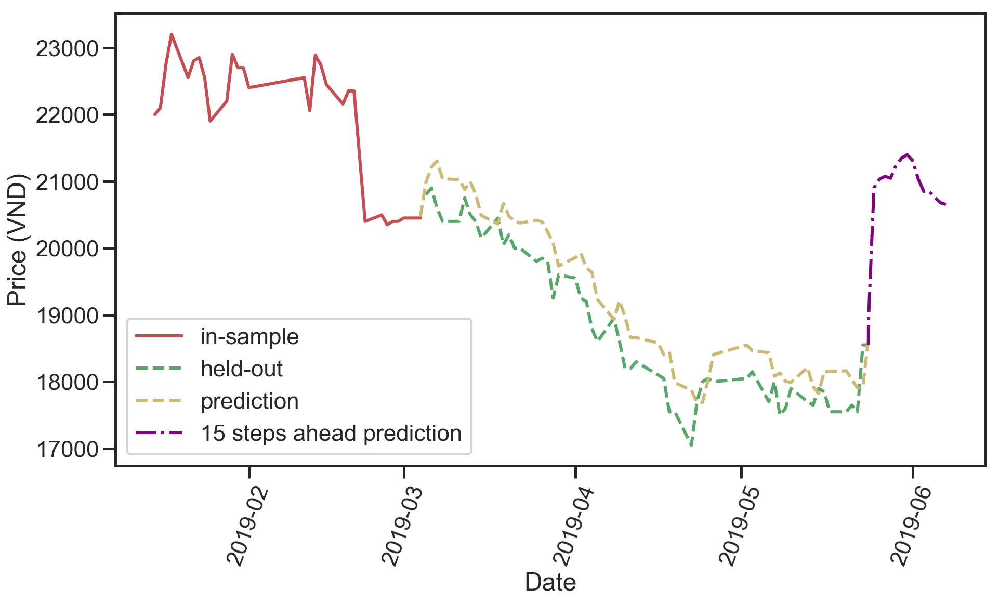

(1, 6, 1)
Testing result: {'mse': 658783.5681593731, 'rmse': 811.6548331399088, 'mae': 757.3440798118959, 'mape': 4.042819744762206, 'lags': 1, 'hidden layers': (6, 1)}


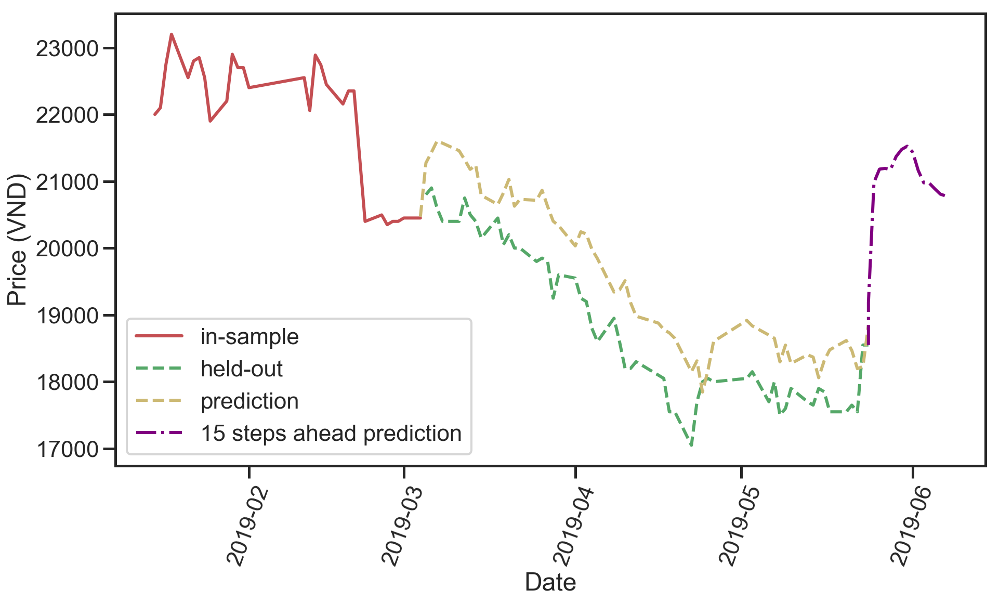

(1, 6, 2)
Testing result: {'mse': 229079.5311236607, 'rmse': 478.62253511891885, 'mae': 387.6779820899904, 'mape': 2.0748708883943126, 'lags': 1, 'hidden layers': (6, 2)}


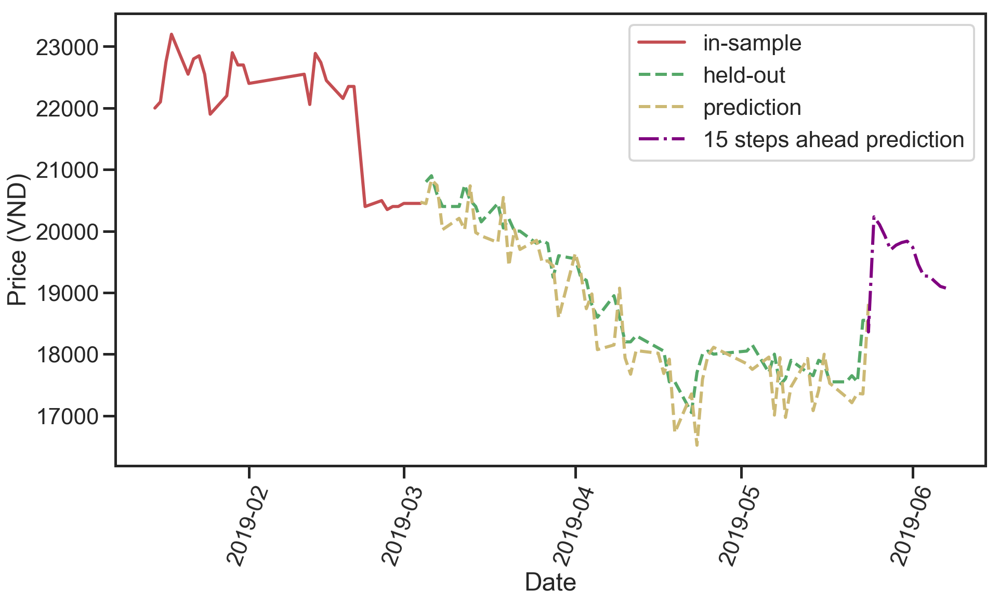

(1, 6, 2)
Testing result: {'mse': 229079.5311236607, 'rmse': 478.62253511891885, 'mae': 387.6779820899904, 'mape': 2.0748708883943126, 'lags': 1, 'hidden layers': (6, 2)}


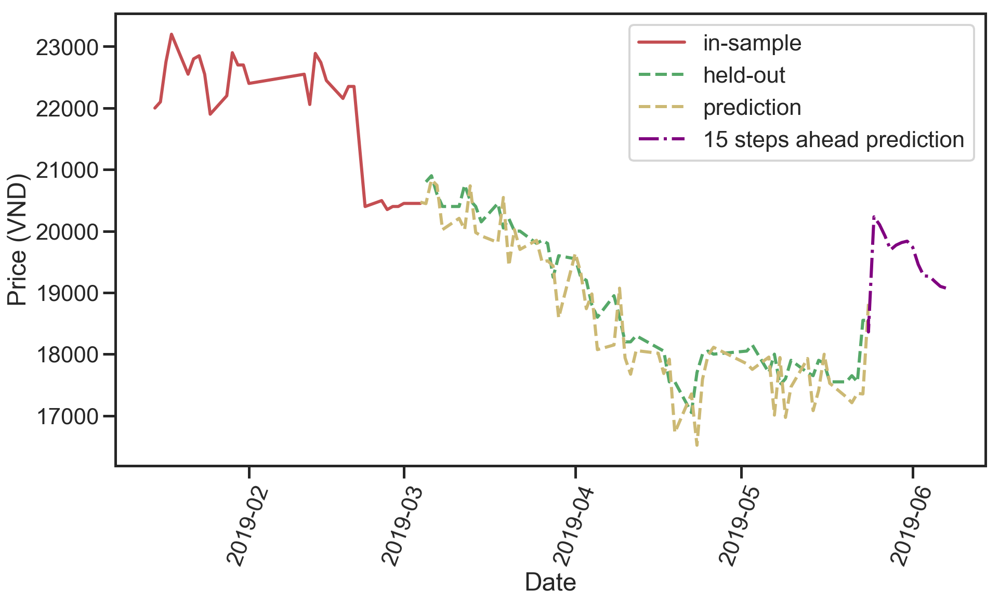

(1, 6, 3)
Testing result: {'mse': 145651.72322897505, 'rmse': 381.6434503944422, 'mae': 324.8726238877004, 'mape': 1.7387387964857373, 'lags': 1, 'hidden layers': (6, 3)}


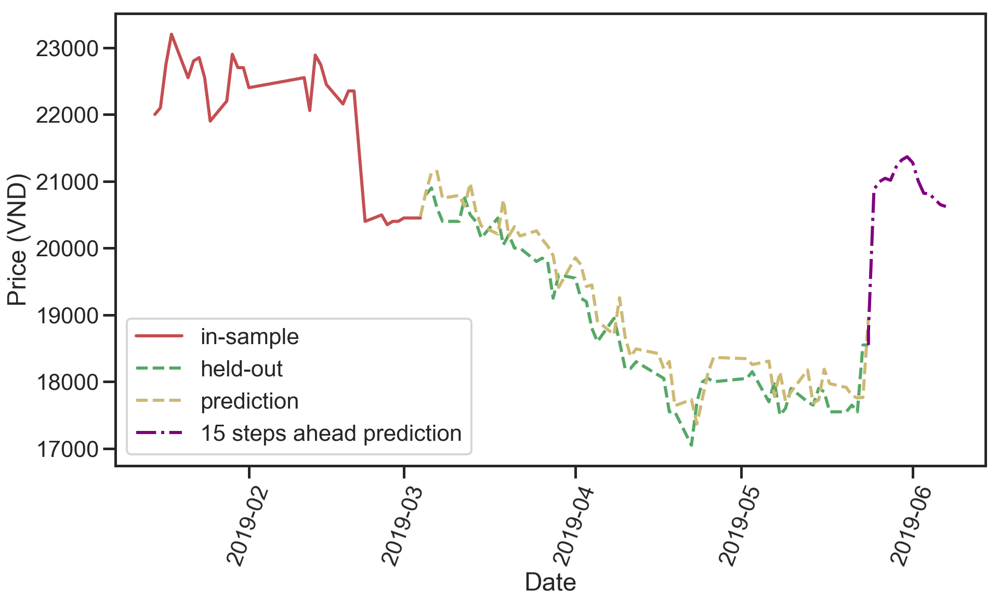

(1, 6, 3)
Testing result: {'mse': 145651.72322897505, 'rmse': 381.6434503944422, 'mae': 324.8726238877004, 'mape': 1.7387387964857373, 'lags': 1, 'hidden layers': (6, 3)}


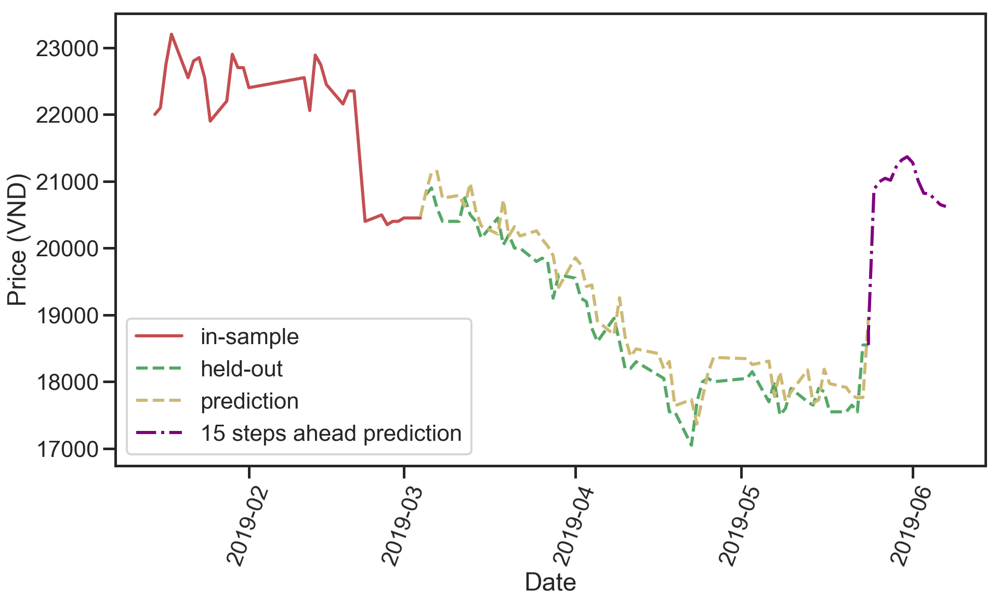

(1, 7, 1)
Testing result: {'mse': 210516.5653138342, 'rmse': 458.82084228360225, 'mae': 402.70505027423343, 'mape': 2.153243875972464, 'lags': 1, 'hidden layers': (7, 1)}


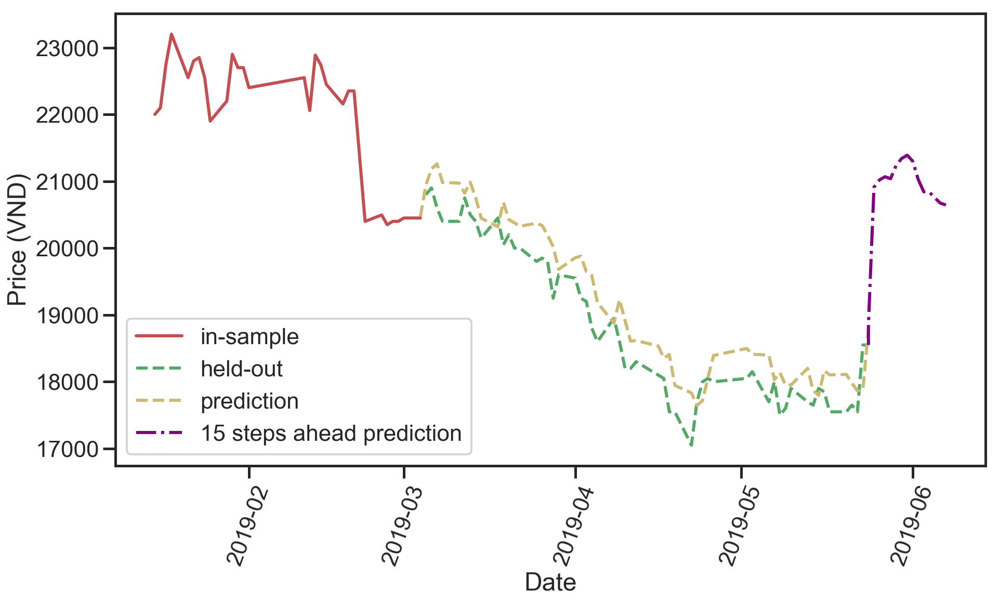

(1, 7, 2)
Testing result: {'mse': 1528591.4390427056, 'rmse': 1236.3621795585248, 'mae': 1180.810047769031, 'mape': 6.295754603404707, 'lags': 1, 'hidden layers': (7, 2)}


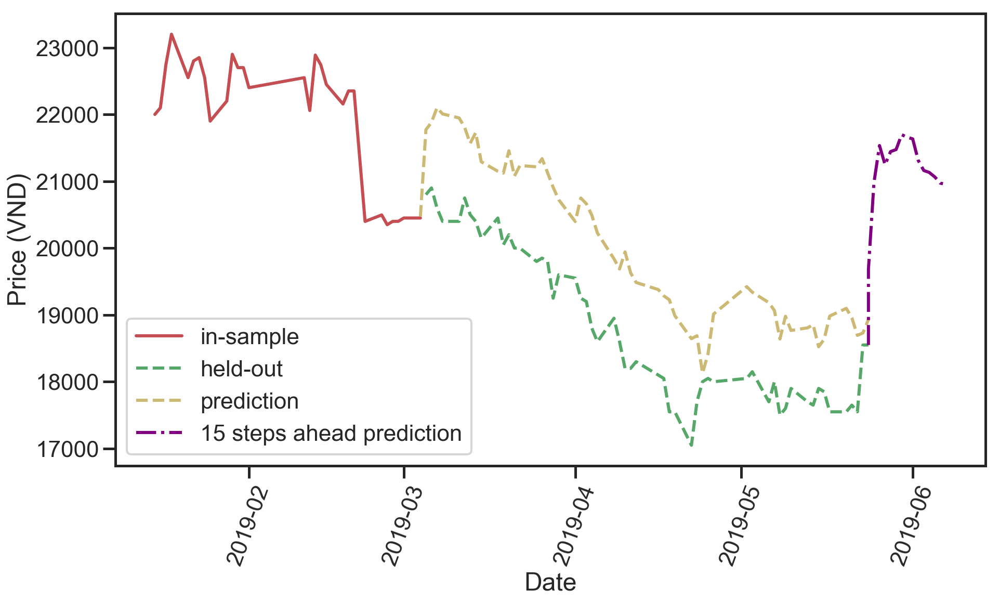

(1, 7, 2)
Testing result: {'mse': 1528591.4390427056, 'rmse': 1236.3621795585248, 'mae': 1180.810047769031, 'mape': 6.295754603404707, 'lags': 1, 'hidden layers': (7, 2)}


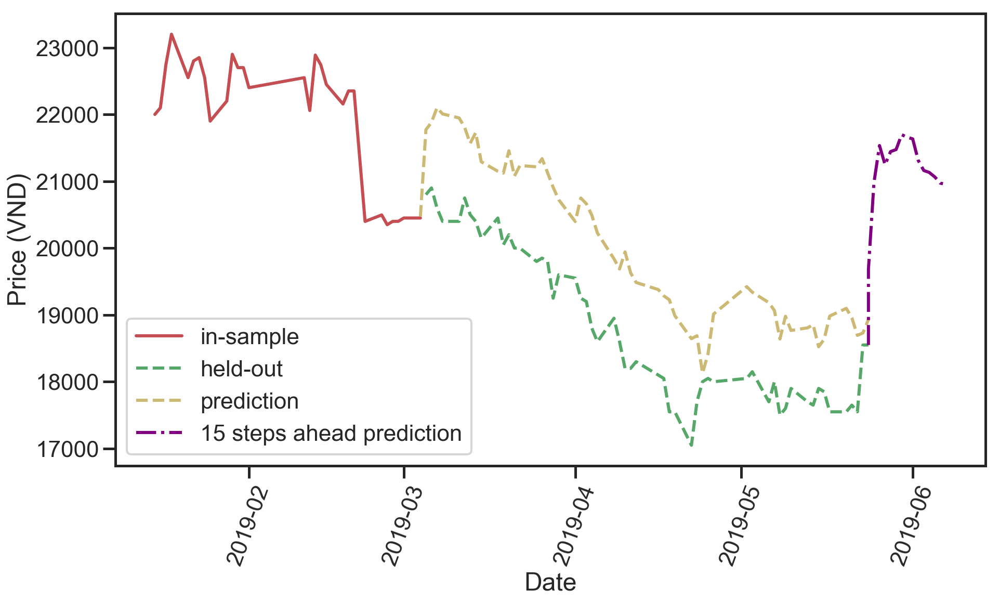

(1, 7, 3)
Testing result: {'mse': 185084.3507979455, 'rmse': 430.21430798840885, 'mae': 373.7746258985857, 'mape': 2.0003325992928462, 'lags': 1, 'hidden layers': (7, 3)}


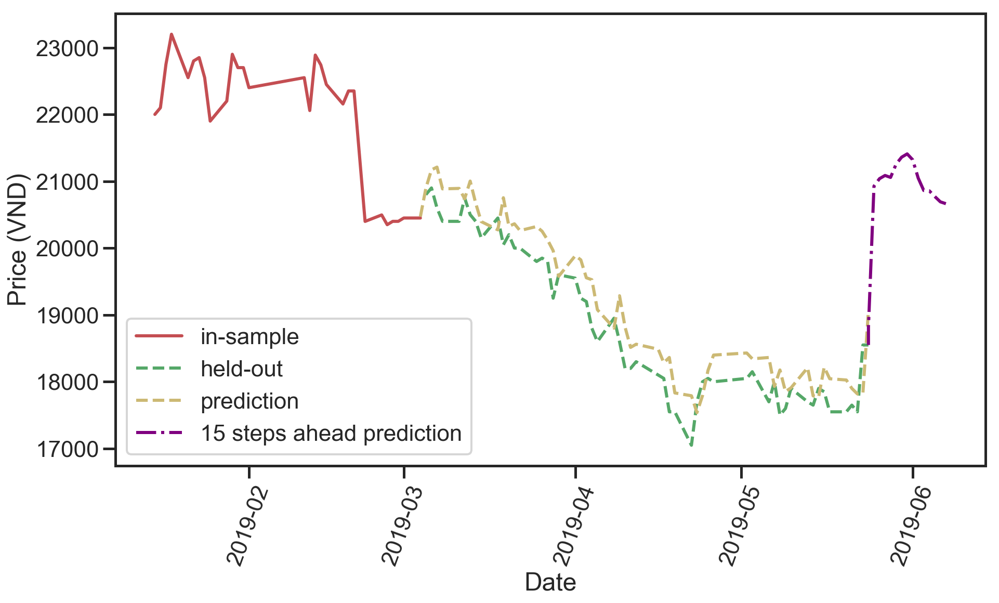

(1, 7, 3)
Testing result: {'mse': 185084.3507979455, 'rmse': 430.21430798840885, 'mae': 373.7746258985857, 'mape': 2.0003325992928462, 'lags': 1, 'hidden layers': (7, 3)}


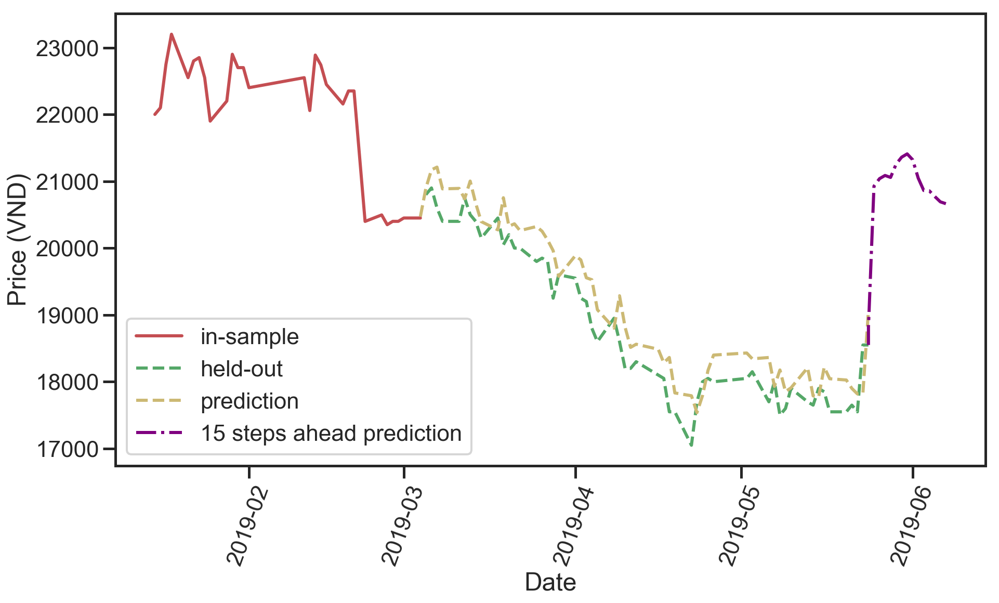

(2, 3, 1)
Testing result: {'mse': 1252253.9406637347, 'rmse': 1119.0415276761335, 'mae': 1076.8702573882222, 'mape': 5.741888303286301, 'lags': 2, 'hidden layers': (3, 1)}


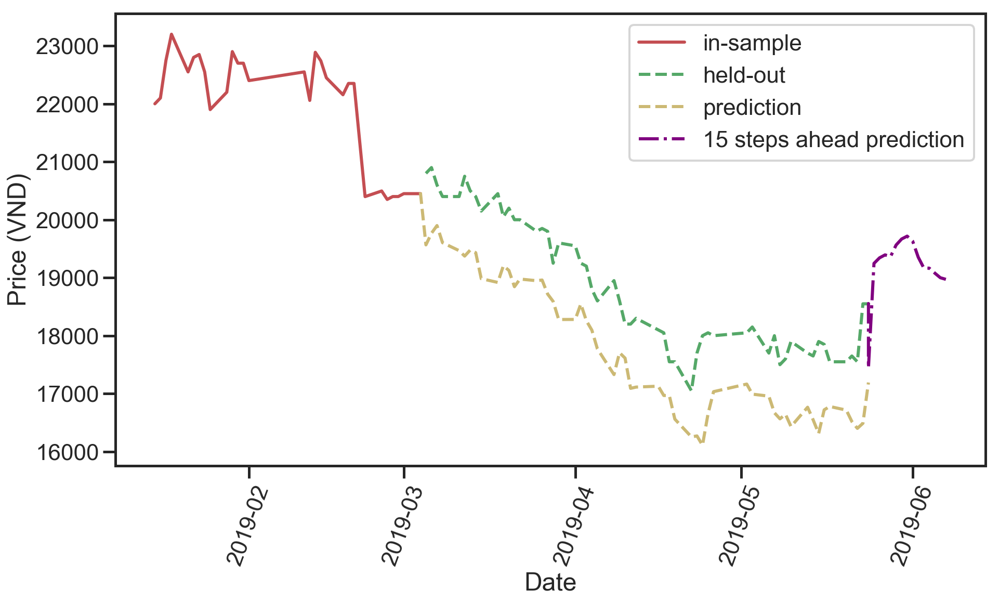

(2, 3, 2)
Testing result: {'mse': 156824.707064094, 'rmse': 396.010993615195, 'mae': 327.39236777636717, 'mape': 1.7550436628228416, 'lags': 2, 'hidden layers': (3, 2)}


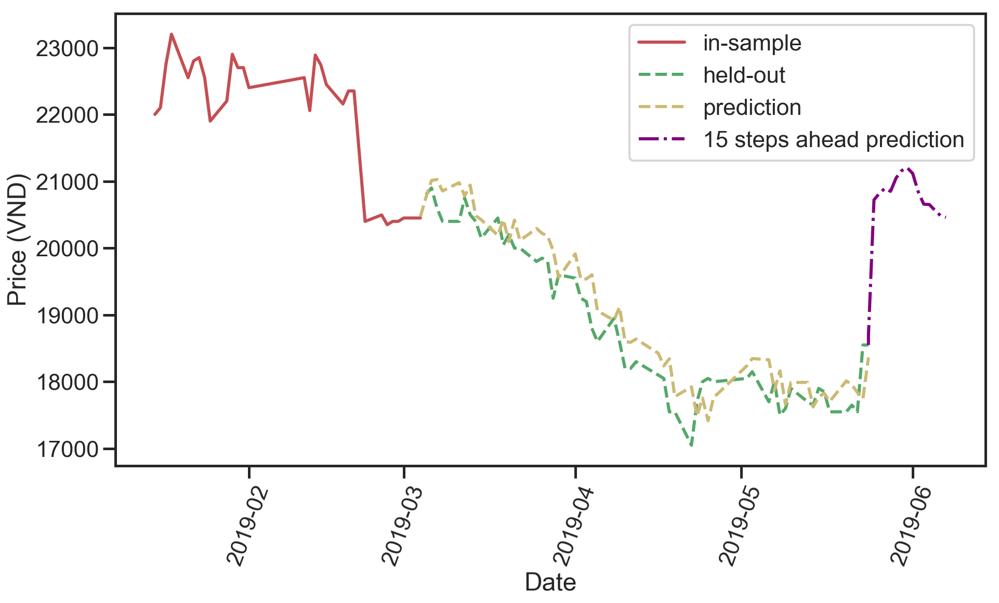

(2, 3, 2)
Testing result: {'mse': 156824.707064094, 'rmse': 396.010993615195, 'mae': 327.39236777636717, 'mape': 1.7550436628228416, 'lags': 2, 'hidden layers': (3, 2)}


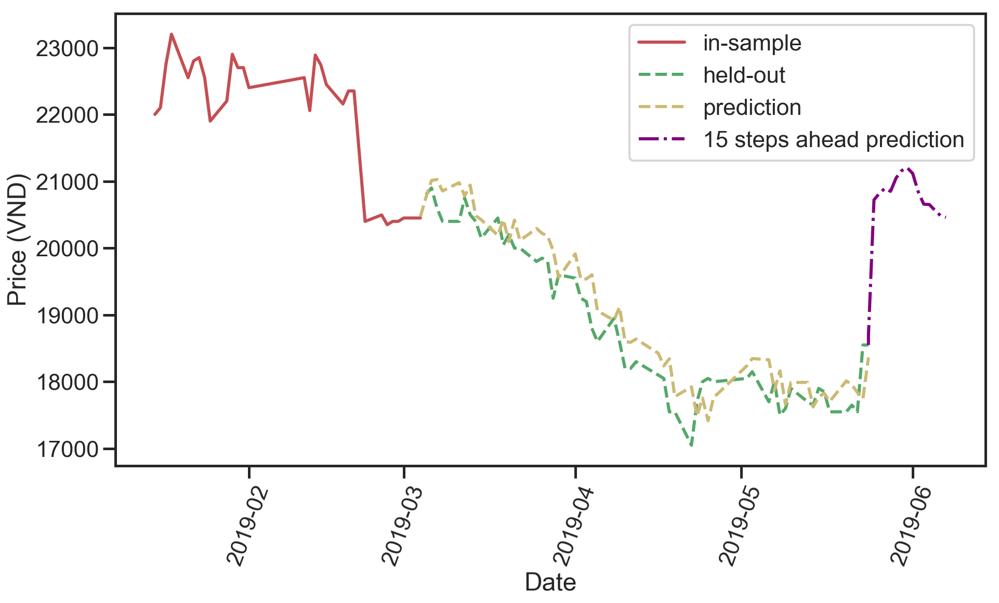

(2, 3, 3)
Testing result: {'mse': 325691.04073694465, 'rmse': 570.693473536315, 'mae': 513.8458608261211, 'mape': 2.74593933311454, 'lags': 2, 'hidden layers': (3, 3)}


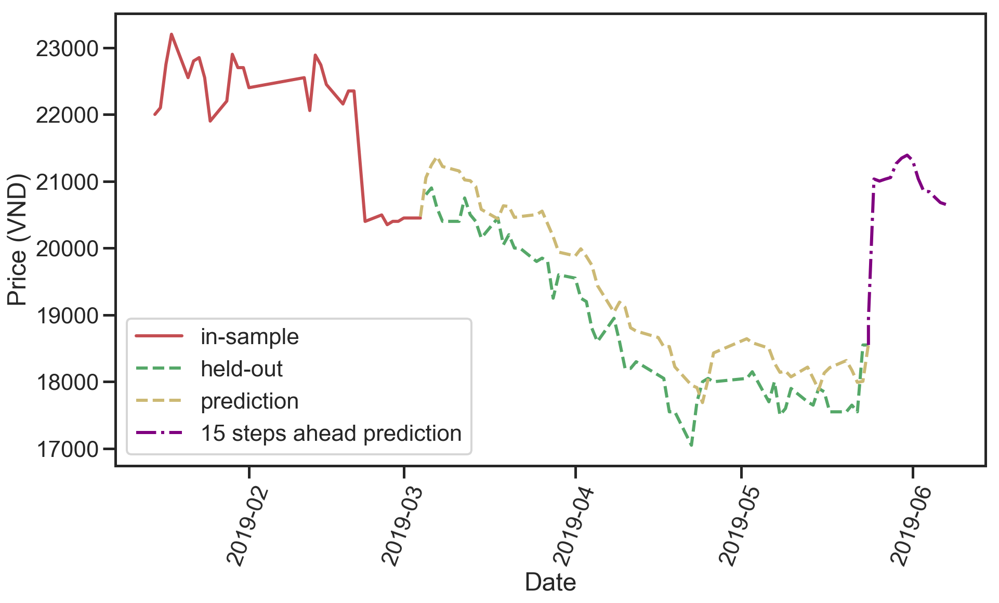

(2, 3, 3)
Testing result: {'mse': 325691.04073694465, 'rmse': 570.693473536315, 'mae': 513.8458608261211, 'mape': 2.74593933311454, 'lags': 2, 'hidden layers': (3, 3)}


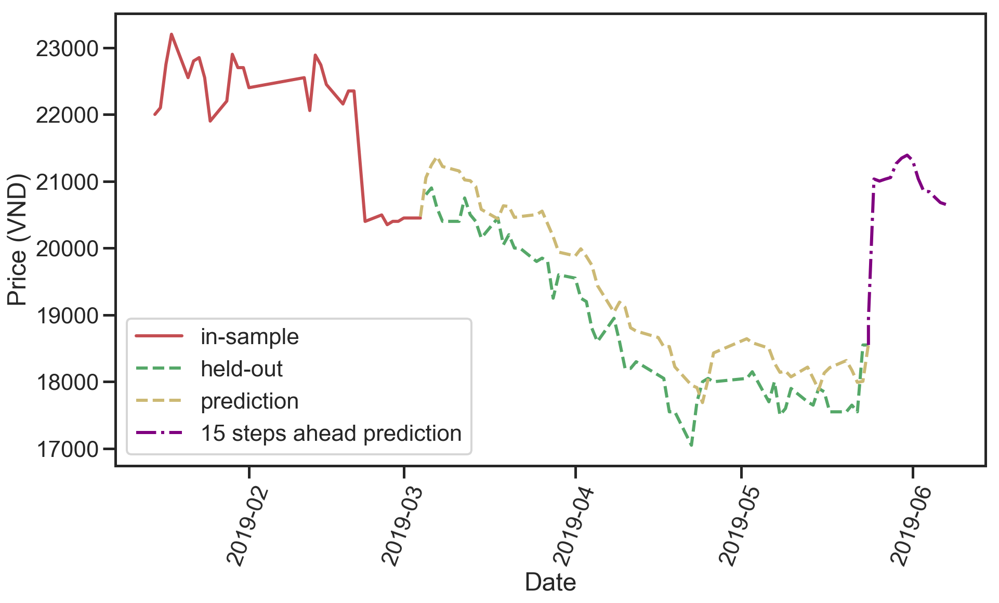

(2, 4, 1)
Testing result: {'mse': 244892.32319282216, 'rmse': 494.8659648761694, 'mae': 396.0983526186133, 'mape': 2.1121975679138387, 'lags': 2, 'hidden layers': (4, 1)}


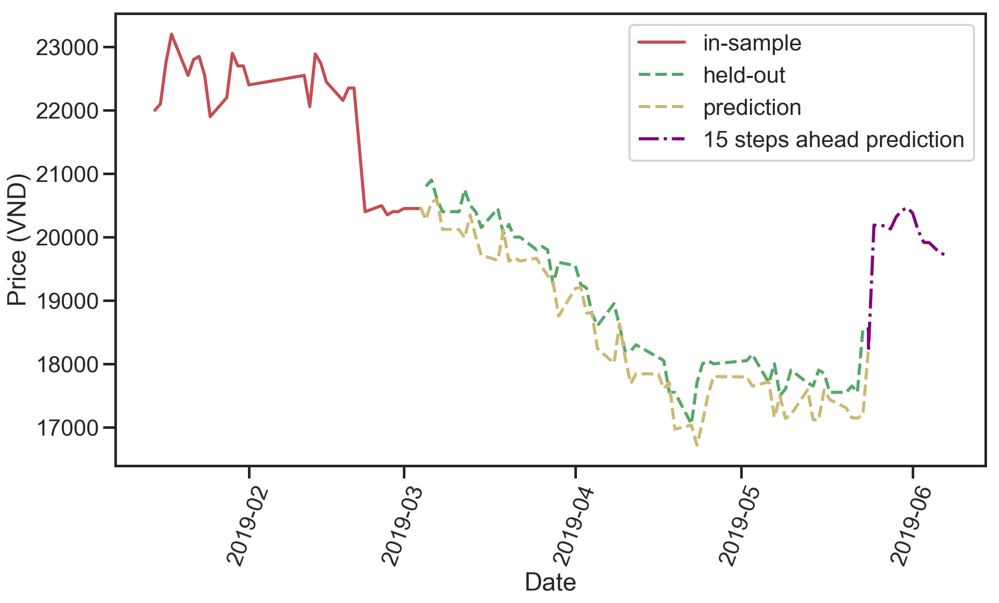

(2, 4, 2)
Testing result: {'mse': 770143.0416781299, 'rmse': 877.5779405147613, 'mae': 814.9274994181286, 'mape': 4.350229550766611, 'lags': 2, 'hidden layers': (4, 2)}


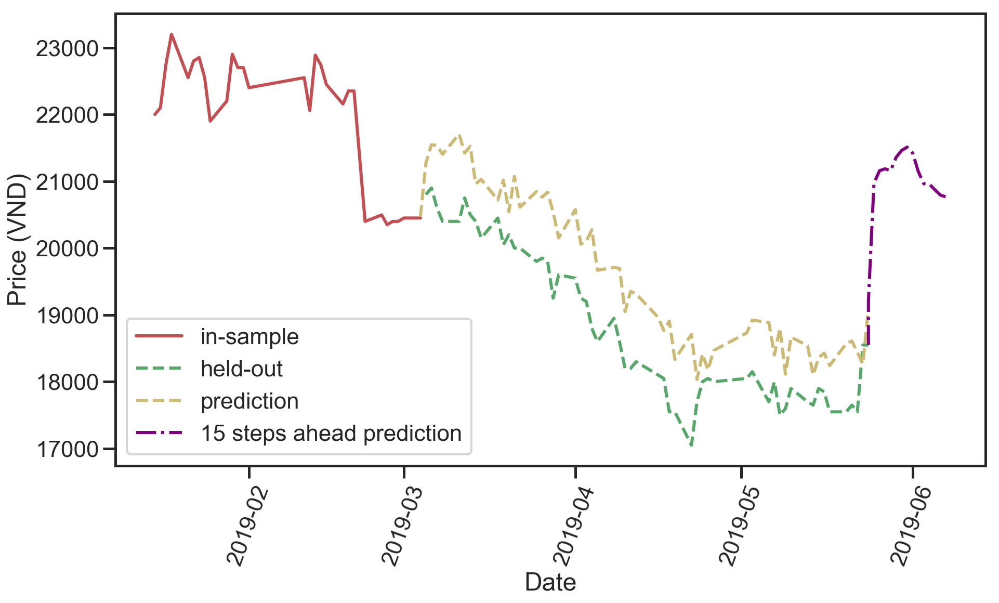

(2, 4, 2)
Testing result: {'mse': 770143.0416781299, 'rmse': 877.5779405147613, 'mae': 814.9274994181286, 'mape': 4.350229550766611, 'lags': 2, 'hidden layers': (4, 2)}


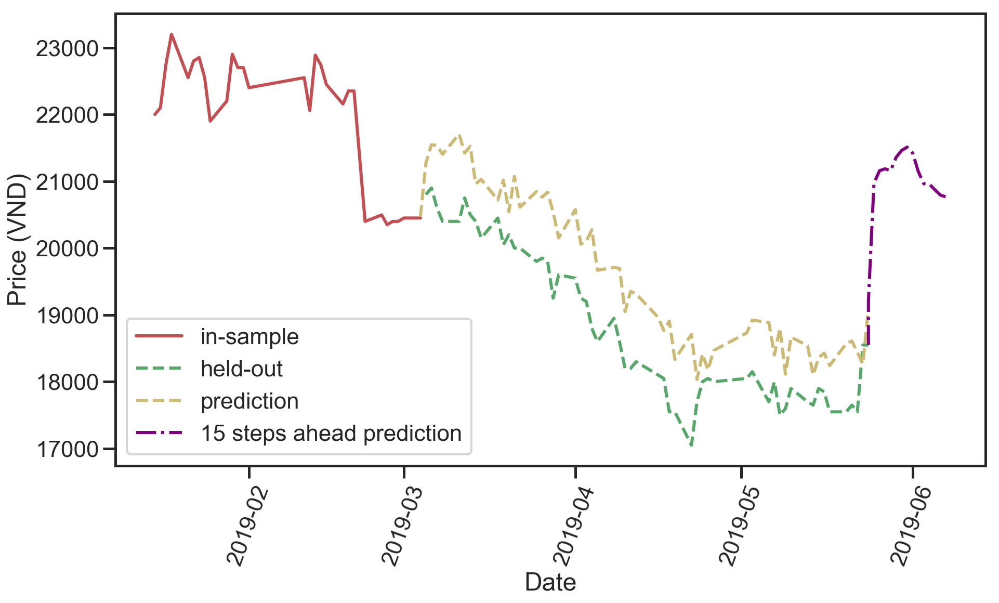

(2, 4, 3)
Testing result: {'mse': 779640.6695273074, 'rmse': 882.972632377305, 'mae': 824.3500382616587, 'mape': 4.395503663808378, 'lags': 2, 'hidden layers': (4, 3)}


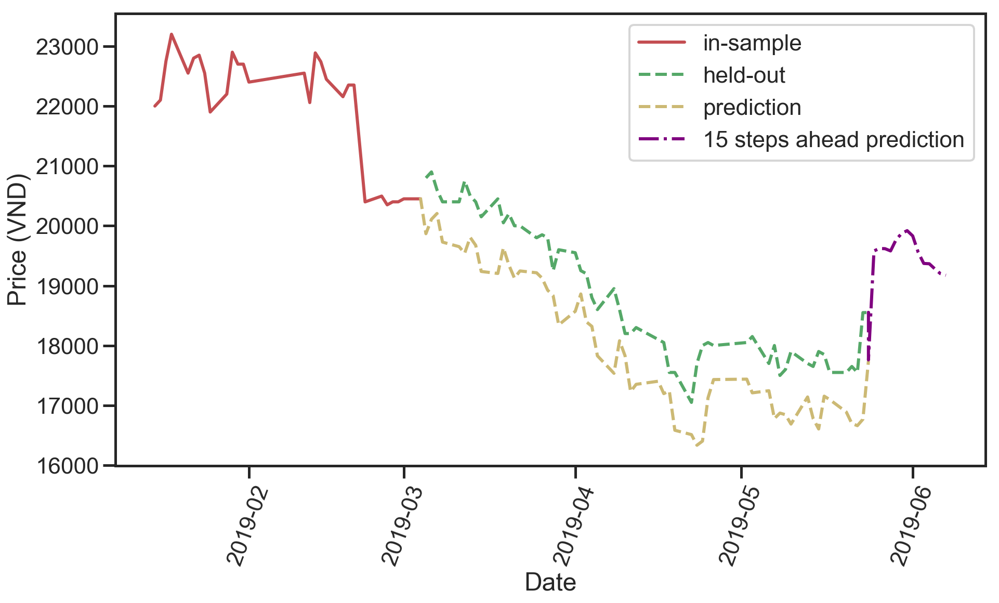

(2, 4, 3)
Testing result: {'mse': 779640.6695273074, 'rmse': 882.972632377305, 'mae': 824.3500382616587, 'mape': 4.395503663808378, 'lags': 2, 'hidden layers': (4, 3)}


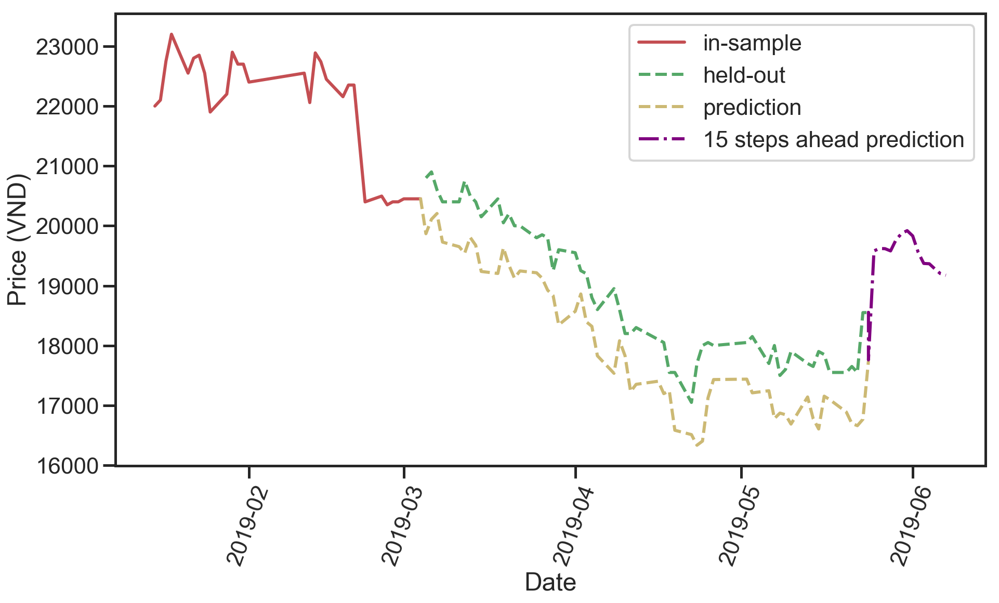

(2, 5, 1)
Testing result: {'mse': 194875.91545651475, 'rmse': 441.4475228795771, 'mae': 375.2049881071491, 'mape': 2.006827571657537, 'lags': 2, 'hidden layers': (5, 1)}


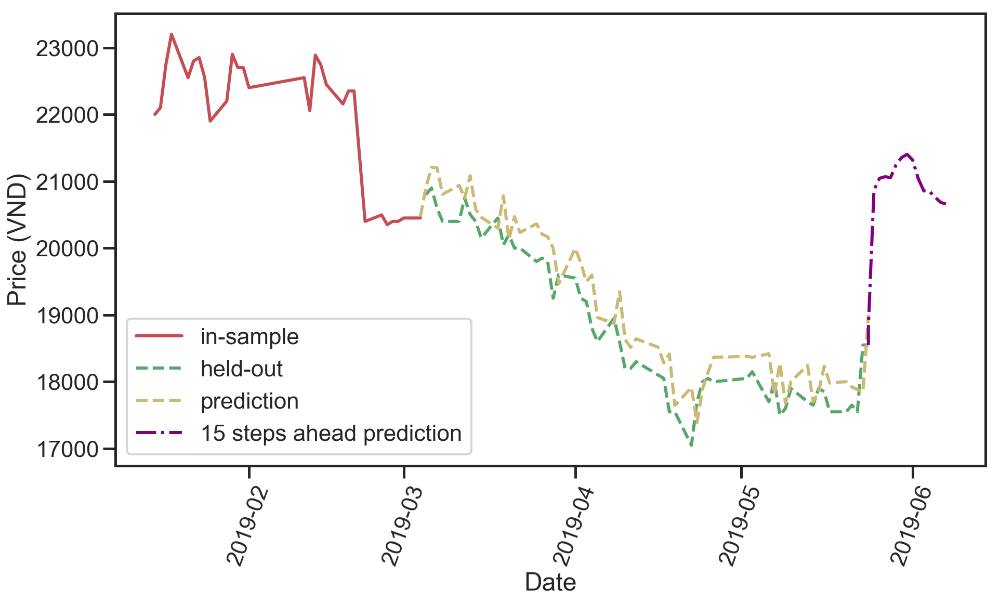

(2, 5, 2)
Testing result: {'mse': 263431.42022876145, 'rmse': 513.2557064746202, 'mae': 445.55386157215054, 'mape': 2.381554692892051, 'lags': 2, 'hidden layers': (5, 2)}


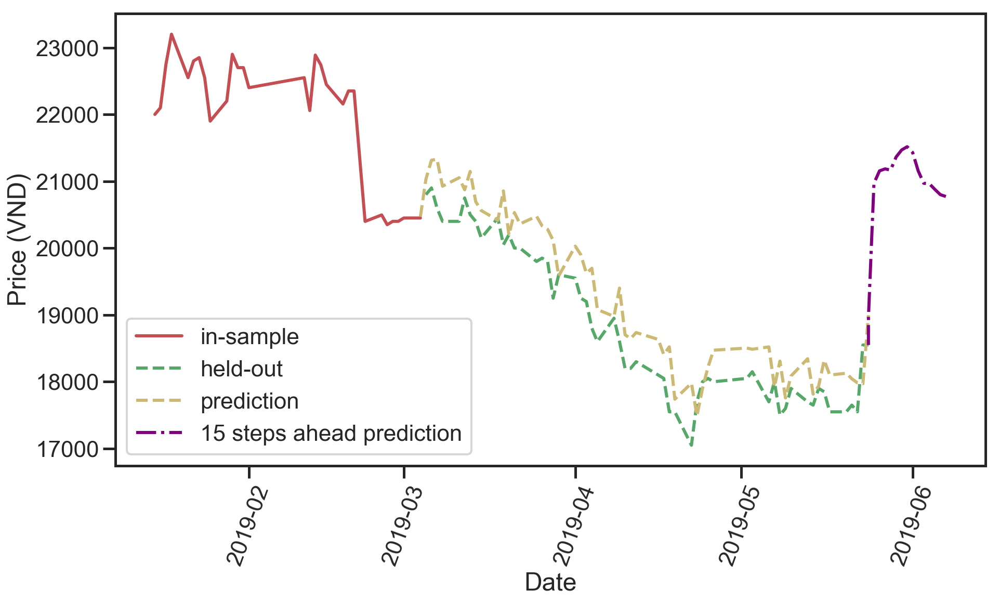

(2, 5, 2)
Testing result: {'mse': 263431.42022876145, 'rmse': 513.2557064746202, 'mae': 445.55386157215054, 'mape': 2.381554692892051, 'lags': 2, 'hidden layers': (5, 2)}


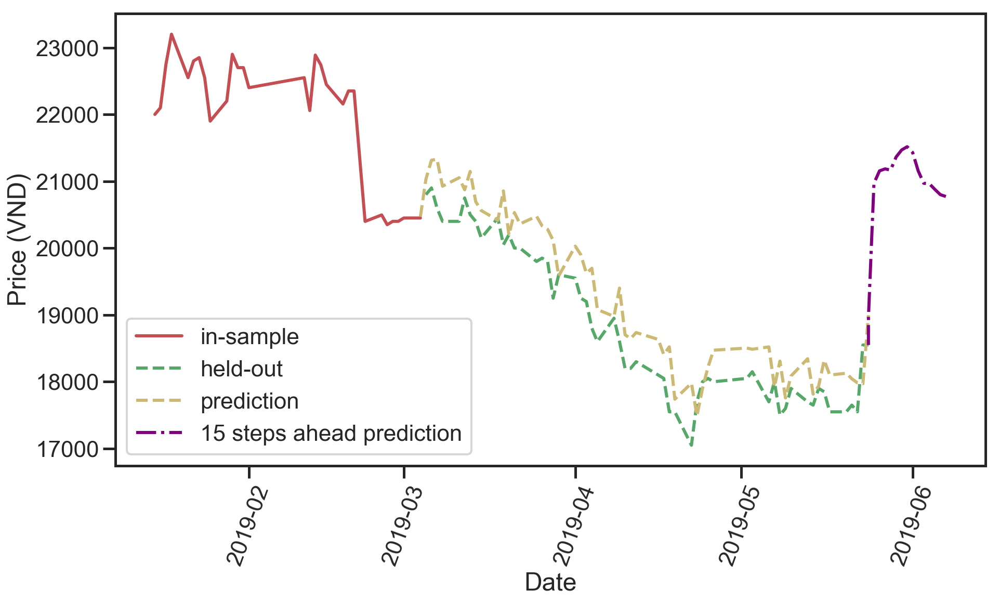

(2, 5, 3)
Testing result: {'mse': 201492.27782086167, 'rmse': 448.87891220334876, 'mae': 391.50168680785913, 'mape': 2.094157670440561, 'lags': 2, 'hidden layers': (5, 3)}


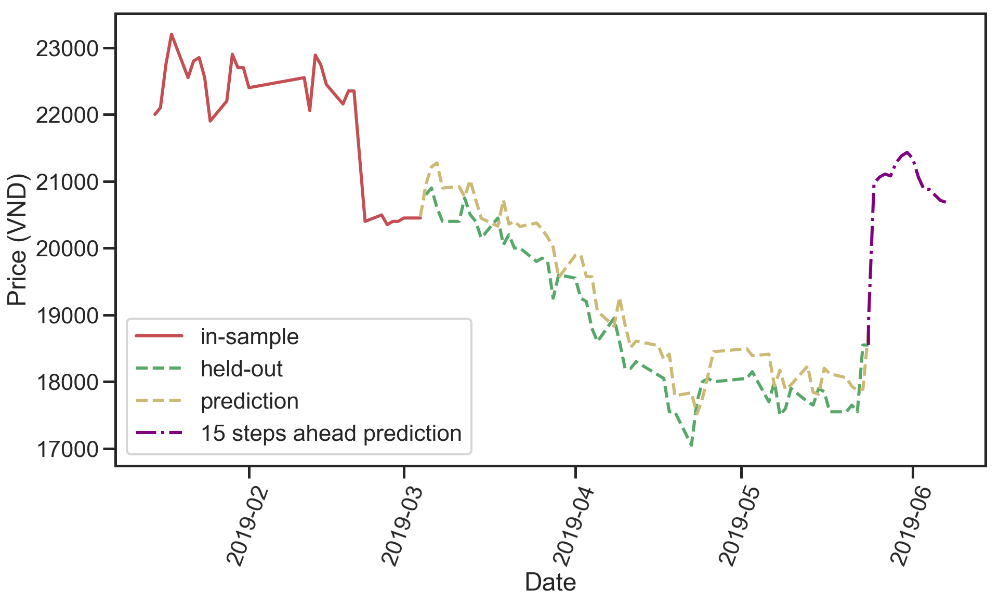

(2, 5, 3)
Testing result: {'mse': 201492.27782086167, 'rmse': 448.87891220334876, 'mae': 391.50168680785913, 'mape': 2.094157670440561, 'lags': 2, 'hidden layers': (5, 3)}


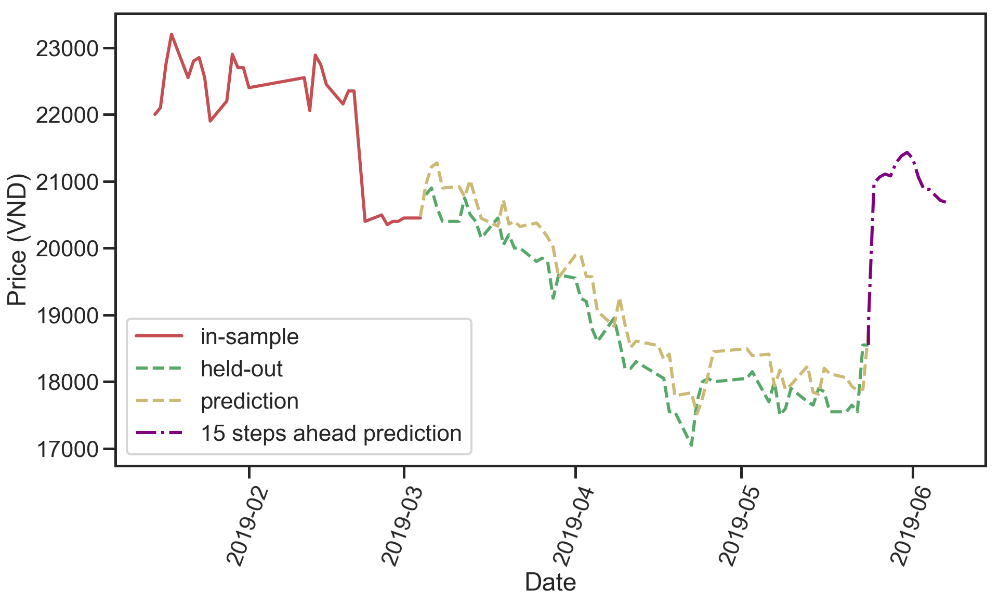

(2, 6, 1)
Testing result: {'mse': 141483.28251483085, 'rmse': 376.1426358641504, 'mae': 325.1448274017064, 'mape': 1.7415090225798484, 'lags': 2, 'hidden layers': (6, 1)}


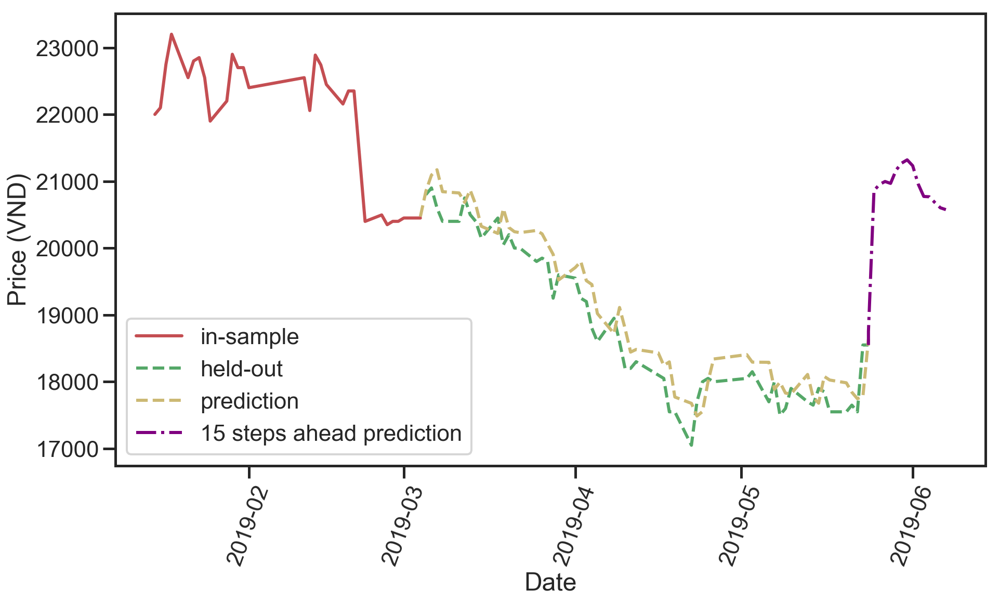

(2, 6, 2)
Testing result: {'mse': 171805.86175104888, 'rmse': 414.4947065416504, 'mae': 339.7016546238022, 'mape': 1.8166230386303575, 'lags': 2, 'hidden layers': (6, 2)}


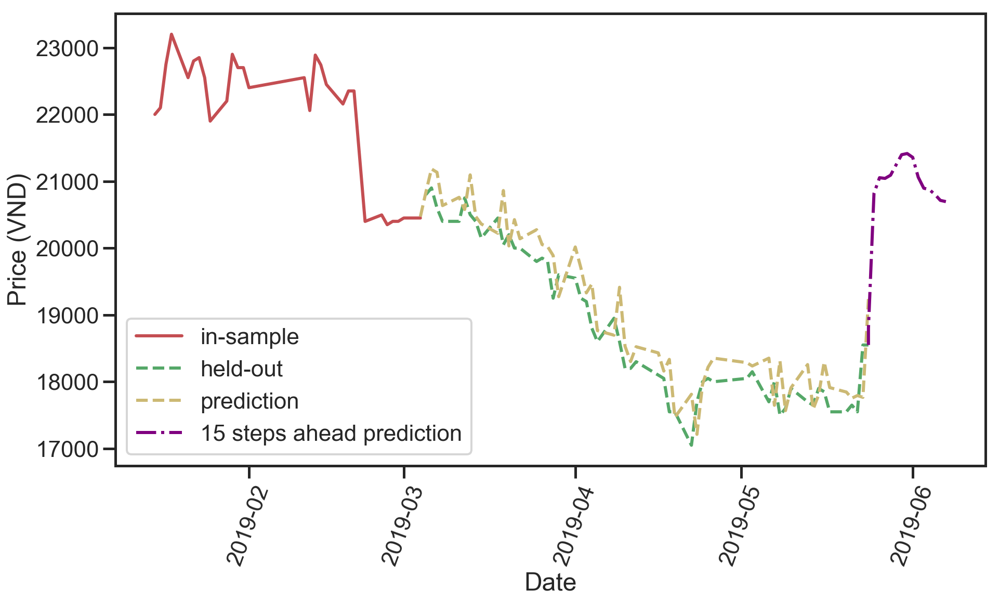

(2, 6, 2)
Testing result: {'mse': 171805.86175104888, 'rmse': 414.4947065416504, 'mae': 339.7016546238022, 'mape': 1.8166230386303575, 'lags': 2, 'hidden layers': (6, 2)}


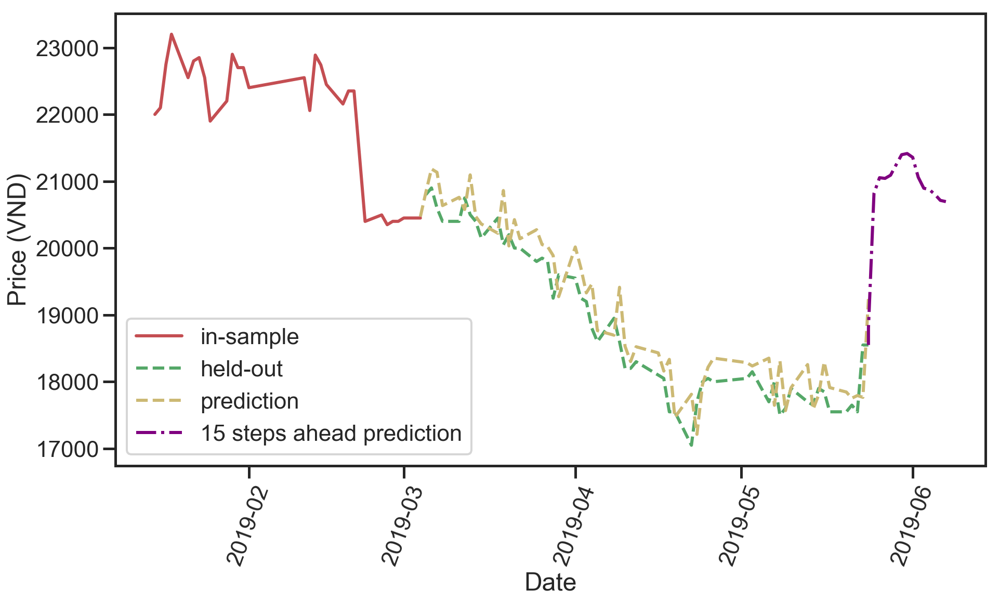

(2, 6, 3)
Testing result: {'mse': 162028.91058125635, 'rmse': 402.52814880608827, 'mae': 351.58038982850894, 'mape': 1.8820595852913518, 'lags': 2, 'hidden layers': (6, 3)}


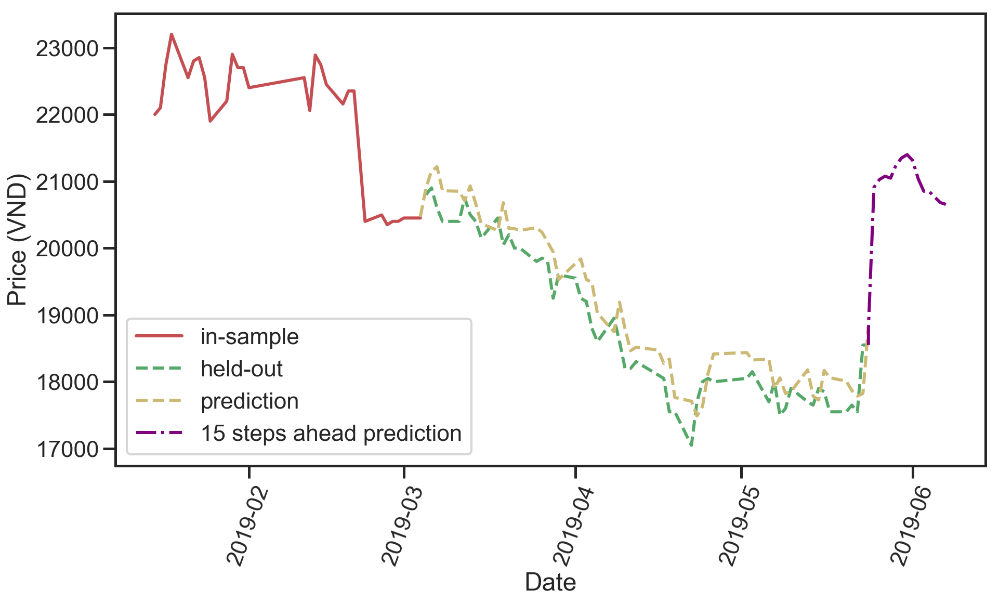

(2, 6, 3)
Testing result: {'mse': 162028.91058125635, 'rmse': 402.52814880608827, 'mae': 351.58038982850894, 'mape': 1.8820595852913518, 'lags': 2, 'hidden layers': (6, 3)}


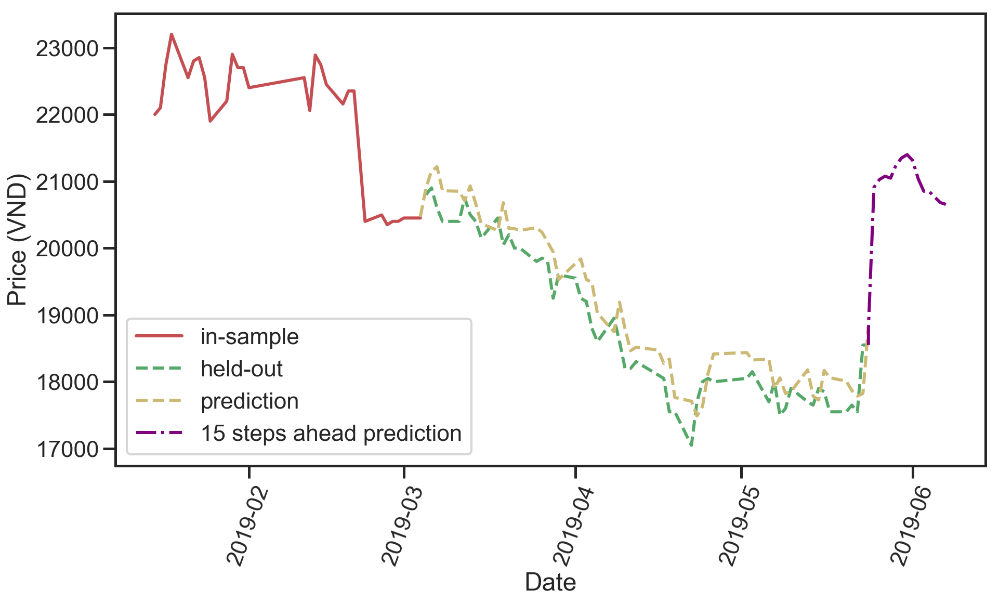

(2, 7, 1)
Testing result: {'mse': 1318908.712827234, 'rmse': 1148.4375093261426, 'mae': 1069.1336094476721, 'mape': 5.697243359890829, 'lags': 2, 'hidden layers': (7, 1)}


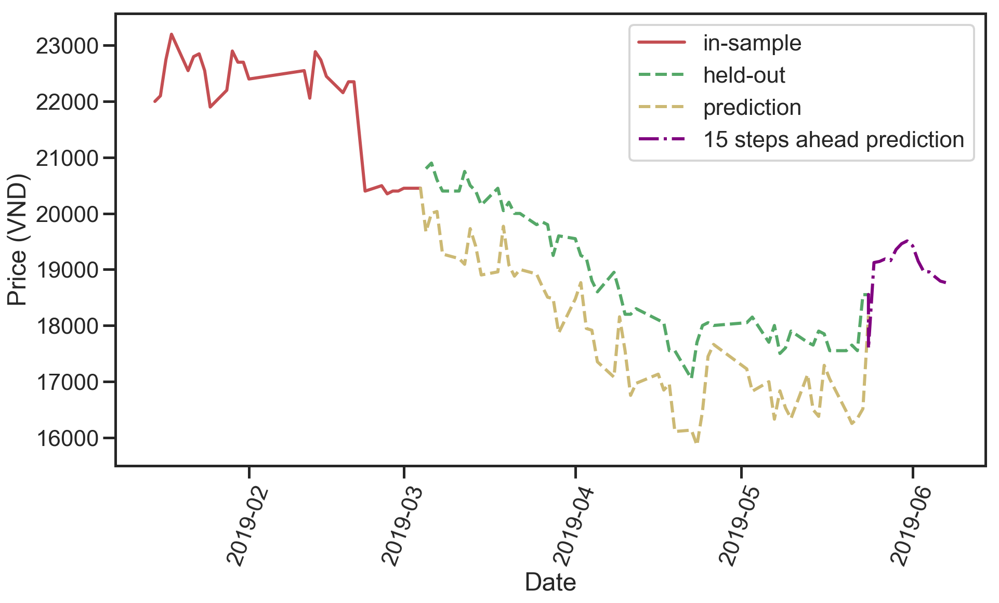

(2, 7, 2)
Testing result: {'mse': 158112.99031730962, 'rmse': 397.6342418822977, 'mae': 346.06933642716956, 'mape': 1.8512455908769223, 'lags': 2, 'hidden layers': (7, 2)}


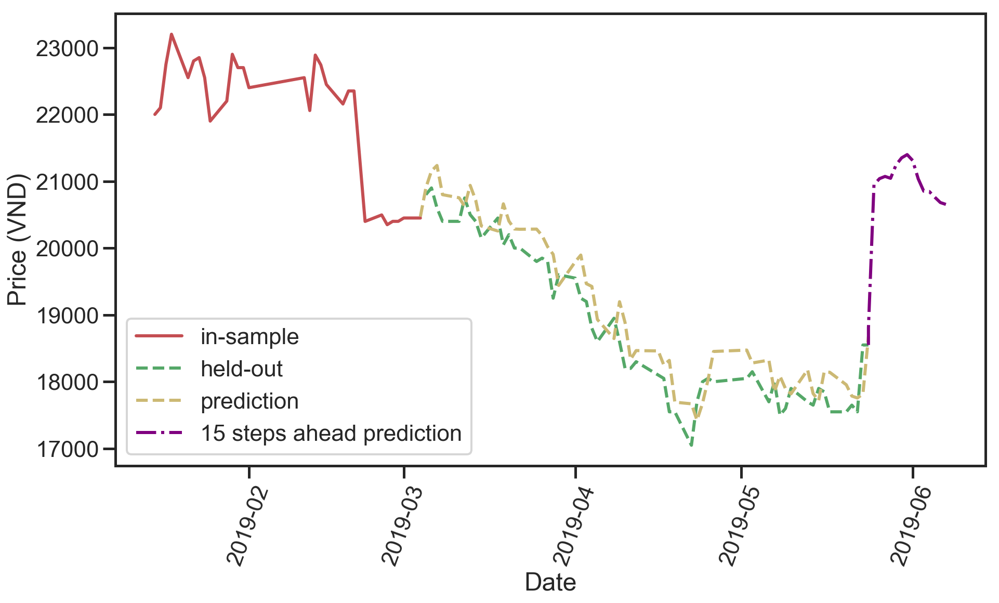

(2, 7, 2)
Testing result: {'mse': 158112.99031730962, 'rmse': 397.6342418822977, 'mae': 346.06933642716956, 'mape': 1.8512455908769223, 'lags': 2, 'hidden layers': (7, 2)}


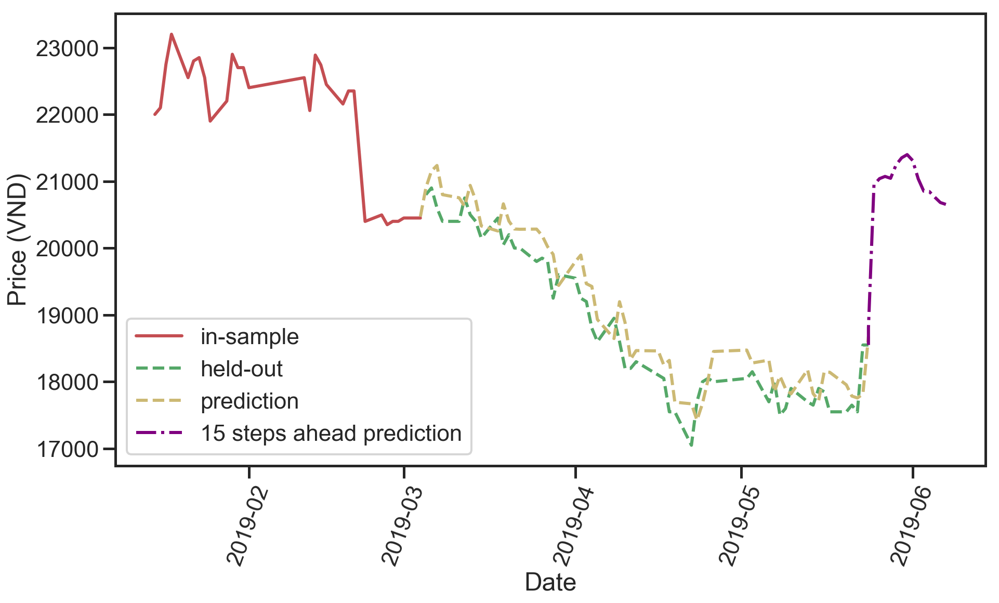

(2, 7, 3)
Testing result: {'mse': 214169.9912456818, 'rmse': 462.78503783687927, 'mae': 398.81923744688, 'mape': 2.132960282689276, 'lags': 2, 'hidden layers': (7, 3)}


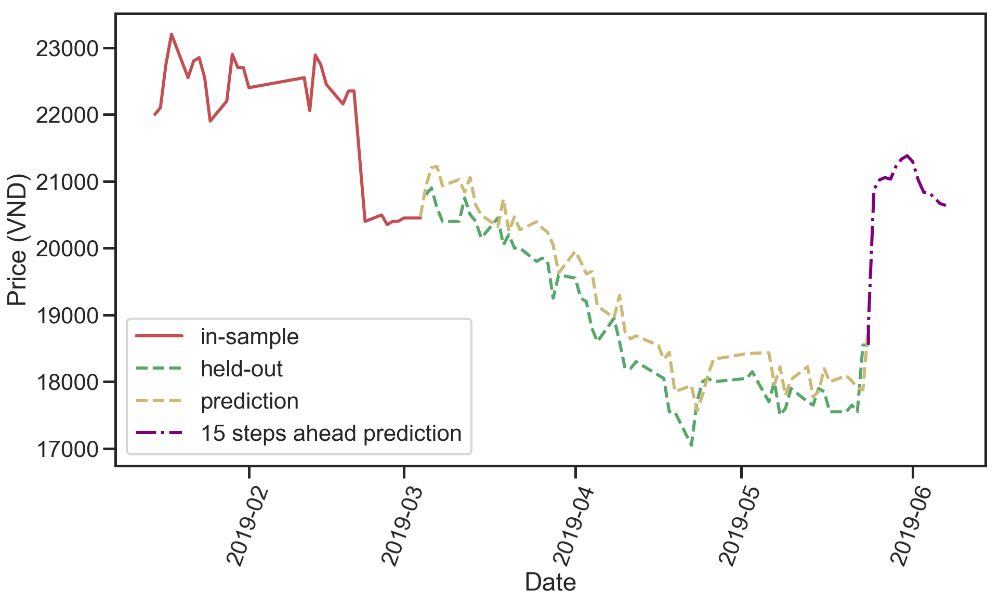

(2, 7, 3)
Testing result: {'mse': 214169.9912456818, 'rmse': 462.78503783687927, 'mae': 398.81923744688, 'mape': 2.132960282689276, 'lags': 2, 'hidden layers': (7, 3)}


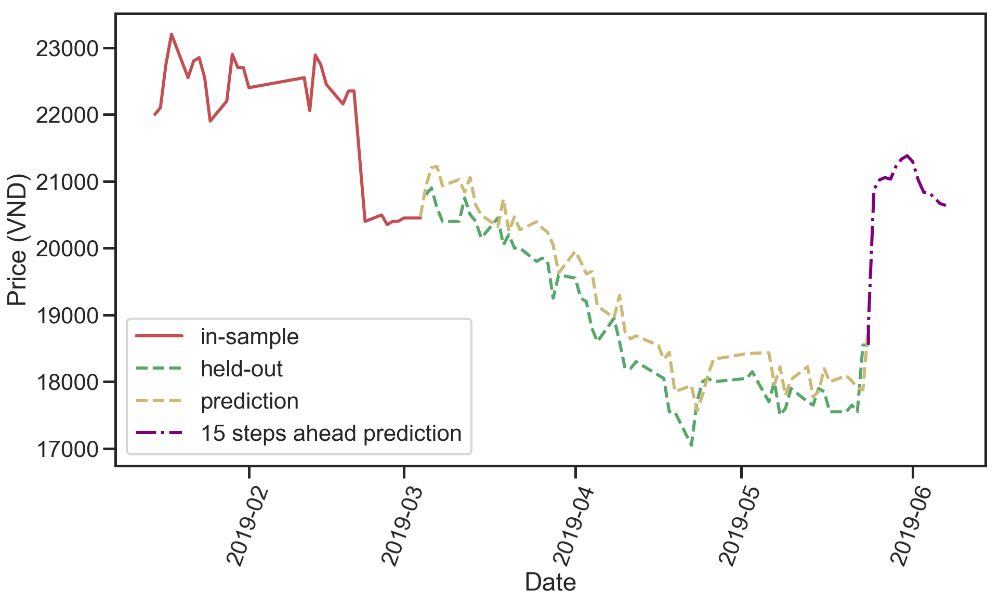

(3, 3, 1)
Testing result: {'mse': 291936.4023617106, 'rmse': 540.311393884777, 'mae': 478.52811764524284, 'mape': 2.55553183818788, 'lags': 3, 'hidden layers': (3, 1)}


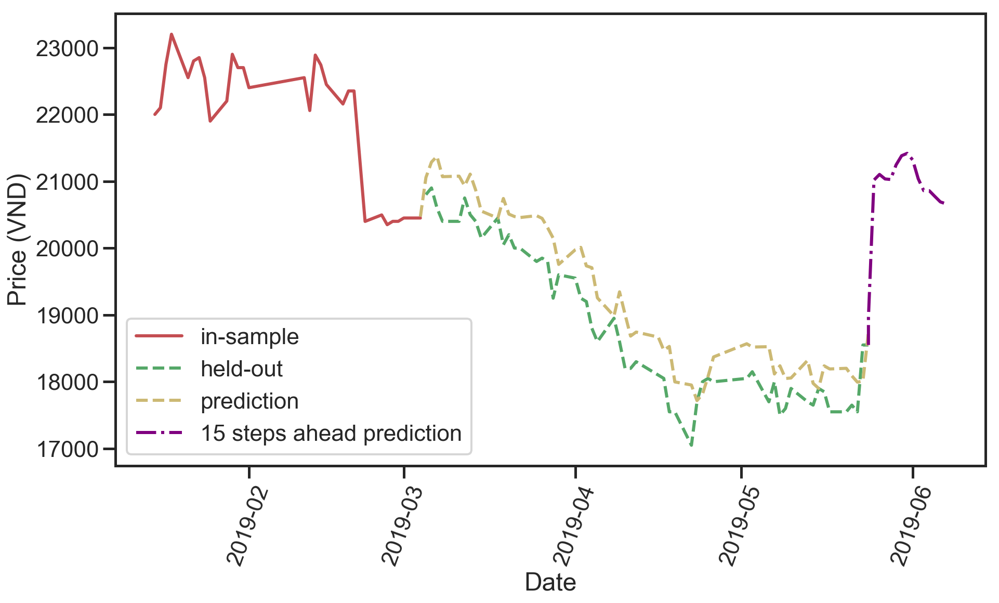

(3, 3, 2)
Testing result: {'mse': 97737.0158840772, 'rmse': 312.6291987068342, 'mae': 244.78732302697654, 'mape': 1.3134074949227088, 'lags': 3, 'hidden layers': (3, 2)}


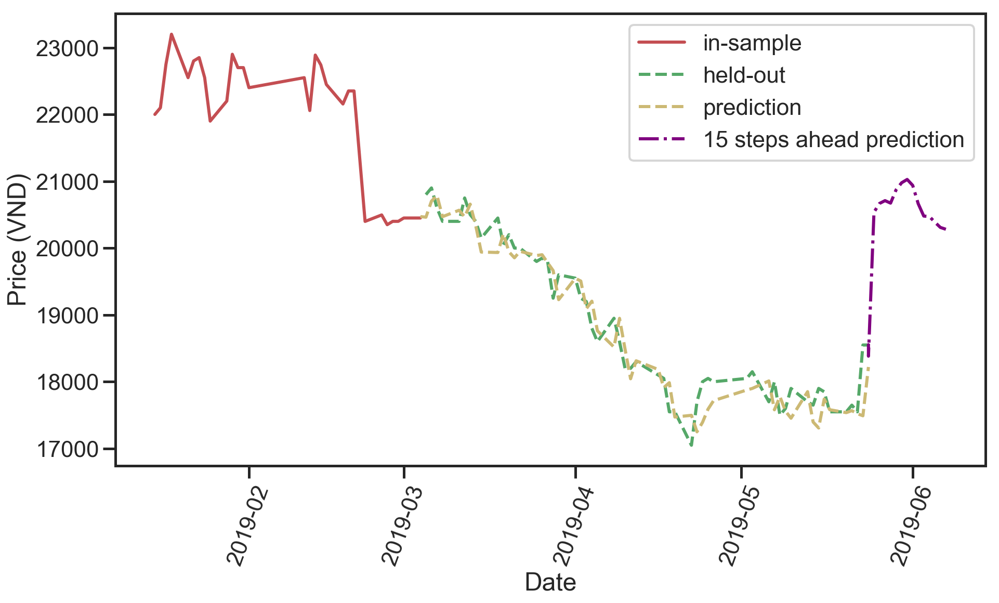

(3, 3, 2)
Testing result: {'mse': 97737.0158840772, 'rmse': 312.6291987068342, 'mae': 244.78732302697654, 'mape': 1.3134074949227088, 'lags': 3, 'hidden layers': (3, 2)}


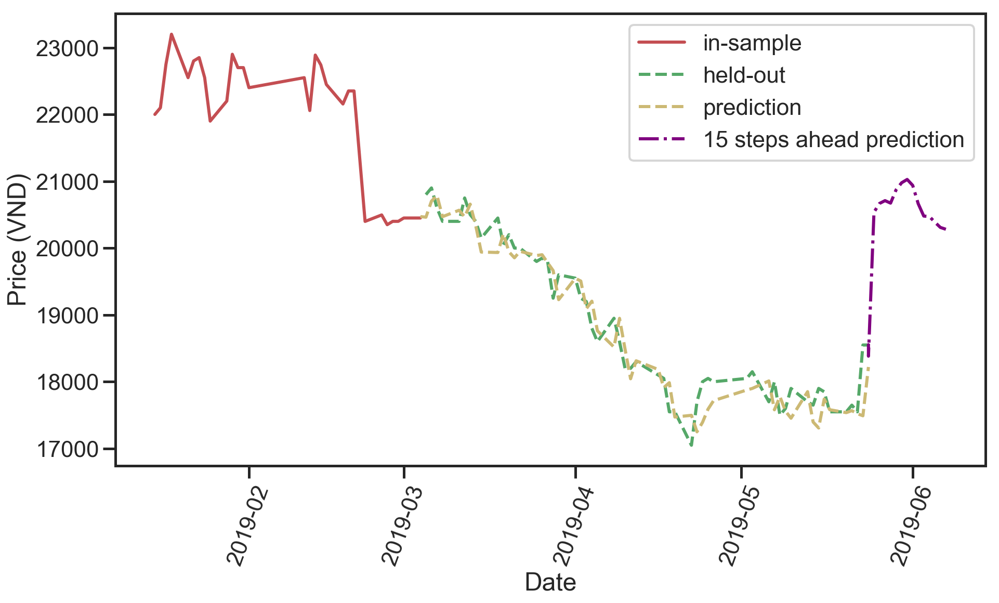

(3, 3, 3)
Testing result: {'mse': 140999.4111622293, 'rmse': 375.49888303725925, 'mae': 306.7867804048079, 'mape': 1.6416509744317784, 'lags': 3, 'hidden layers': (3, 3)}


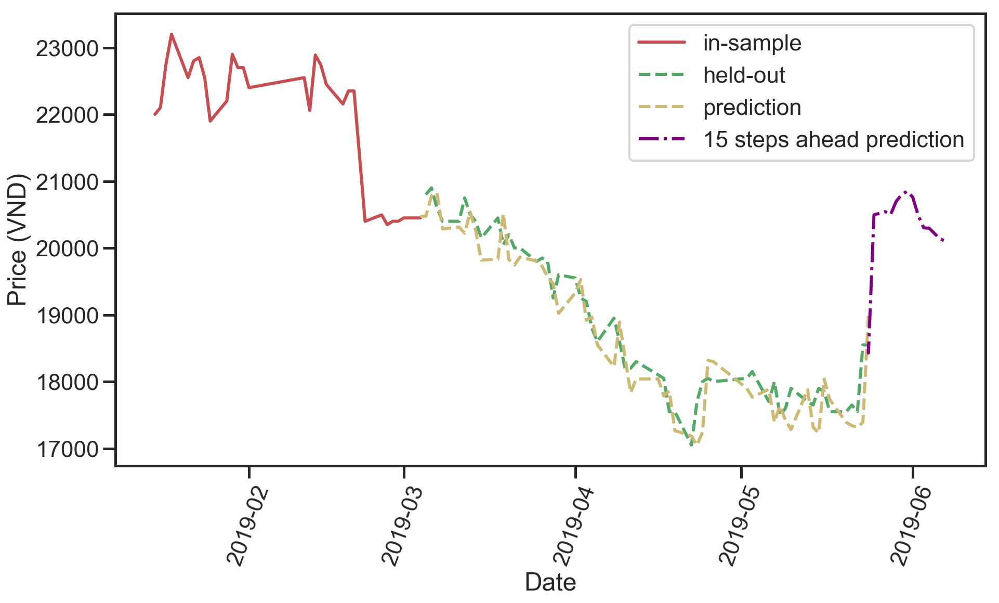

(3, 3, 3)
Testing result: {'mse': 140999.4111622293, 'rmse': 375.49888303725925, 'mae': 306.7867804048079, 'mape': 1.6416509744317784, 'lags': 3, 'hidden layers': (3, 3)}


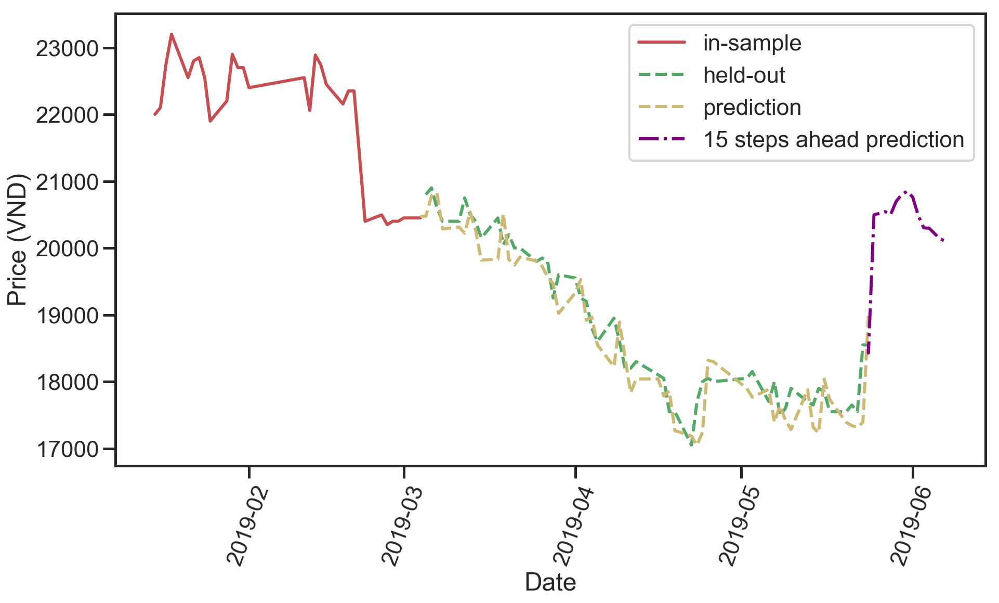

(3, 4, 1)
Testing result: {'mse': 152731.48638713834, 'rmse': 390.80875935313725, 'mae': 323.77976316184663, 'mape': 1.7365247561694548, 'lags': 3, 'hidden layers': (4, 1)}


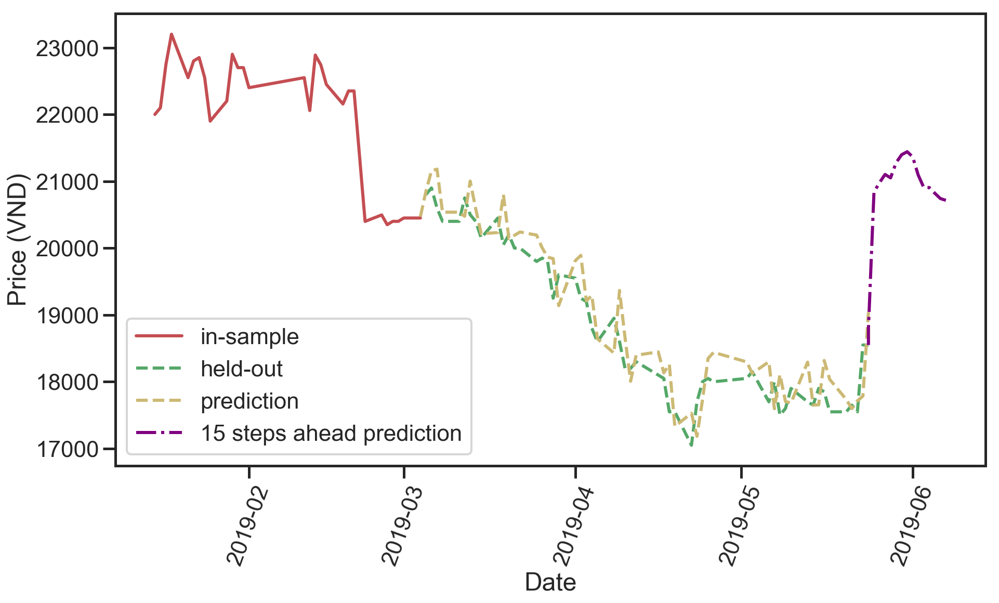

(3, 4, 2)
Testing result: {'mse': 209791.14791704944, 'rmse': 458.0296365051605, 'mae': 365.2673402150916, 'mape': 1.957642481309759, 'lags': 3, 'hidden layers': (4, 2)}


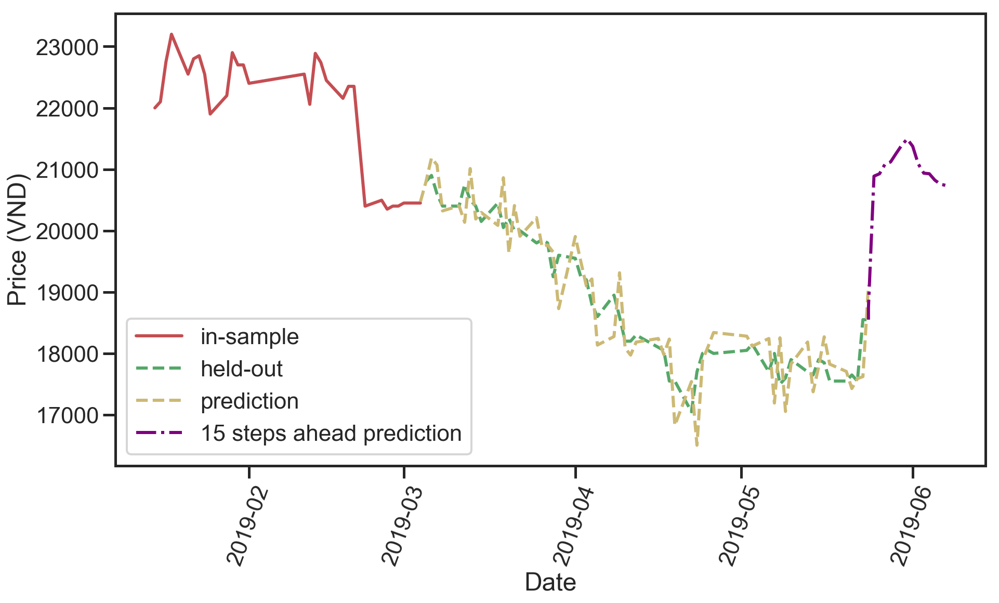

(3, 4, 2)
Testing result: {'mse': 209791.14791704944, 'rmse': 458.0296365051605, 'mae': 365.2673402150916, 'mape': 1.957642481309759, 'lags': 3, 'hidden layers': (4, 2)}


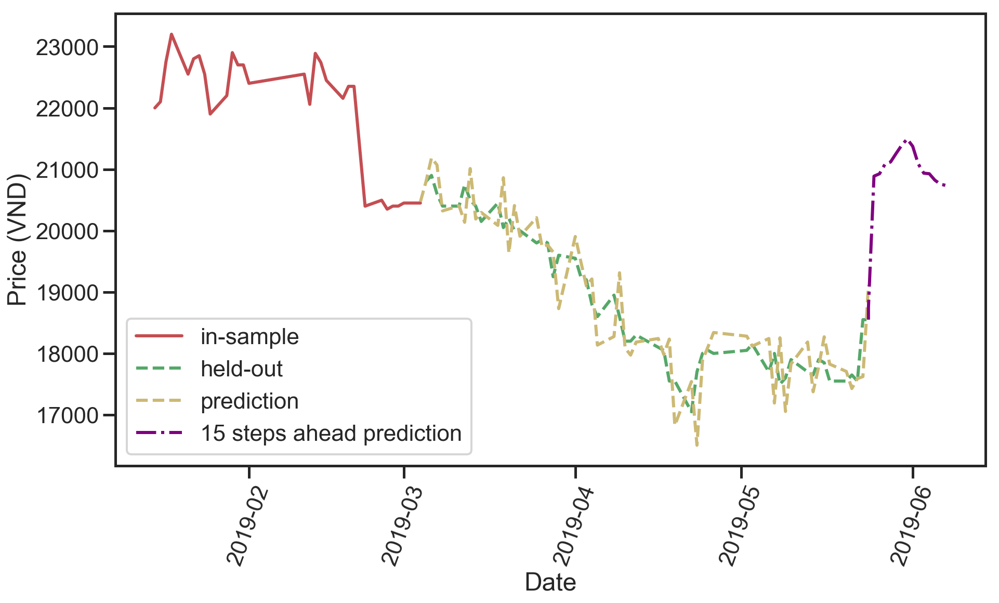

(3, 4, 3)
Testing result: {'mse': 383339.5492935039, 'rmse': 619.1442071872302, 'mae': 555.5554532752848, 'mape': 2.966836469981939, 'lags': 3, 'hidden layers': (4, 3)}


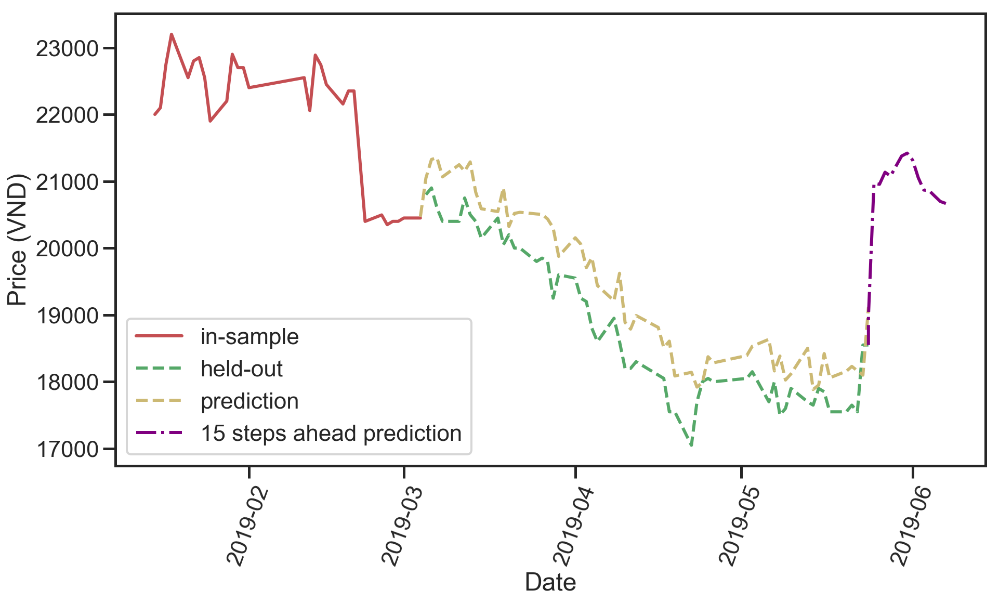

(3, 4, 3)
Testing result: {'mse': 383339.5492935039, 'rmse': 619.1442071872302, 'mae': 555.5554532752848, 'mape': 2.966836469981939, 'lags': 3, 'hidden layers': (4, 3)}


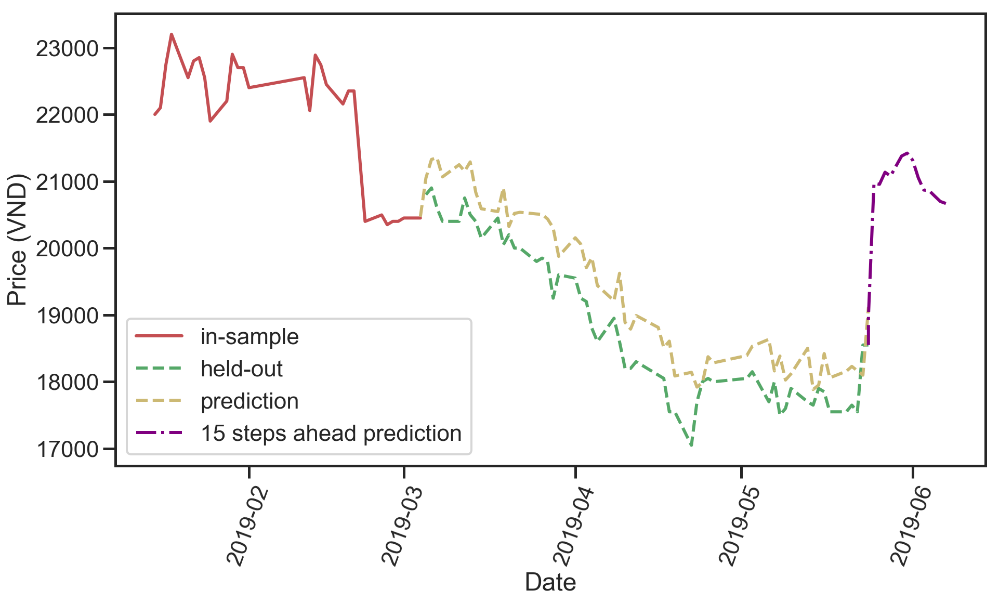

(3, 5, 1)
Testing result: {'mse': 460156.60337448254, 'rmse': 678.3484380275984, 'mae': 565.0655136965108, 'mape': 3.014350355998915, 'lags': 3, 'hidden layers': (5, 1)}


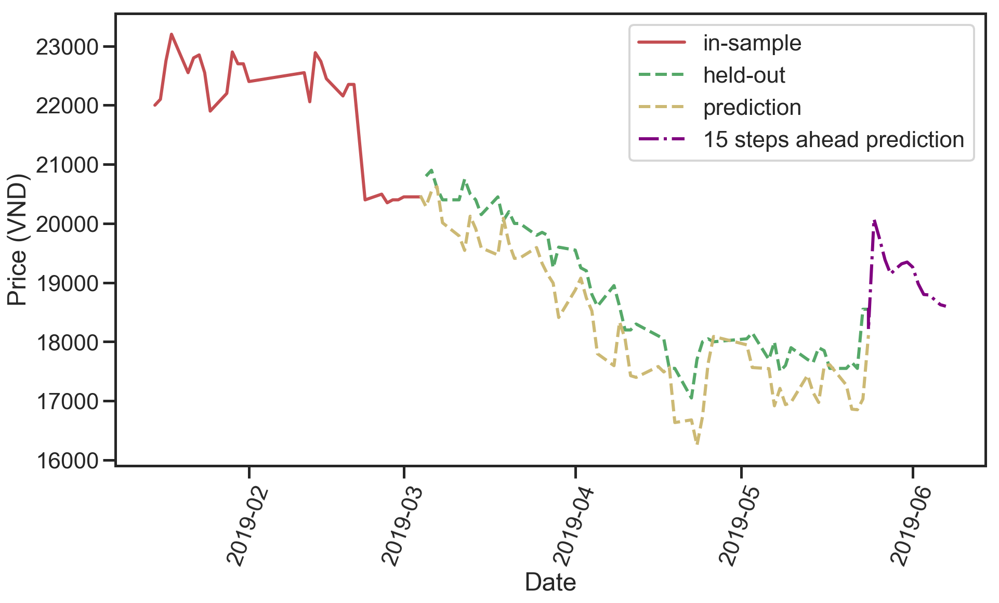

(3, 5, 2)
Testing result: {'mse': 256300.8935251813, 'rmse': 506.26168482829246, 'mae': 434.7227067033632, 'mape': 2.321969041262125, 'lags': 3, 'hidden layers': (5, 2)}


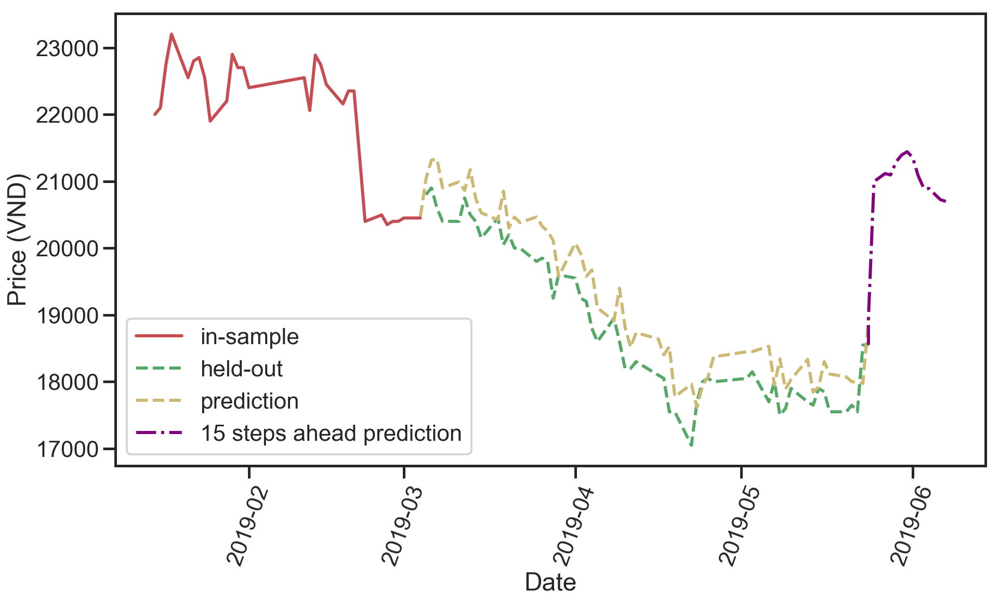

(3, 5, 2)
Testing result: {'mse': 256300.8935251813, 'rmse': 506.26168482829246, 'mae': 434.7227067033632, 'mape': 2.321969041262125, 'lags': 3, 'hidden layers': (5, 2)}


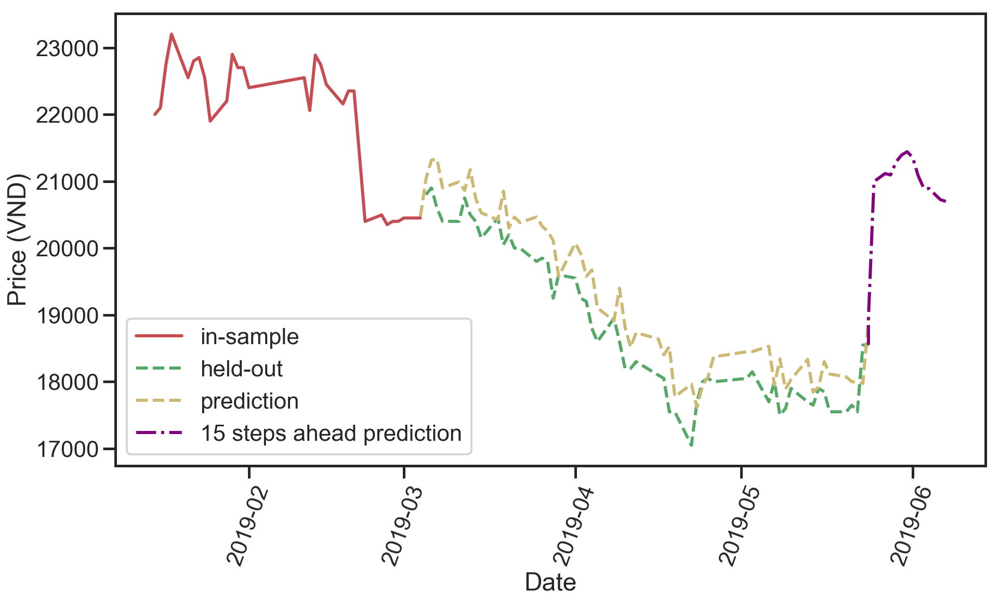

(3, 5, 3)
Testing result: {'mse': 587668.5113469667, 'rmse': 766.5954026388149, 'mae': 694.4174915585543, 'mape': 3.70824660389912, 'lags': 3, 'hidden layers': (5, 3)}


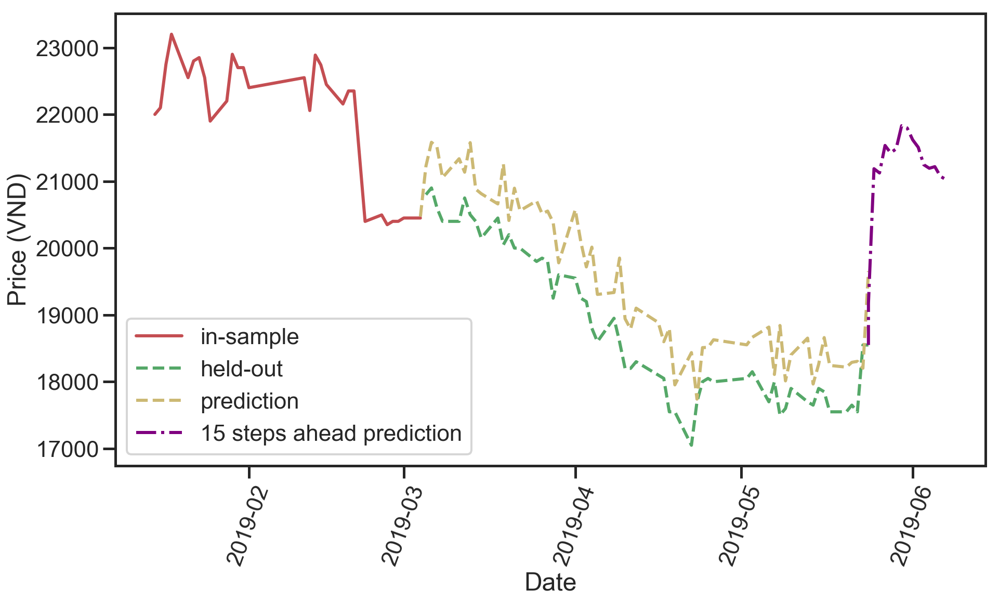

(3, 5, 3)
Testing result: {'mse': 587668.5113469667, 'rmse': 766.5954026388149, 'mae': 694.4174915585543, 'mape': 3.70824660389912, 'lags': 3, 'hidden layers': (5, 3)}


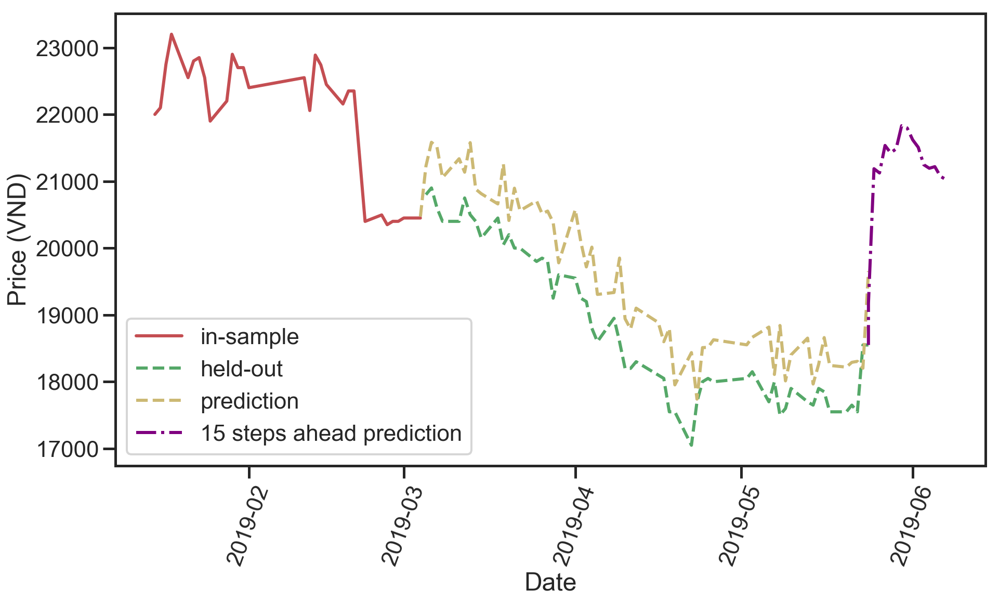

(3, 6, 1)
Testing result: {'mse': 2033285.3563837067, 'rmse': 1425.9331528454293, 'mae': 1395.211990935531, 'mape': 7.442326076793202, 'lags': 3, 'hidden layers': (6, 1)}


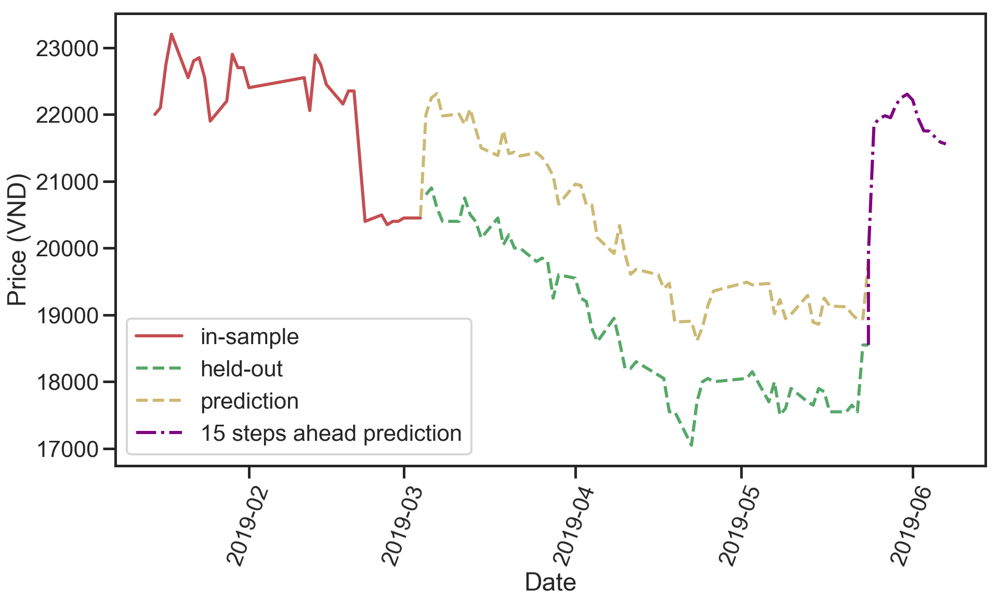

(3, 6, 2)
Testing result: {'mse': 1072075.8155554314, 'rmse': 1035.410940426762, 'mae': 982.6064975169047, 'mape': 5.241769105286501, 'lags': 3, 'hidden layers': (6, 2)}


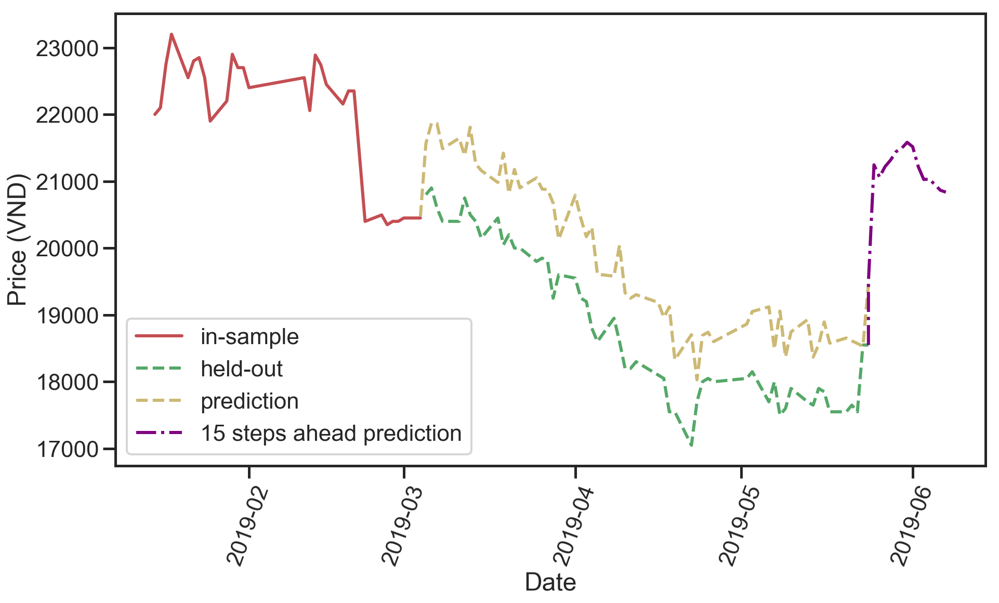

(3, 6, 2)
Testing result: {'mse': 1072075.8155554314, 'rmse': 1035.410940426762, 'mae': 982.6064975169047, 'mape': 5.241769105286501, 'lags': 3, 'hidden layers': (6, 2)}


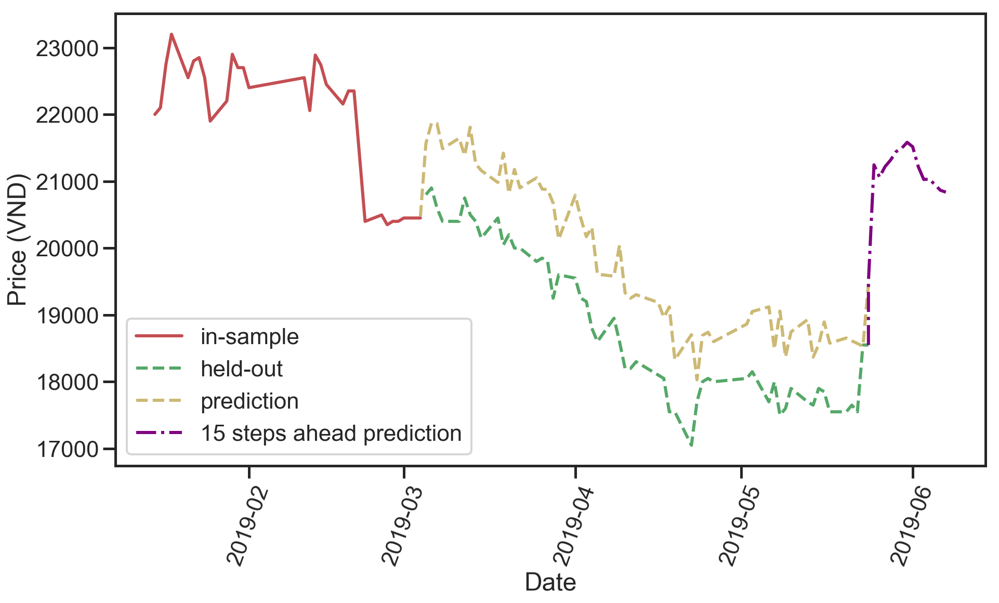

(3, 6, 3)
Testing result: {'mse': 298219.6085755948, 'rmse': 546.0948714056879, 'mae': 483.44651250380656, 'mape': 2.583257722023561, 'lags': 3, 'hidden layers': (6, 3)}


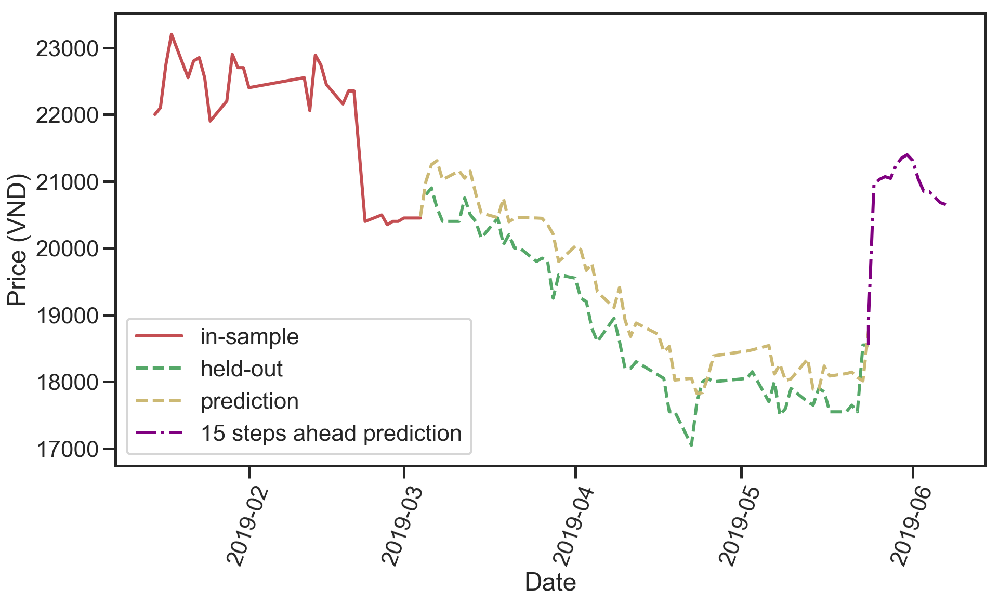

(3, 6, 3)
Testing result: {'mse': 298219.6085755948, 'rmse': 546.0948714056879, 'mae': 483.44651250380656, 'mape': 2.583257722023561, 'lags': 3, 'hidden layers': (6, 3)}


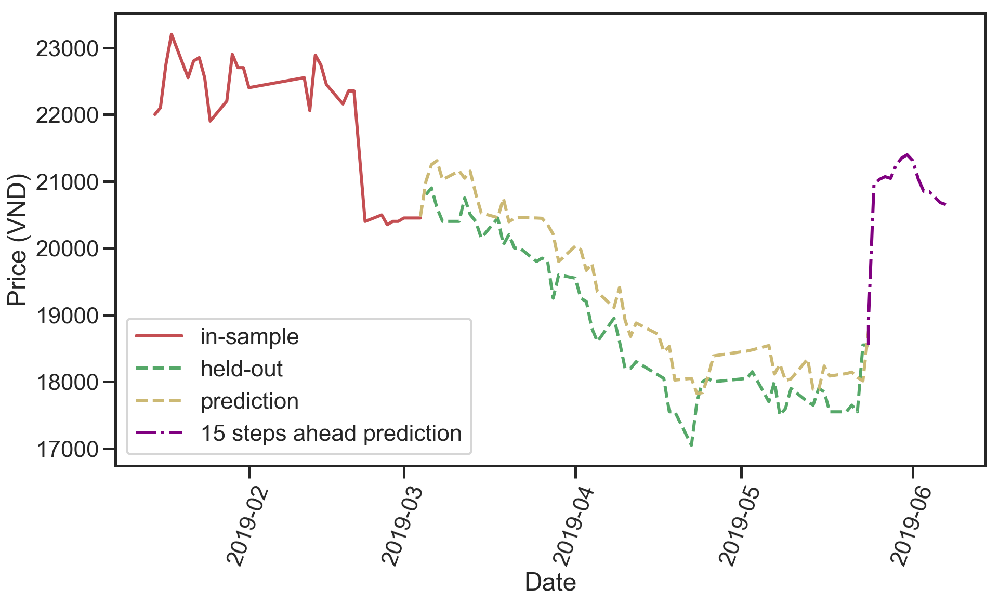

(3, 7, 1)
Testing result: {'mse': 280136.1271874026, 'rmse': 529.2788746846057, 'mae': 468.0265469556891, 'mape': 2.5010454500599746, 'lags': 3, 'hidden layers': (7, 1)}


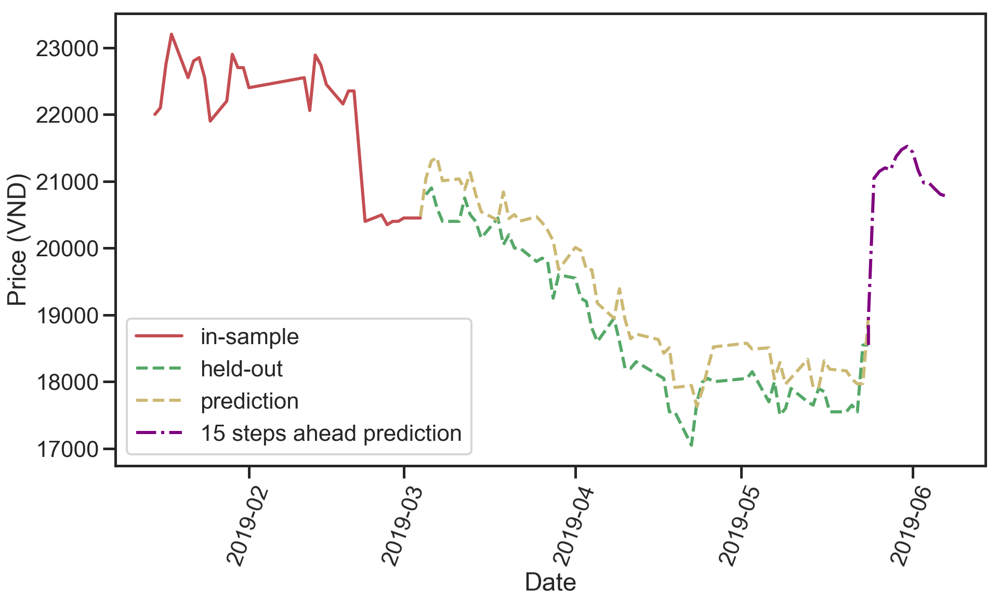

(3, 7, 2)
Testing result: {'mse': 269081.5237185305, 'rmse': 518.7306851522575, 'mae': 441.91749637348266, 'mape': 2.361664470207696, 'lags': 3, 'hidden layers': (7, 2)}


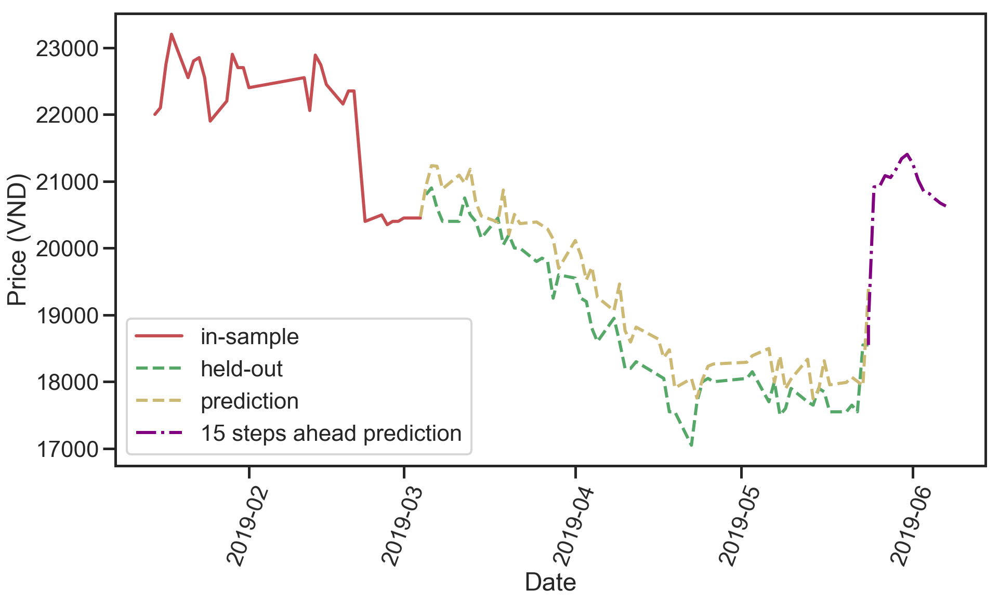

(3, 7, 2)
Testing result: {'mse': 269081.5237185305, 'rmse': 518.7306851522575, 'mae': 441.91749637348266, 'mape': 2.361664470207696, 'lags': 3, 'hidden layers': (7, 2)}


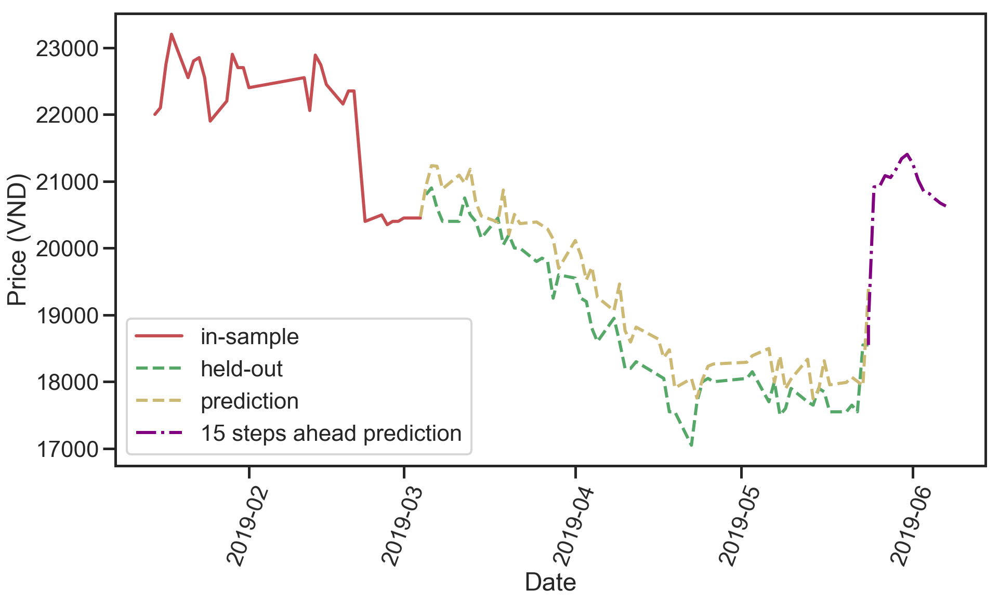

(3, 7, 3)
Testing result: {'mse': 162815.73467285273, 'rmse': 403.5043180349533, 'mae': 345.52384793996197, 'mape': 1.847674552576842, 'lags': 3, 'hidden layers': (7, 3)}


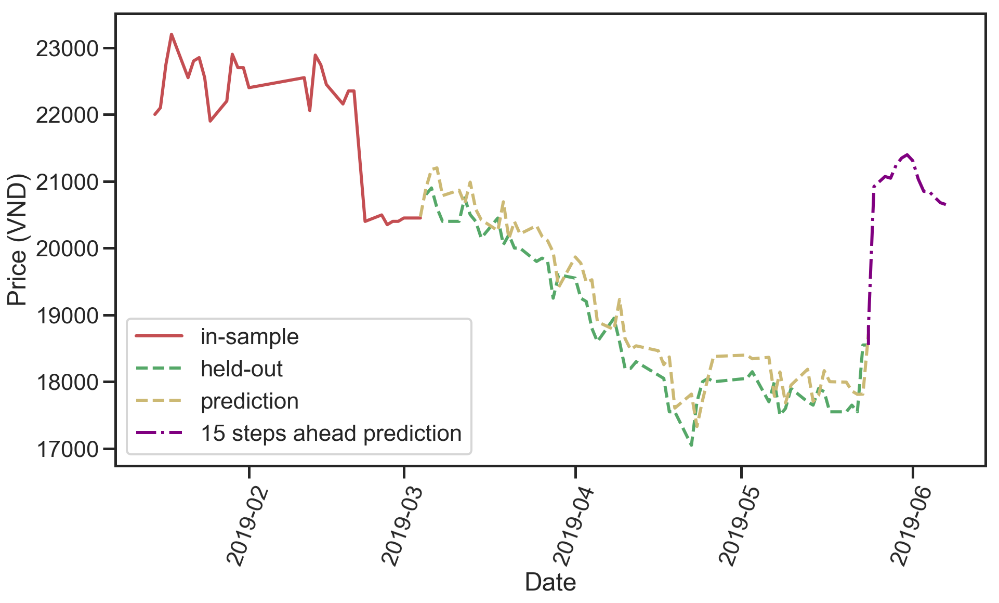

(3, 7, 3)
Testing result: {'mse': 162815.73467285273, 'rmse': 403.5043180349533, 'mae': 345.52384793996197, 'mape': 1.847674552576842, 'lags': 3, 'hidden layers': (7, 3)}


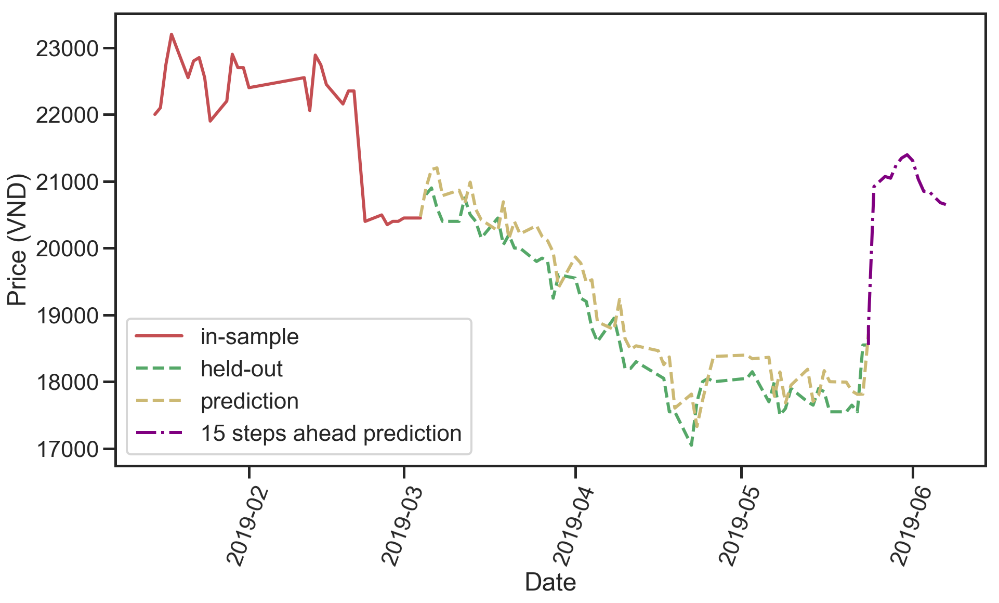

In [40]:
lags = range(1,4)
hl = range(3,8)
lst_ann_param = gen_ann(lags, hl)
order = (16,1,0)
lst_result = []
print(ticket)
for ann_param in lst_ann_param:
    print(ann_param)
    result = run_model_with_parameters(train, test, model_selection='Hybrid', order=order,
                                       lag=ann_param[0], hidden_layers=ann_param[1:])
    time.sleep(1)
    if result['status']:
        _result = result['test_evaluation']
        _result['lags'] = ann_param[0]
        _result['hidden layers'] = ann_param[1:]
        lst_result.append(_result)
        print('Testing result:', result['test_evaluation'])
        validation = result['model'].validate(test)
        predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
        fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
        ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
        ax1.plot(test, label='held-out', color='g', linestyle='--')
        ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
        ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
        plt.xticks(rotation=70)
        plt.ylabel('Price (VND)')
        plt.xlabel('Date')
        plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
#         plt.title('Model evaluation of ' + ticket)
        plt.show()
    else:
        print('None')

In [41]:
df_result = pd.DataFrame(data=lst_result)
df_result = df_result.drop_duplicates(['lags','hidden layers'], keep='first')
df_result = df_result.set_index(['lags', 'hidden layers'])
lst_metric = ['mae','mape','mse','rmse']
df_result = df_result[lst_metric].round(3)
df_result.to_csv('pnj_hybrid_result.csv', index=True)
df_result

mae    mape           mse       rmse
lags hidden layers                                            
1    (3, 1)         421.91400 2.25600  230738.90500  480.35300
     (3, 2)         434.07900 2.32000  238495.27900  488.36000
     (3, 3)         374.45200 2.00300  194311.40100  440.80800
     (4, 1)         792.82700 4.22600  726591.05400  852.40300
     (4, 2)         412.97500 2.20800  220198.76200  469.25300
     (4, 3)         308.55500 1.65400  144569.37900  380.22300
     (5, 1)         432.04500 2.30900  239440.54100  489.32700
     (5, 2)         411.80500 2.20200  217963.90300  466.86600
     (5, 3)         430.30000 2.30000  238387.15000  488.24900
     (6, 1)         757.34400 4.04300  658783.56800  811.65500
     (6, 2)         387.67800 2.07500  229079.53100  478.62300
     (6, 3)         324.87300 1.73900  145651.72300  381.64300
     (7, 1)         402.70500 2.15300  210516.56500  458.82100
     (7, 2)        1180.81000 6.29600 1528591.43900 1236.36200
     (7, 3)         373.77500 2.00000  185084.35100  430.21400
2    (3, 1)        1076.87000 5.74200 1252253.94100 1119.04200
     (3, 2)         327.39200 1.75500  156824.70700  396.01100
     (3, 3)         513.84600 2.74600  325691.04100  570.69300
     (4, 1)         396.09800 2.11200  244892.32300  494.86600
     (4, 2)         814.92700 4.35000  770143.04200  877.57800
     (4, 3)         824.35000 4.39600  779640.67000  882.97300
     (5, 1)         375.20500 2.00700  194875.91500  441.44800
     (5, 2)         445.55400 2.38200  263431.42000  513.25600
     (5, 3)         391.50200 2.09400  201492.27800  448.87900
     (6, 1)         325.14500 1.74200  141483.28300  376.14300
     (6, 2)         339.70200 1.81700  171805.86200  414.49500
     (6, 3)         351.58000 1.88200  162028.91100  402.52800
     (7, 1)        1069.13400 5.69700 1318908.71300 1148.43800
     (7, 2)         346.06900 1.85100  158112.99000  397.63400
     (7, 3)         398.81900 2.13300  214169.99100  462.78500
3    (3, 1)         478.52800 2.55600  291936.40200  540.31100
     (3, 2)         244.78700 1.31300   97737.01600  312.62900
     (3, 3)         306.78700 1.64200  140999.41100  375.49900
     (4, 1)         323.78000 1.73700  152731.48600  390.80900
     (4, 2)         365.26700 1.95800  209791.14800  458.03000
     (4, 3)         555.55500 2.96700  383339.54900  619.14400
     (5, 1)         565.06600 3.01400  460156.60300  678.34800
     (5, 2)         434.72300 2.32200  256300.89400  506.26200
     (5, 3)         694.41700 3.70800  587668.51100  766.59500
     (6, 1)        1395.21200 7.44200 2033285.35600 1425.93300
     (6, 2)         982.60600 5.24200 1072075.81600 1035.41100
     (6, 3)         483.44700 2.58300  298219.60900  546.09500
     (7, 1)         468.02700 2.50100  280136.12700  529.27900
     (7, 2)         441.91700 2.36200  269081.52400  518.73100
     (7, 3)         345.52400 1.84800  162815.73500  403.50400

## GBM

Testing result: {'mse': 137241.59185624696, 'rmse': 370.4613230233987, 'mae': 290.62059253377174, 'mape': 1.5491869124486275}


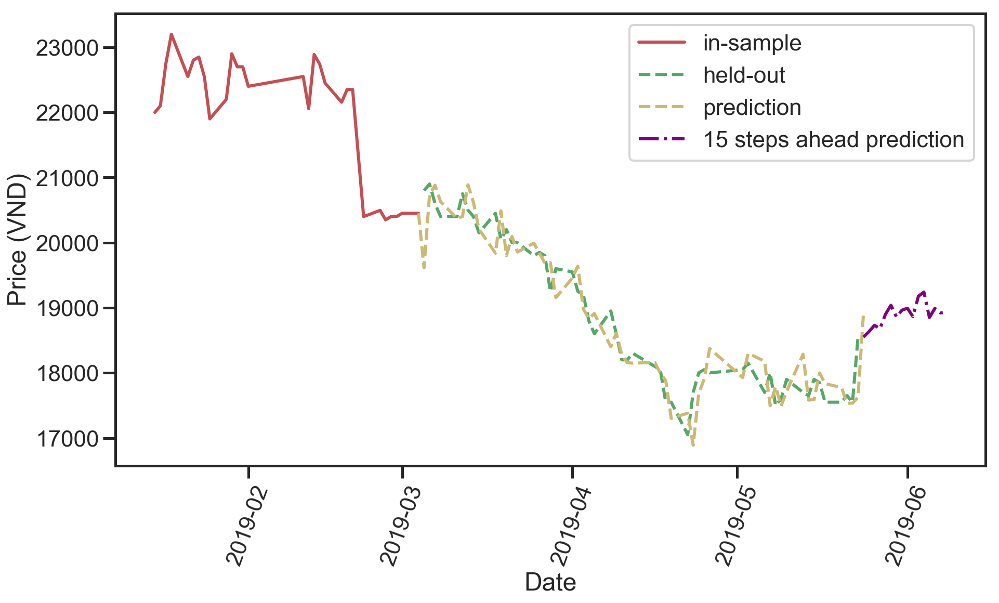

In [42]:
def run_gbm(train, test, window_size):
    result = {}
    gbm = GBM(train, window_size=10)
    prediction = gbm.validate(test)

    df_validation = pd.DataFrame()
    df_validation['y'] = test
    df_validation['yhat'] = prediction

    result_test = evaluation(df_validation)
    prediction = gbm.predict_multi_step_ahead(start=test.index[-1], steps=10)
    result['model_name'] = 'GBM'
    result['model'] = gbm
    result['status'] = True
    result['test_evaluation'] = result_test
    return result

result = run_gbm(train, test, window_size=10)
#     print(ticket, ':', result['lag'], result['hidden_layers'])
#     print('Training result:', result['train_evaluation'])
print('Testing result:', result['test_evaluation'])
# lst_gbm.append({
#     'name': ticket,
# #         'order': result['order'],
# #         'lags': result['lag'],
# #         'hidden_layers': result['hidden_layers'],
#     'result': result['test_evaluation']
# })
validation = result['model'].validate(test)
predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
ax1.plot(test, label='held-out', color='g', linestyle='--')
ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
plt.xticks(rotation=70)
plt.ylabel('Price (VND)')
plt.xlabel('Date')
plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
#     plt.title('Model evaluation of ' + ticket)
plt.show()

## LSTM+GBM

Run model LSTM
Training drift...
Done.
Training volatility...
Done.
DPM
Testing result: {'mse': 93308.995104188, 'rmse': 305.4652109556635, 'mae': 231.73595776305282, 'mape': 1.23548609054934}


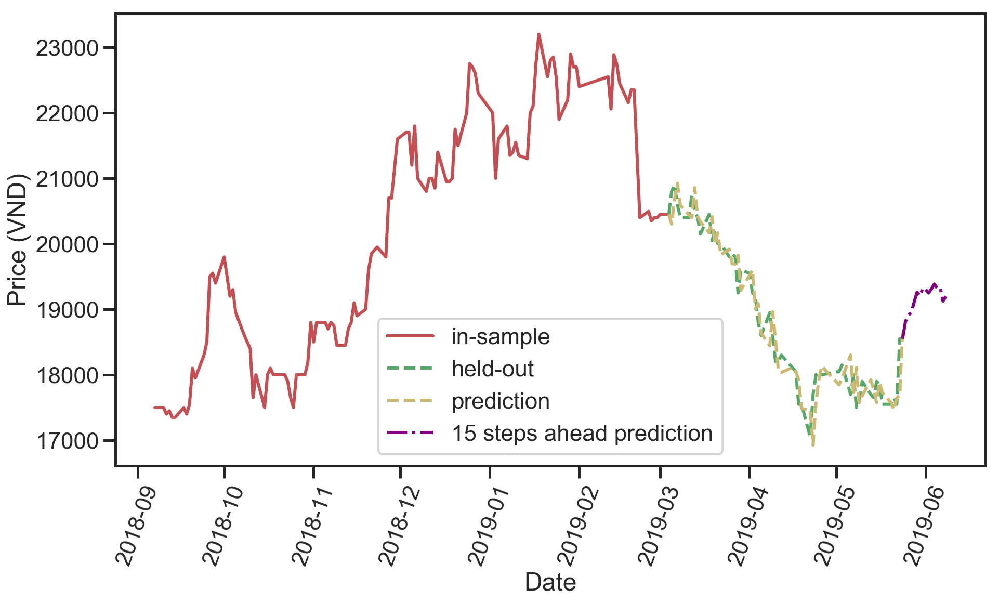

In [43]:
result = run_model_with_parameters(train, test, model_selection='LSTM_GBM', window_size=10, lag=10)
print(ticket)
validation = result['model'].validate(test)
insample_prediction = result['model'].get_insample_prediction()
predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
time.sleep(1)

df_drift = result['drift_validation']
df_volatility = result['volatility_validation']

# print('Training result:', result['train_evaluation'])
print('Testing result:', result['test_evaluation'])

fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
ax1.plot(train[-120:], label='in-sample', color='r', linestyle='-')
ax1.plot(train[-1:].append(test), label='held-out', color='g', linestyle='--')
ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
plt.xticks(rotation=70)
plt.ylabel('Price (VND)')
plt.xlabel('Date')
plt.legend(['in-sample','held-out', 'prediction','15 steps ahead prediction'])
# plt.title('Model evaluation of ' + ticket)
plt.show()

{'mse': 7.475993158191708e-06, 'rmse': 0.0027342262448802053, 'mae': 0.0021606907412764246, 'mape': 271.8814028477534}


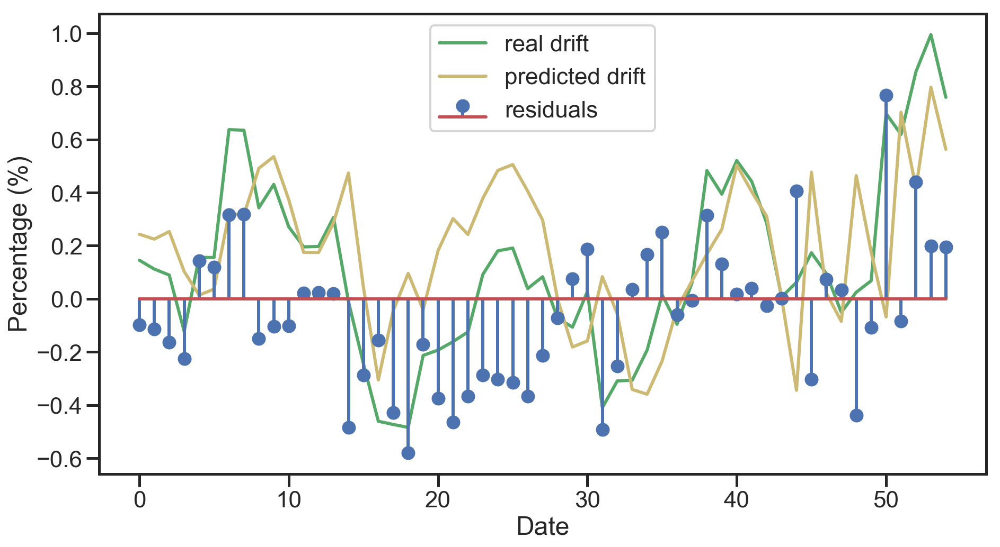

In [33]:
result_drift = evaluation(df_drift)
print(result_drift)
plt.figure(figsize=(15, 8))
plt.plot(df_drift['y'] * 100, color='g')
plt.plot(df_drift['yhat'] * 100, color='y')
plt.stem((df_drift['y'] - df_drift['yhat'])*100)
plt.legend(['real drift', 'predicted drift', 'residuals'])
# plt.title('Drift evaluation')
plt.xlabel('Date')
plt.ylabel('Percentage (%)')
plt.show()

{'mse': 5.942884986004978e-06, 'rmse': 0.002437803311591191, 'mae': 0.0016377985540514811, 'mape': 12.561029485464974}


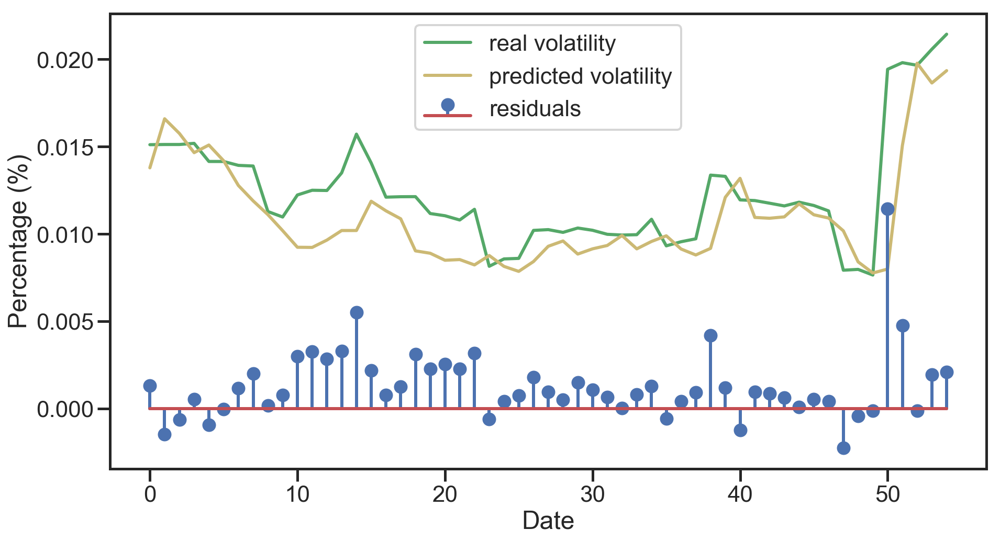

In [34]:
result_volatility = evaluation(df_volatility)
print(result_volatility)
plt.figure(figsize=(15, 8))
plt.plot(df_volatility['y'], color='g')
plt.plot(df_volatility['yhat'], color='y')
plt.stem(df_volatility['y'] - df_volatility['yhat'])
plt.legend(['real volatility', 'predicted volatility', 'residuals'])
# plt.title('Volatility evaluation')
plt.xlabel('Date')
plt.ylabel('Percentage (%)')
plt.show()